# DATA EXPLORATION

The goal of this notebook is to explore how different models improve their predictions using non-demand and non-supply candles. Both regression and classification models will be used to this investigation.

### Libraries

In [1]:
# Data Manipulation and Analysis
import pandas as pd
import numpy as np

# Visualization
import matplotlib.pyplot as plt
import mplfinance as mpf
import seaborn as sns

# Machine Learning Models
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

# Metrics and Evaluation
from sklearn.metrics import (
    mean_squared_error, mean_absolute_error, explained_variance_score, r2_score,
    mean_poisson_deviance, mean_gamma_deviance, accuracy_score
)

# File Handling
import os

# Math
import math

# Time series models
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf
from tensorflow.keras.regularizers import l2

# Statistics
from scipy.stats import f_oneway

# Neural Network
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Bidirectional, Conv1D, MaxPooling1D, Flatten, Dropout

# Classification Models
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier

2024-06-20 18:49:43.296580: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-06-20 18:49:43.468524: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-20 18:49:43.468580: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-20 18:49:43.469729: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-06-20 18:49:43.589611: I tensorflow/core/platform/cpu_feature_g

### Dataset Class

I create a Dataset class to group every function I need to work with my datasets.

In [2]:
class Dataset(object):
    def __init__(self, dataset, name, is_copy=False):
        if not isinstance(dataset, pd.DataFrame):
            raise ValueError("Input 'dataset' must be a pandas DataFrame.")
        
        self.dataset = dataset.copy()

        self.name = name
        
        if not is_copy:
            self.dataset['Date'] = pd.to_datetime(self.dataset['Date'])
            self.dataset.set_index('Date', inplace=True)        
        
    def __str__(self):
        return self.name
    
    def reset_train_test(self, train_ratio=0.7):
        if 0 < train_ratio < 1:
            training_size = int(len(self.dataset) * train_ratio)

            self.train = self.dataset.iloc[:training_size]
            self.test = self.dataset.iloc[training_size:]

            print("Train ratio: {}".format(train_ratio))
            print("Test ratio: {}".format(1-train_ratio))
        
        else:
            print("Please, train ratio between 0 and 1")
            
    def split_data(self, feature_columns, target_column, train_ratio=0.7):
        training_size = int(len(self.dataset) * train_ratio)
        self.train = self.dataset.iloc[:training_size]
        self.test = self.dataset.iloc[training_size:]
        X_train = self.train[feature_columns]
        Y_train = self.train[target_column]

        X_test = self.test[feature_columns]
        Y_test = self.test[target_column]

        return X_train, Y_train, X_test, Y_test
    
    def plot_candle(self):
        mpf.plot(self.dataset, type='ohlc', volume=True, style='yahoo', figsize=(10,6))
    
    def plot_heatmap(self):    
        plt.figure(figsize=(10,5))

        correlation = self.dataset.corr()
        sns.heatmap(correlation, annot=True)

        plt.show()
        
    def show_nulls(self):
        return self.dataset.isna().sum()
    
    def copy(self):
        return Dataset(self.dataset.copy(), self.name, True)

### Model Class

This class will make easier the use of different models and their further functions.

In [3]:
class Model(object):
    def __init__(self, model):
        self.model = model  
        
    def fit(self):
        return self.model.fit()
    
    def predict(self, Dataset, feature_columns, target_column):
        X_train, y_train, X_test, y_test = Dataset.split_data(feature_columns, target_column)

        # Initialize the Random Forest Regressor model
        my_model = self.model
        my_model.fit(X_train, y_train)

        test_predict = my_model.predict(X_test)
        
        mae = mean_absolute_error(y_test, test_predict)
        rmse = math.sqrt(mean_squared_error(y_test, test_predict))

        print("-"*100)
        print("Mean Absolute Error - MAE : " + str(mae))
        print("Root Mean squared Error - RMSE : " + str(rmse))
        print("-"*100)

        test_predict = test_predict.reshape(-1,1)

        return test_predict, mae, rmse
    
    def print_accuracy(self, Dataset, predicted_values):
        mae = mean_absolute_error(Dataset.test['close'].values, predicted_values)

        percentage_accuracy = 100 - (mae / Dataset.test.values.mean()) * 100
        
        print("The accuracy of the model is {}%".format(percentage_accuracy))
    
    def plot_predictions(self, Dataset, test_predict, model_name, new_feature=None):
        test_predict = test_predict.reshape(-1,1)
        train_shape = Dataset.train.shape[0]

        # Your original code for plotting the black and red lines
        fig, ax = plt.subplots(figsize=(15, 6))
        sns.lineplot(x=Dataset.dataset.index[:train_shape+1], 
                     y=Dataset.dataset['Close'][:train_shape+1], color='black')
        sns.lineplot(x=Dataset.dataset.index[train_shape:], y=Dataset.dataset['Close'][train_shape:], color='red')

        # Plot the test data on top of the red line
        sns.lineplot(x=Dataset.dataset.index[train_shape:], y=test_predict[:, 0], color='blue')

        # Formatting
        ax.set_title(f'{Dataset.name} Value Evolution {model_name}', 
                     fontsize=20, loc='center', fontdict=dict(weight='bold'))
        ax.set_xlabel('Date', fontsize=16, fontdict=dict(weight='bold'))
        ax.set_ylabel('Daily Sales', fontsize=16, fontdict=dict(weight='bold'))
        plt.tick_params(axis='y', which='major', labelsize=16)
        plt.tick_params(axis='x', which='major', labelsize=16)

        # Customize legend labels and colors
        plt.legend(loc='upper right', labels=['train', 'test', 'predicted test'], 
                   handles=[plt.Line2D([0], [0], color='black', label='train'),
                            plt.Line2D([0], [0], color='red', label='test'),
                            plt.Line2D([0], [0], color='blue', label='predicted test')], fontsize='large')
         
        # Ensure the directory exists
        directory = 'Informe/Imatges/Annex'
        if not os.path.exists(directory):
            os.makedirs(directory)

        # Build the filename
        filename = f"{Dataset.name}_{model_name}_{new_feature if new_feature else 'default'}.png"
        filepath = os.path.join(directory, filename)

        # Save the plot as a PNG image
        plt.savefig(filepath, bbox_inches='tight')

        # Show the plot
        plt.show()
        
    def compare_test_predictions(self, Dataset, test_predict, model_name, new_feature=None):
        test_predict = test_predict.reshape(-1,1)
        train_shape = Dataset.train.shape[0]

        # Your original code for plotting the black and red lines
        fig, ax = plt.subplots(figsize=(15, 6))
        sns.lineplot(x=Dataset.dataset.index[train_shape:], y=Dataset.dataset['Close'][train_shape:], color='red')

        # Plot the test data on top of the red line
        sns.lineplot(x=Dataset.dataset.index[train_shape:], y=test_predict[:, 0], color='blue')

        # Formatting
        ax.set_title(f'{Dataset.name} Difference between Test and Predictions', 
                     fontsize=20, loc='center', fontdict=dict(weight='bold'))
        ax.set_xlabel('Date', fontsize=16, fontdict=dict(weight='bold'))
        ax.set_ylabel('Daily Sales', fontsize=16, fontdict=dict(weight='bold'))
        
        plt.tick_params(axis='y', which='major', labelsize=16)
        plt.tick_params(labelsize=16)

        # Customize legend labels and colors
        plt.legend(loc='upper right', labels=['test', 'predicted test'], 
                   handles=[plt.Line2D([0], [0], color='red', label='test'),
                            plt.Line2D([0], [0], color='blue', label='predicted test')], fontsize='large')

        # Ensure the directory exists
        directory = 'Informe/Imatges/Annex'
        if not os.path.exists(directory):
            os.makedirs(directory)

        # Build the filename
        filename = f"{Dataset.name}_Zoom_{model_name}_{new_feature if new_feature else 'default'}.png"
        filepath = os.path.join(directory, filename)

        # Save the plot as a PNG image
        plt.savefig(filepath, bbox_inches='tight')

        # Show the plot
        plt.show()   
        
    def calculate_metrics(self, X_test, y_test, predictions):
        mae = np.mean(np.abs(predictions - y_test))
        rmse = np.sqrt(np.mean((predictions - y_test) ** 2))
        
        return mae, rmse

### Download the data

In [4]:
AMAZON = Dataset(pd.read_csv('AMAZON/AMZN.csv'), 'Amazon')
APPLE = Dataset(pd.read_csv('APPLE/APLE.csv'), 'Apple')
NETFLIX = Dataset(pd.read_csv('NETFLIX/NFLX.csv'), 'Netflix')
SPX500 = Dataset(pd.read_csv('SPX500/SPX.csv'), 'SPX500')

### Analysing data

Let's have a look at the datasets:

In [5]:
AMAZON.dataset

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2023-03-06,95.190002,96.550003,93.739998,93.750000,93.750000,52112400
2023-03-07,94.059998,95.089996,92.779999,93.550003,93.550003,49100700
2023-03-08,93.599998,94.169998,92.180000,93.919998,93.919998,44899100
2023-03-09,93.680000,96.209999,92.180000,92.250000,92.250000,56218700
2023-03-10,92.669998,93.570000,90.250000,90.730003,90.730003,69827500
...,...,...,...,...,...,...
2024-02-28,172.440002,174.050003,172.270004,173.160004,173.160004,28180500
2024-02-29,173.009995,177.220001,172.850006,176.759995,176.759995,53805400
2024-03-01,176.750000,178.729996,176.070007,178.220001,178.220001,31956200


In [6]:
APPLE.dataset

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2023-01-03,15.970000,16.030001,15.380000,15.490000,14.375418,1335400
2023-01-04,15.720000,16.000000,15.630000,15.780000,14.644549,1394400
2023-01-05,15.740000,15.740000,15.330000,15.400000,14.291888,1378800
2023-01-06,15.450000,15.750000,15.450000,15.570000,14.449658,1232600
2023-01-09,15.540000,15.690000,15.520000,15.620000,14.496060,1308800
...,...,...,...,...,...,...
2024-02-28,15.810000,16.264999,15.790000,16.059999,16.059999,2470600
2024-02-29,16.209999,16.270000,15.980000,16.090000,16.090000,2854900
2024-03-01,16.180000,16.430000,16.110001,16.340000,16.340000,1889900


In [7]:
NETFLIX.dataset

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2023-01-03,298.059998,298.390015,288.700012,294.950012,294.950012,6764000
2023-01-04,298.239990,311.140015,295.510010,309.410004,309.410004,9345100
2023-01-05,307.000000,314.179993,304.549988,309.700012,309.700012,8328400
2023-01-06,311.570007,316.769989,303.690002,315.549988,315.549988,8959800
2023-01-09,316.829987,321.700012,313.220001,315.170013,315.170013,6766600
...,...,...,...,...,...,...
2024-02-28,595.789978,598.169983,590.010010,596.479980,596.479980,2605200
2024-02-29,604.250000,604.520020,595.159973,602.919983,602.919983,3572100
2024-03-01,599.809998,620.280029,599.500000,619.340027,619.340027,4264200


In [8]:
SPX500.dataset

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2023-01-03,3853.290039,3878.459961,3794.330078,3824.139893,3824.139893,3959140000
2023-01-04,3840.360107,3873.159912,3815.770020,3852.969971,3852.969971,4414080000
2023-01-05,3839.739990,3839.739990,3802.419922,3808.100098,3808.100098,3893450000
2023-01-06,3823.370117,3906.189941,3809.560059,3895.080078,3895.080078,3923560000
2023-01-09,3910.820068,3950.570068,3890.419922,3892.090088,3892.090088,4311770000
...,...,...,...,...,...,...
2024-02-28,5067.200195,5077.370117,5058.350098,5069.759766,5069.759766,3789370000
2024-02-29,5085.359863,5104.990234,5061.890137,5096.270020,5096.270020,5219740000
2024-03-01,5098.509766,5140.330078,5094.160156,5137.080078,5137.080078,4748110000


They all have the same features. 

Let's look for NaN values, if there're any.

In [9]:
AMAZON.dataset.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [10]:
APPLE.dataset.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [11]:
NETFLIX.dataset.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [12]:
SPX500.dataset.isna().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

There are no NaN values from any datasets.

### PLOTTING DATASETS

For further investigations, let's have a look at how the data is displayed

The first I going to plot is AMAZON.

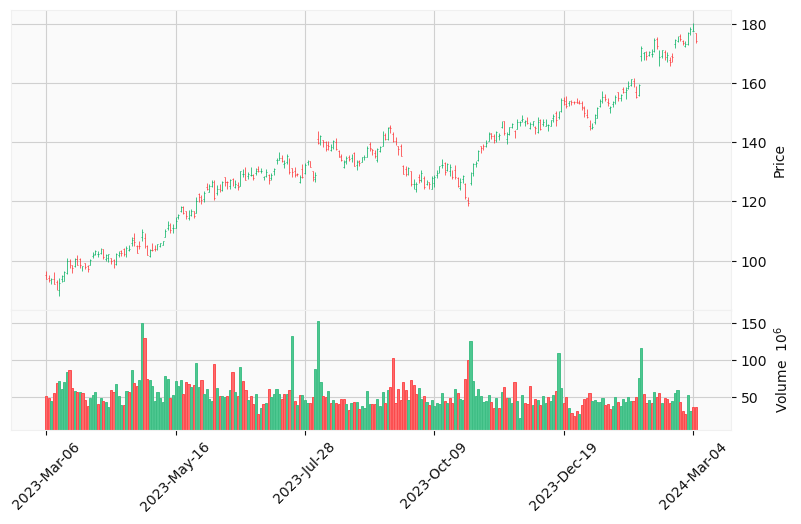

In [13]:
AMAZON.plot_candle()

At the middle of the graph we can see a Wyckoff Structure with high volume values. At the end of this structe, and because of it, the price rises up to 180.

Now I'm gonna have a look at the APPLE stock market.

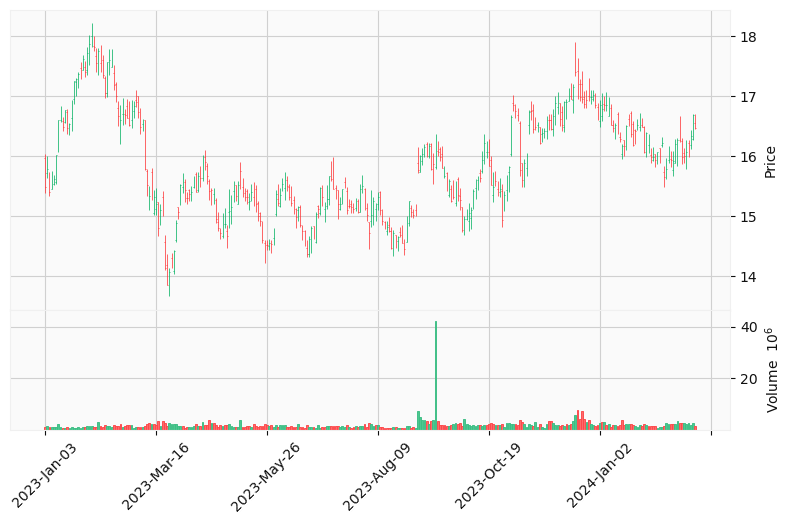

In [14]:
APPLE.plot_candle()

A huge Wyckoff structure is detected, with tons of oscilations between its borders. Because of the low volume value, it's tendency doesn't change as much as the dataset before, but still rises a bit.

Now the NETFLIX dataset.

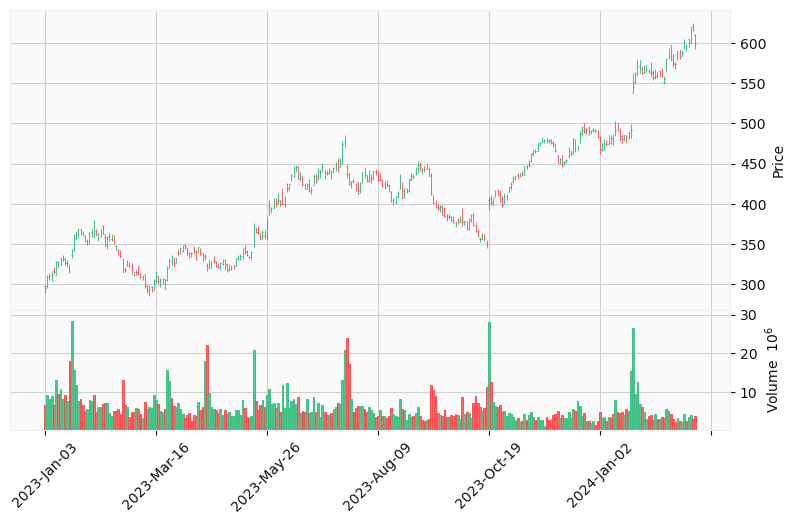

In [15]:
NETFLIX.plot_candle()

Two Wyckoff Structures are detected here, even though are smaller. The first one goes from January 03 to May, and the second one from May 26 to October 19. Both are part of an acomulation process, where the investors  buy as much stock as possible at a lower price with the intention of rising the price and sell that same at a higher value.

The last dataset I am going to plot is the SPX-500 index.

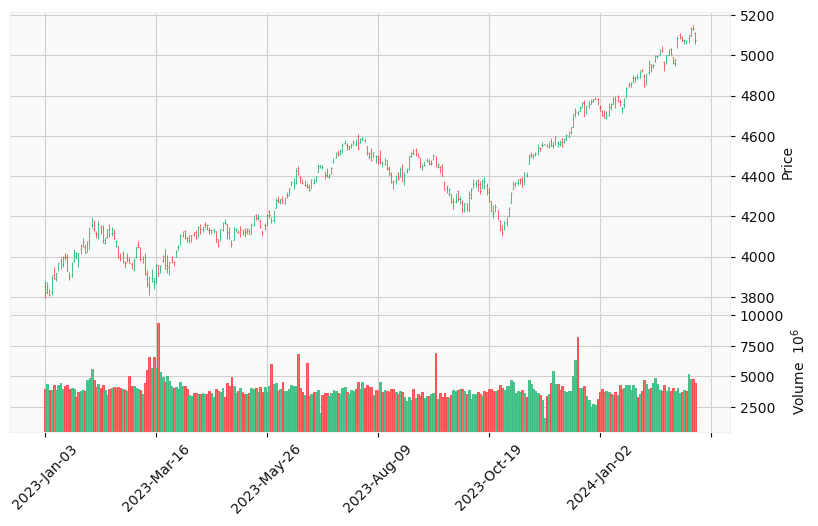

In [16]:
SPX500.plot_candle()

Wyckoff structure from May 26 to October 19. The high volume values and the length of the stucture made a positive change on the tendency of the values.

### Studying the correlation

Let's have a look at the correlation using the `plot_heatmap()` function.

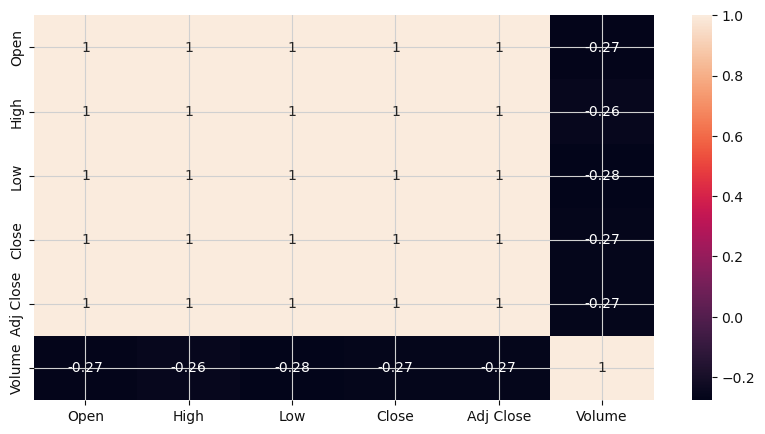

In [17]:
AMAZON.plot_heatmap()

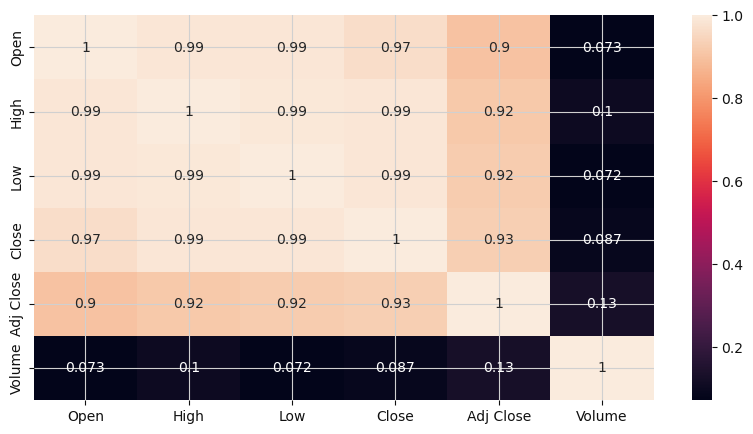

In [18]:
APPLE.plot_heatmap()

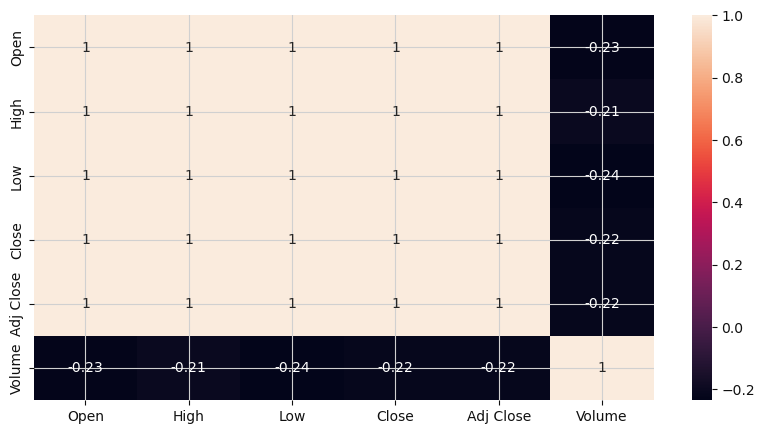

In [19]:
NETFLIX.plot_heatmap()

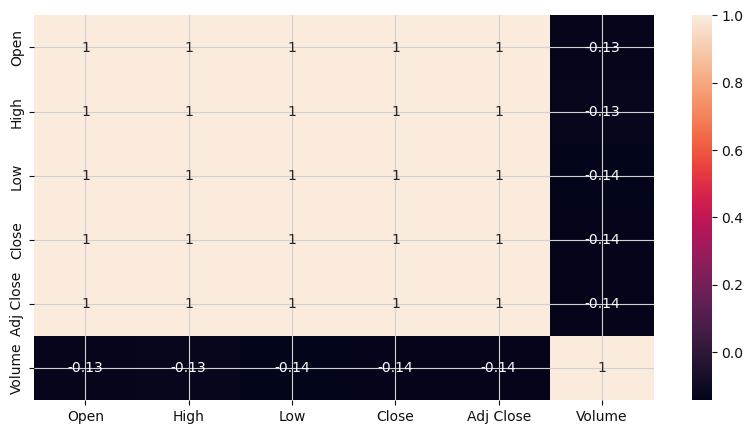

In [20]:
SPX500.plot_heatmap()

Correlation between open, close, high and low are 1. Predictions should be precise, but we could get overfitting easily.

### Studying features

I have no interesest in the Ajusted Close value, so I will delete that feature. Even though the volume has no correlation between the other variables, I know for sure is very important to understand how the values changes through time, so this one can not be deleted at any cost. The other values will help me to understand the context of the time frame.

In [21]:
AMAZON.dataset.drop(columns=['Adj Close'], inplace=True)
APPLE.dataset.drop(columns=['Adj Close'], inplace=True)
NETFLIX.dataset.drop(columns=['Adj Close'], inplace=True)
SPX500.dataset.drop(columns=['Adj Close'], inplace=True)

In [22]:
AMAZON.dataset

,Open,High,Low,Close,Volume
Date,,,,,
2023-03-06,95.190002,96.550003,93.739998,93.750000,52112400
2023-03-07,94.059998,95.089996,92.779999,93.550003,49100700
2023-03-08,93.599998,94.169998,92.180000,93.919998,44899100
2023-03-09,93.680000,96.209999,92.180000,92.250000,56218700
2023-03-10,92.669998,93.570000,90.250000,90.730003,69827500
...,...,...,...,...,...
2024-02-28,172.440002,174.050003,172.270004,173.160004,28180500
2024-02-29,173.009995,177.220001,172.850006,176.759995,53805400
2024-03-01,176.750000,178.729996,176.070007,178.220001,31956200


In [23]:
APPLE.dataset

,Open,High,Low,Close,Volume
Date,,,,,
2023-01-03,15.970000,16.030001,15.380000,15.490000,1335400
2023-01-04,15.720000,16.000000,15.630000,15.780000,1394400
2023-01-05,15.740000,15.740000,15.330000,15.400000,1378800
2023-01-06,15.450000,15.750000,15.450000,15.570000,1232600
2023-01-09,15.540000,15.690000,15.520000,15.620000,1308800
...,...,...,...,...,...
2024-02-28,15.810000,16.264999,15.790000,16.059999,2470600
2024-02-29,16.209999,16.270000,15.980000,16.090000,2854900
2024-03-01,16.180000,16.430000,16.110001,16.340000,1889900


In [24]:
NETFLIX.dataset

,Open,High,Low,Close,Volume
Date,,,,,
2023-01-03,298.059998,298.390015,288.700012,294.950012,6764000
2023-01-04,298.239990,311.140015,295.510010,309.410004,9345100
2023-01-05,307.000000,314.179993,304.549988,309.700012,8328400
2023-01-06,311.570007,316.769989,303.690002,315.549988,8959800
2023-01-09,316.829987,321.700012,313.220001,315.170013,6766600
...,...,...,...,...,...
2024-02-28,595.789978,598.169983,590.010010,596.479980,2605200
2024-02-29,604.250000,604.520020,595.159973,602.919983,3572100
2024-03-01,599.809998,620.280029,599.500000,619.340027,4264200


In [25]:
SPX500.dataset

,Open,High,Low,Close,Volume
Date,,,,,
2023-01-03,3853.290039,3878.459961,3794.330078,3824.139893,3959140000
2023-01-04,3840.360107,3873.159912,3815.770020,3852.969971,4414080000
2023-01-05,3839.739990,3839.739990,3802.419922,3808.100098,3893450000
2023-01-06,3823.370117,3906.189941,3809.560059,3895.080078,3923560000
2023-01-09,3910.820068,3950.570068,3890.419922,3892.090088,4311770000
...,...,...,...,...,...
2024-02-28,5067.200195,5077.370117,5058.350098,5069.759766,3789370000
2024-02-29,5085.359863,5104.990234,5061.890137,5096.270020,5219740000
2024-03-01,5098.509766,5140.330078,5094.160156,5137.080078,4748110000


# PREDICTIONS

For the predictions, we are going to try up differents models and compare each one of them using the mse or rmse of those predictions, and ploting the results with the test data to compare visualy how good those predictions are

In [26]:
def run_regression_models(models, datasets, features, target, new_feature):
    mae_dict = {dataset_name: {} for dataset_name in datasets}
    rmse_dict = {dataset_name: {} for dataset_name in datasets}

    for dataset_name, dataset in datasets.items():
        print('='*50)
        print(f"USING {dataset_name} DATASET")
        print("="*50)

        for model_name, model in models.items():
            model_class = Model(model)

            print(f"Training and evaluating {model_name}...")
            predictions, mae, rmse = model_class.predict(dataset, features, target)
            model_class.plot_predictions(dataset, predictions, model_name, new_feature)
            model_class.compare_test_predictions(dataset, predictions, model_name, new_feature)

            mae_dict[dataset_name][model_name] = mae
            rmse_dict[dataset_name][model_name] = rmse

    return mae_dict, rmse_dict

We are going to use a LSTM to make predictions using tensorflow. The model is as follows.

In [27]:
class MyLSTMModel:
    def __init__(self, input_shape, lstm_units=[512, 256, 128], dense_units=[25, 1]):
        self.model = self.build_model(input_shape, lstm_units, dense_units)

    def build_model(self, input_shape, lstm_units, dense_units):
        model = Sequential()
        
        model.add(LSTM(lstm_units[0], return_sequences=False, input_shape=(input_shape, 1)))
        model.add(Dense(dense_units[1]))

        model.compile(optimizer='adam', loss='mean_squared_error')
        return model

    def train(self, X_train, y_train, epochs=100, batch_size=32):
        print("[STATUS] Training...")
        self.model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

    def evaluate(self, X_test, y_test):
        print("[STATUS] Evaluating...")
        return self.model.evaluate(X_test, y_test, verbose=0)
    
    def calculate_metrics(self, X_test, y_test, predictions):
        print("[STATUS] Calculating metrics...")
        mse = np.mean(np.square(predictions - y_test))
        rmse = np.sqrt(mse)
        
        mae = np.mean(np.abs(predictions - y_test))
        
        return mae[0], rmse[0]

In [28]:
def run_lstm_model(datasets, features, target, new_feature):
    mae_dict = {dataset_name: {} for dataset_name in datasets}
    rmse_dict = {dataset_name: {} for dataset_name in datasets}

    for dataset_name, dataset in datasets.items():
        print("="*30)
        print(f"USING {dataset_name} DATASET")
        print("="*30)
        X_train, y_train, X_test, y_test = dataset.split_data(features, target)
        model = Model(MyLSTMModel(X_train.shape[1]))

        model.model.train(X_train, y_train)
        model.model.evaluate(X_test, y_test)

        predictions = model.model.model.predict(X_test)    
        model.plot_predictions(dataset, predictions, 'LSTM Model', new_feature)
        model.compare_test_predictions(dataset, predictions, 'LSTM Model', new_feature)

        mae, rmse = model.model.calculate_metrics(X_test, y_test, predictions)
        print(f"MAE: {mae}")
        print(f"RMSE: {rmse}")
        mae_dict[dataset_name]['LSTM'] = mae
        rmse_dict[dataset_name]['LSTM'] = rmse

    return mae_dict, rmse_dict

In [29]:
def plot_metrics(metrics_dict, metric_name, new_feature):
    fig, ax = plt.subplots(figsize=(12, 8)) 
    index = np.arange(len(next(iter(metrics_dict.values()))))
    bar_width = 0.2

    models = list(next(iter(metrics_dict.values())).keys())
    datasets = list(metrics_dict.keys())
    colors = ['cadetblue', 'skyblue', 'cornflowerblue', 'slateblue']

    for i, dataset_name in enumerate(datasets):
        values = [metrics_dict[dataset_name][model] for model in models]
        bar = ax.bar(index + i * bar_width, values, bar_width, label=dataset_name, color=colors[i % len(colors)])

    for i, dataset_name in enumerate(datasets):
        values = [metrics_dict[dataset_name][model] for model in models]
        for j, v in enumerate(values):
            ax.text(j + i * bar_width, v + 0.01, f"{v:.2f}", ha='center', color='black', fontsize=14)

    ax.set_ylabel(f'{metric_name} Values', fontsize=20)
    ax.set_title(f'{metric_name} for Each Dataset and Model',
                fontsize=20, loc='center', fontdict=dict(weight='bold'))
    
    ax.set_xticks(index + bar_width * (len(metrics_dict) - 1) / 2)
    ax.set_xticklabels(models, rotation=45, fontsize=15)

    handles = [plt.Rectangle((0, 0), 1, 1, color=colors[i % len(colors)]) for i in range(len(datasets))]
    ax.legend( handles, datasets, title="Datasets", loc='upper left', bbox_to_anchor=(1, 1), fontsize='large')

    max_value = max([max(metrics_dict[dataset_name].values()) for dataset_name in datasets])
    ax.set_ylim(0, max_value * 1.3)

    plt.tight_layout()

    # Ensure the directory exists
    directory = f'Informe/Imatges/PrimerEnfoc'
    if not os.path.exists(directory):
        os.makedirs(directory)

    # Build the filename
    filename = f"{metric_name}_{new_feature if new_feature else 'default'}.png"
    filepath = os.path.join(directory, filename)

    # Save the plot as a PNG image
    plt.savefig(filepath, bbox_inches='tight')

    # Show the plot
    plt.show() 


In [30]:
def forecast(datasets, features, target, new_feature=None):
    models = {
        "Random Forest": RandomForestRegressor(n_estimators=1000),
        "Decision Tree": DecisionTreeRegressor(),
        "XGBoost": XGBRegressor()
    }

    mae_dict_reg, rmse_dict_reg = run_regression_models(models, datasets, features, target, new_feature)
    mae_dict_lstm, rmse_dict_lstm = run_lstm_model(datasets, features, target, new_feature)

    # Combining MAE and RMSE dictionaries
    mae_dict = {k: {**mae_dict_reg[k], **mae_dict_lstm[k]} for k in mae_dict_reg.keys()}
    rmse_dict = {k: {**rmse_dict_reg[k], **rmse_dict_lstm[k]} for k in rmse_dict_reg.keys()}

    plot_metrics(mae_dict, "MAE", new_feature)
    plot_metrics(rmse_dict, "RMSE", new_feature)


Now let's generate a different dataset from which we'll make some modifications for the further predictions, and we are going to normalize the data.

In [31]:
scaler = MinMaxScaler()

AMAZON2 = AMAZON.copy()
APPLE2 = APPLE.copy()
NETFLIX2 = NETFLIX.copy()
SPX5002 = SPX500.copy()

# Normalitza les dades d'AMAZON2
AMAZON2_normalized = scaler.fit_transform(AMAZON2.dataset)
AMAZON2.dataset = pd.DataFrame(AMAZON2_normalized, columns=AMAZON2.dataset.columns, index=AMAZON2.dataset.index)

# Normalitza les dades d'APPLE2
APPLE2_normalized = scaler.fit_transform(APPLE2.dataset)
APPLE2.dataset = pd.DataFrame(APPLE2_normalized, columns=APPLE2.dataset.columns, index=APPLE2.dataset.index)

# Normalitza les dades de NETFLIX2
NETFLIX2_normalized = scaler.fit_transform(NETFLIX2.dataset)
NETFLIX2.dataset = pd.DataFrame(NETFLIX2_normalized, columns=NETFLIX2.dataset.columns, index=NETFLIX2.dataset.index)

# Normalitza les dades de SPX5002
SPX5002_normalized = scaler.fit_transform(SPX5002.dataset)
SPX5002.dataset = pd.DataFrame(SPX5002_normalized, columns=SPX5002.dataset.columns, index=SPX5002.dataset.index)

We are going to run three different regression models plus the neural network we've created for each dataset.

In [32]:
datasets = {
    "AMAZON": AMAZON2,
    "APPLE": APPLE2,
    "NETFLIX": NETFLIX2,
    "SPX500": SPX5002
}

### First approach

Simple strategies are going to be the first type of models I am going to try. I am going to try to predict the close value given the previous ones. I am going to generate another column, `next close`, which will have the next close value.

In [33]:
def add_next_close_feature(Dataset):
    Dataset.dataset.loc[:, 'Next Close'] = Dataset.dataset['Close'].shift(-1)
    Dataset.dataset = Dataset.dataset.iloc[:-1]
    
    return Dataset

In [34]:
AMAZON2 = add_next_close_feature(AMAZON2)
APPLE2 = add_next_close_feature(APPLE2)
NETFLIX2 = add_next_close_feature(NETFLIX2)
SPX5002 = add_next_close_feature(SPX5002)

USING AMAZON DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.16587942117109286
Root Mean squared Error - RMSE : 0.20644696288710584
----------------------------------------------------------------------------------------------------


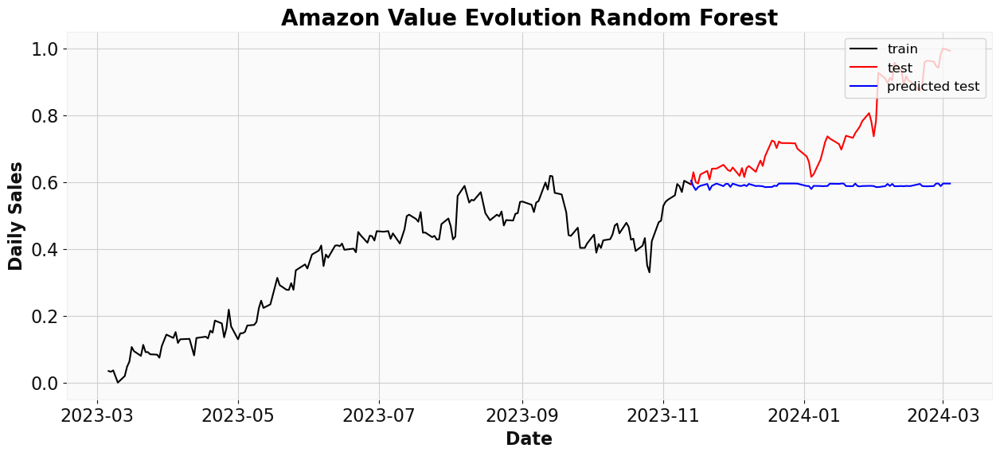

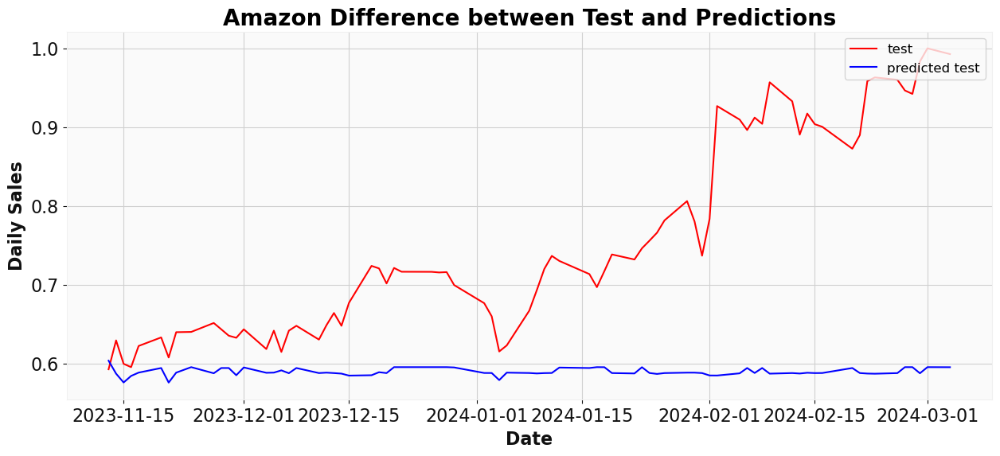

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.1870499531422529
Root Mean squared Error - RMSE : 0.22458174468327993
----------------------------------------------------------------------------------------------------


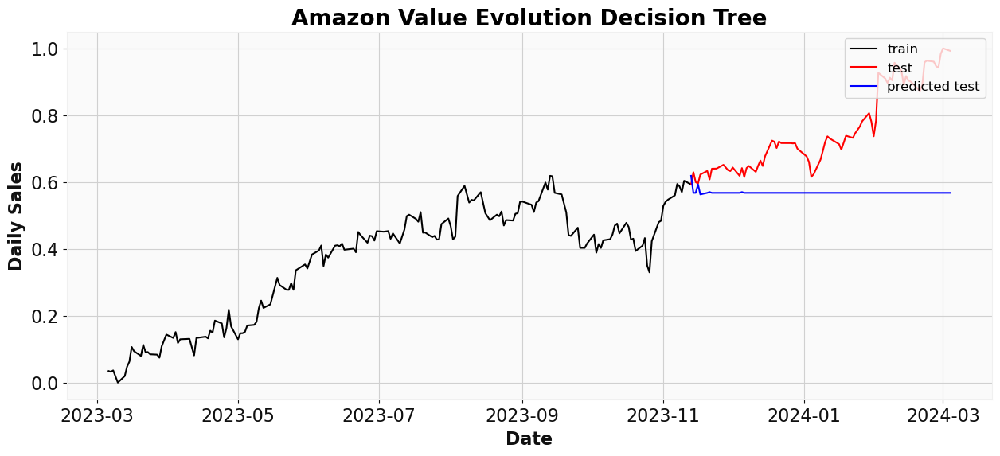

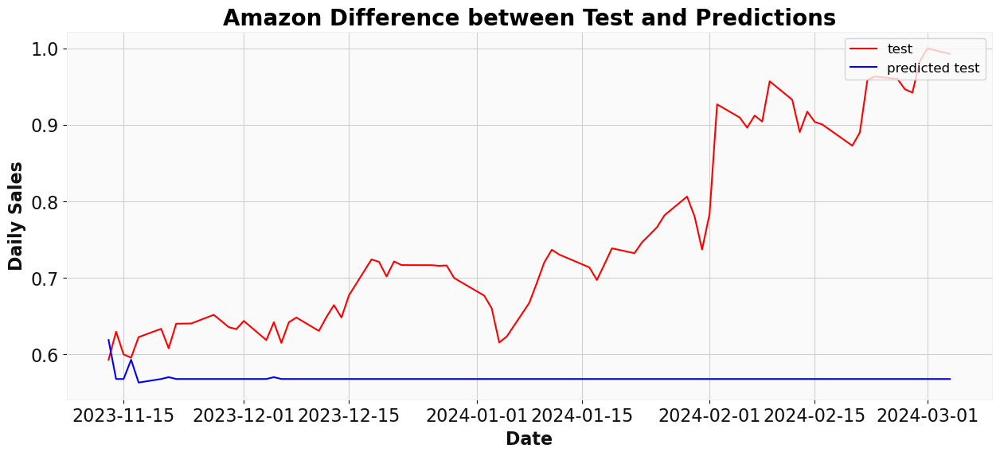

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.18335051510500777
Root Mean squared Error - RMSE : 0.22179762492991748
----------------------------------------------------------------------------------------------------


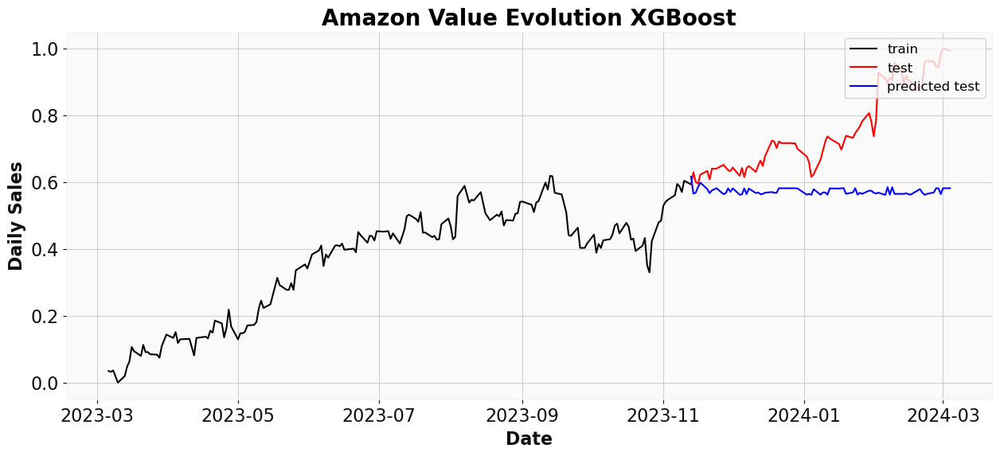

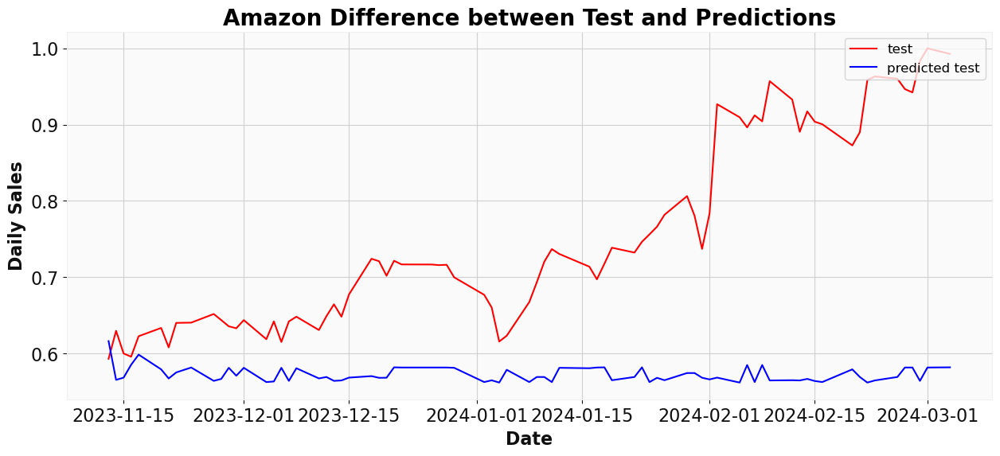

USING APPLE DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.05443110133577363
Root Mean squared Error - RMSE : 0.07214806917268551
----------------------------------------------------------------------------------------------------


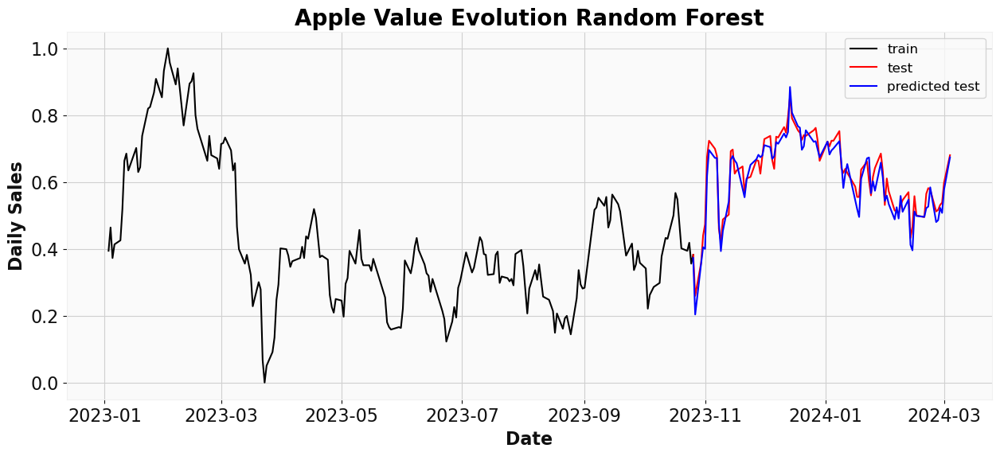

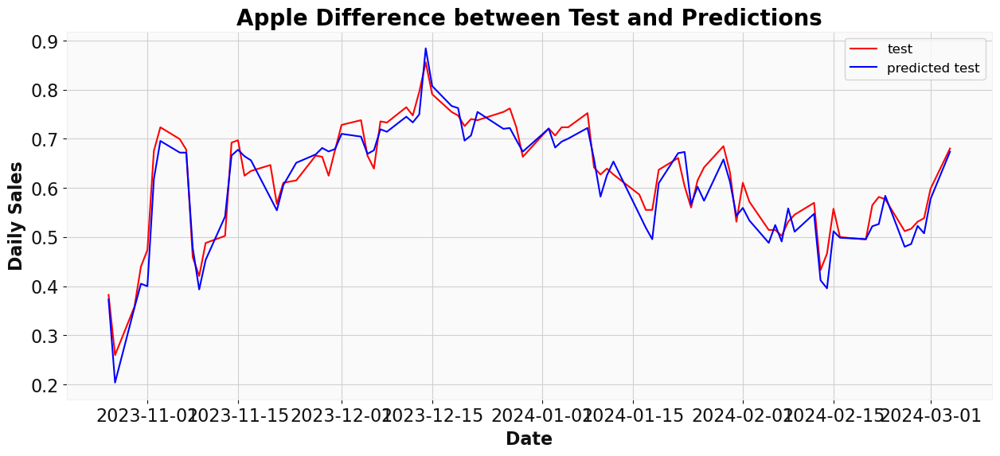

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.07503821569055939
Root Mean squared Error - RMSE : 0.09338189377387317
----------------------------------------------------------------------------------------------------


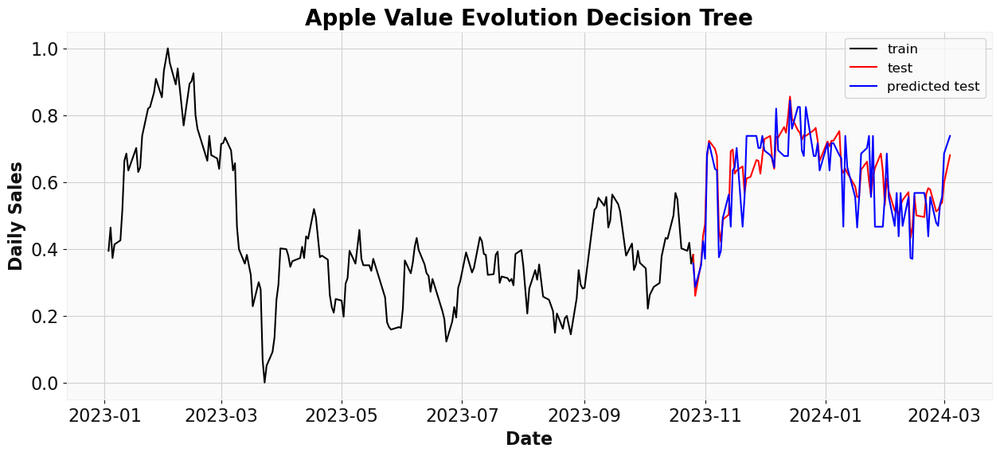

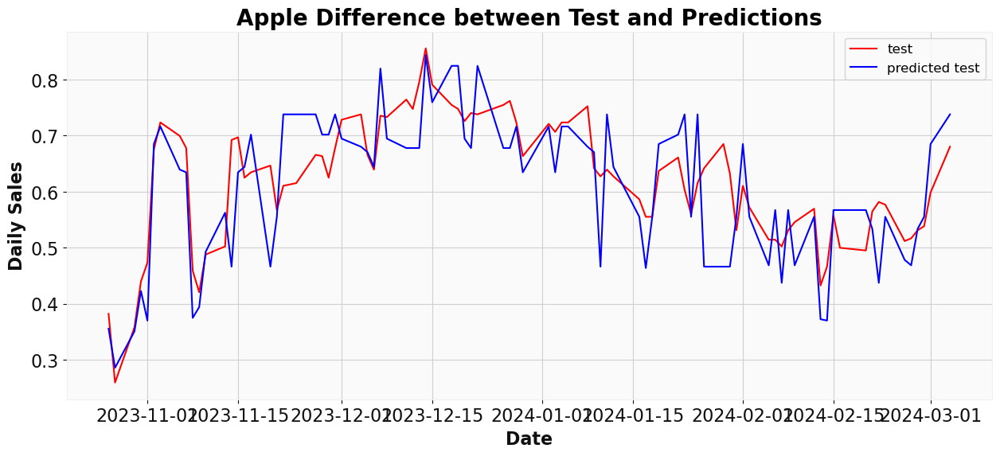

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.05991517695467782
Root Mean squared Error - RMSE : 0.07602636274995643
----------------------------------------------------------------------------------------------------


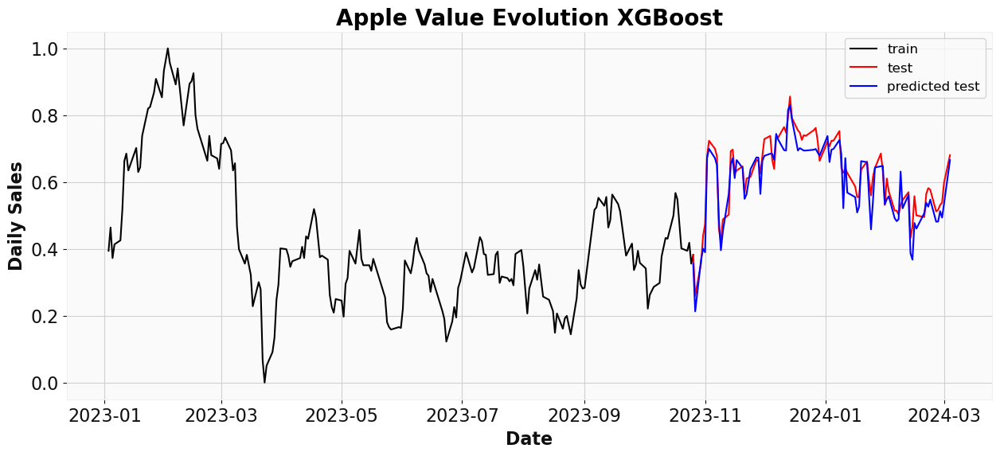

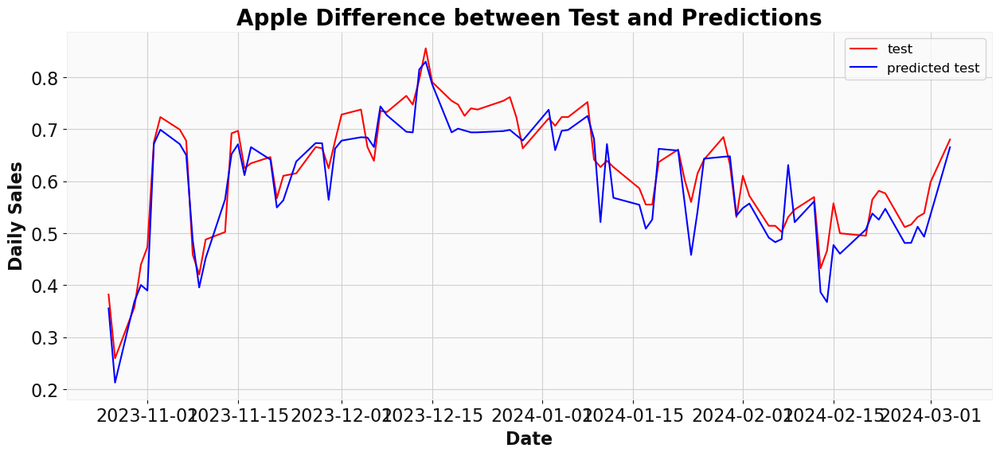

USING NETFLIX DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.1636496668871036
Root Mean squared Error - RMSE : 0.22704772024854328
----------------------------------------------------------------------------------------------------


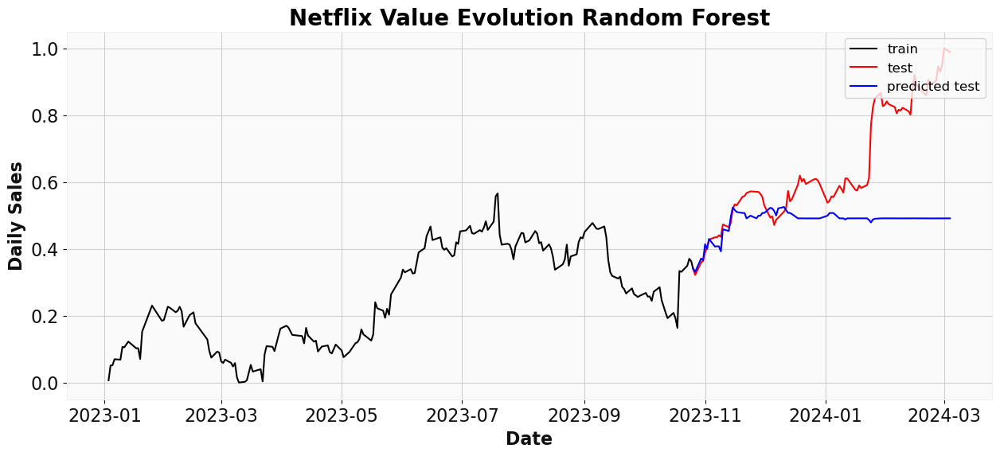

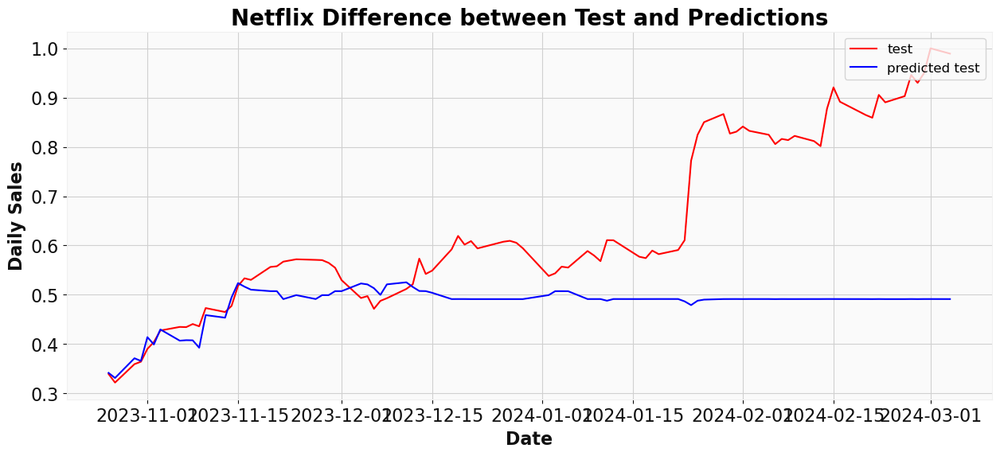

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.20530361445148462
Root Mean squared Error - RMSE : 0.2630090863434414
----------------------------------------------------------------------------------------------------


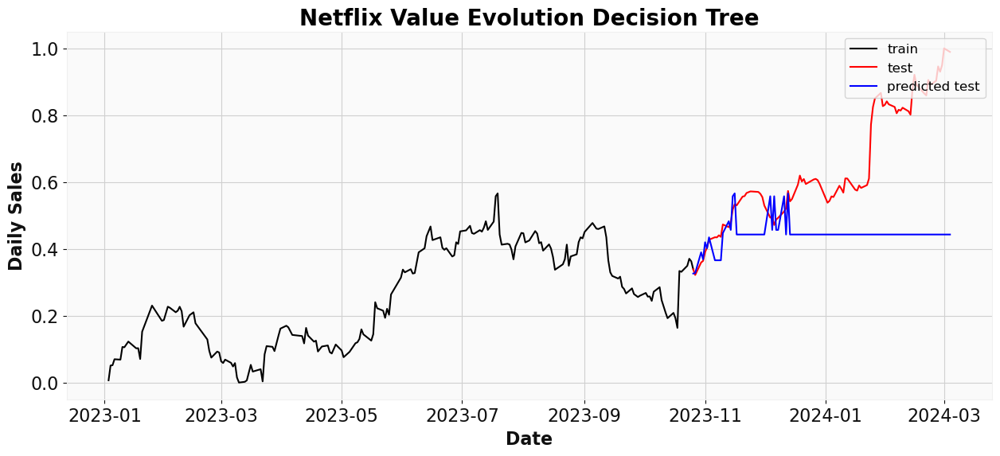

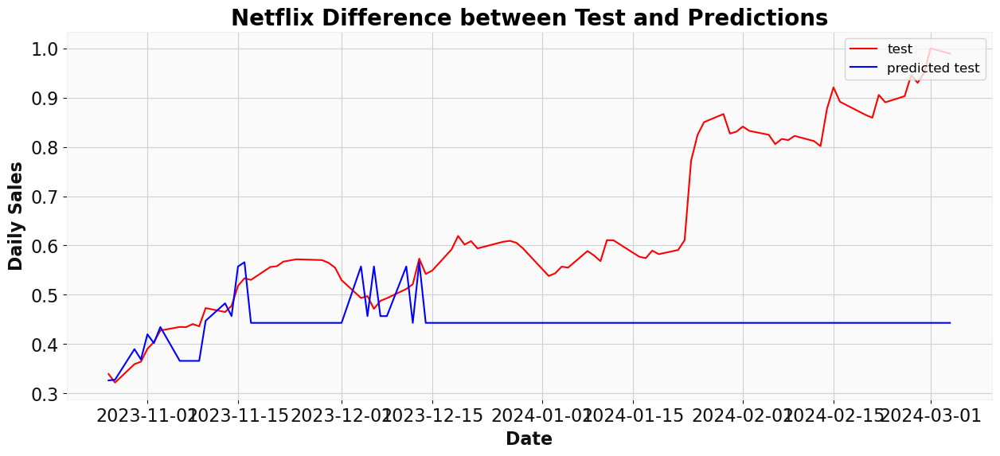

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.19961280215783078
Root Mean squared Error - RMSE : 0.2607422889559184
----------------------------------------------------------------------------------------------------


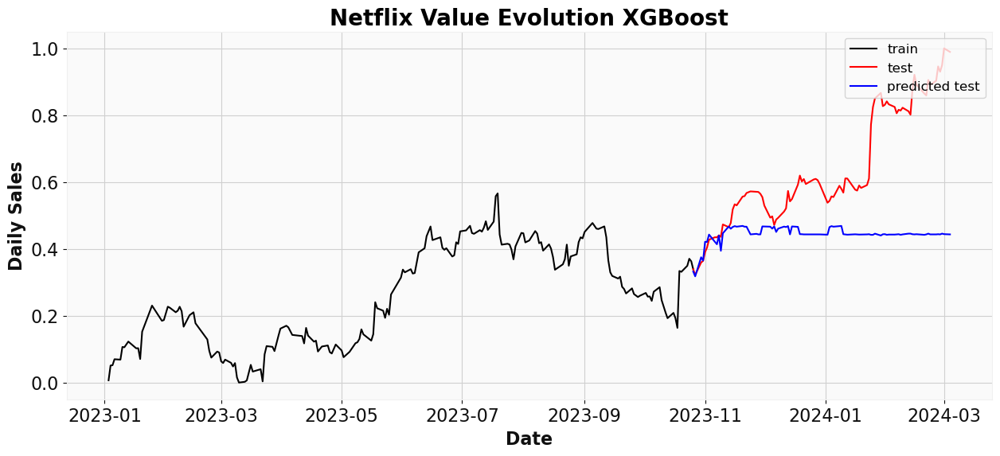

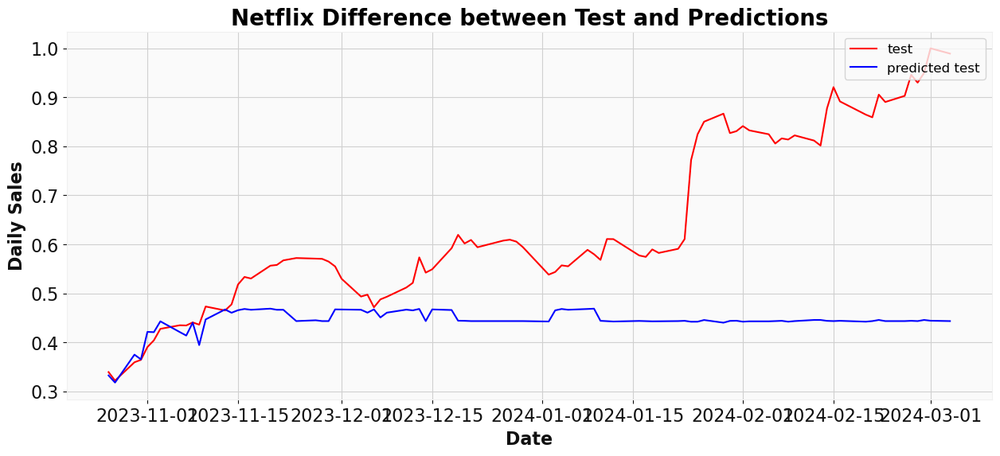

USING SPX500 DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15895870305972962
Root Mean squared Error - RMSE : 0.20670784457330935
----------------------------------------------------------------------------------------------------


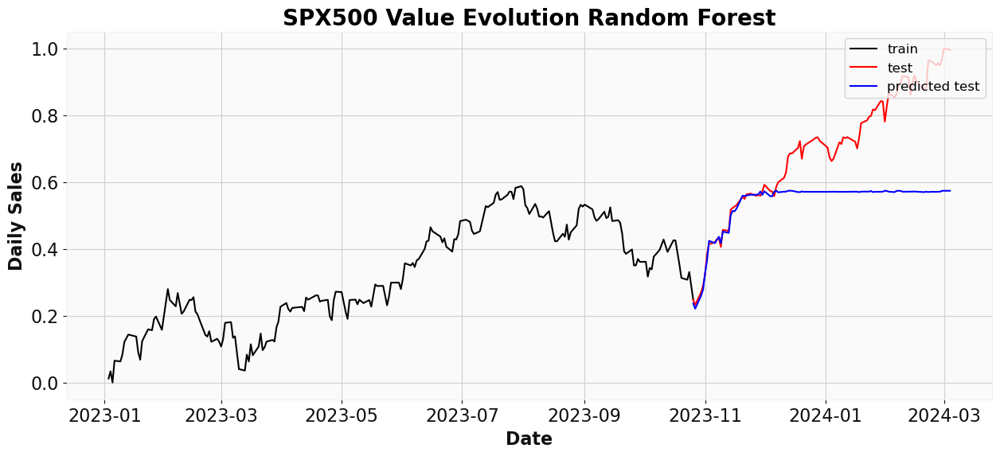

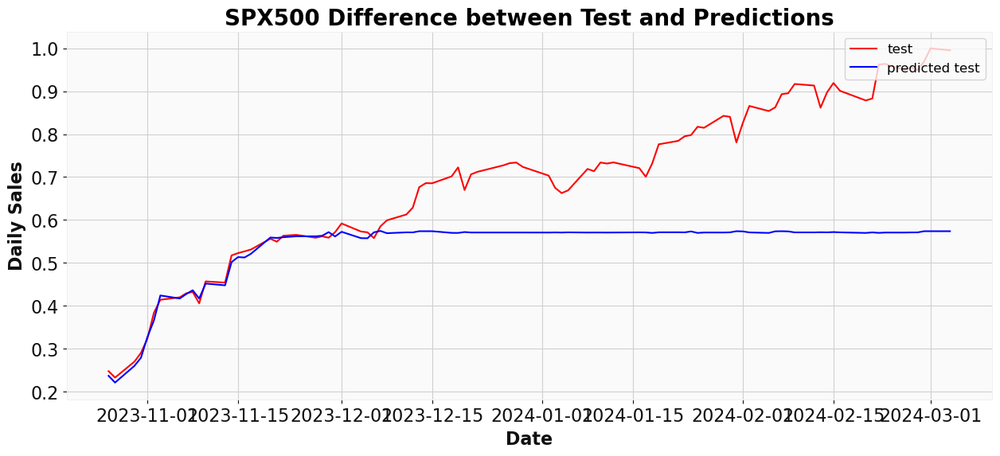

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15349034112407986
Root Mean squared Error - RMSE : 0.1989626237122268
----------------------------------------------------------------------------------------------------


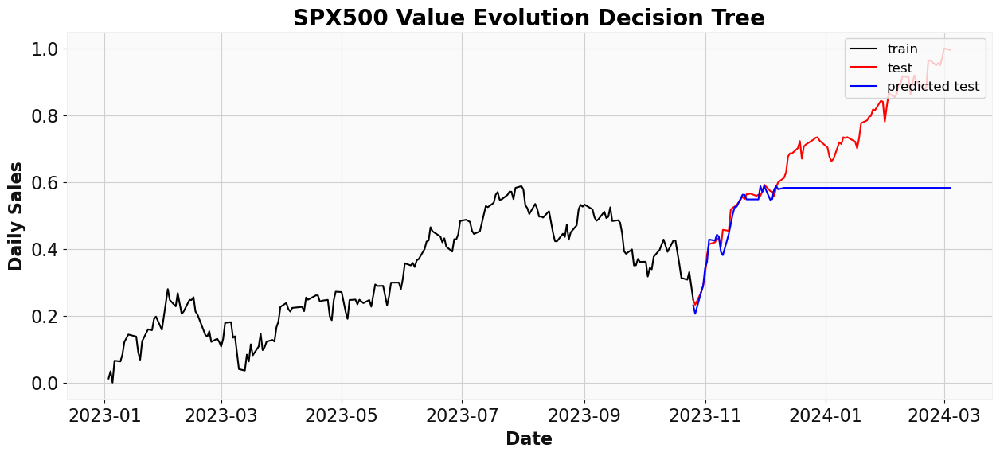

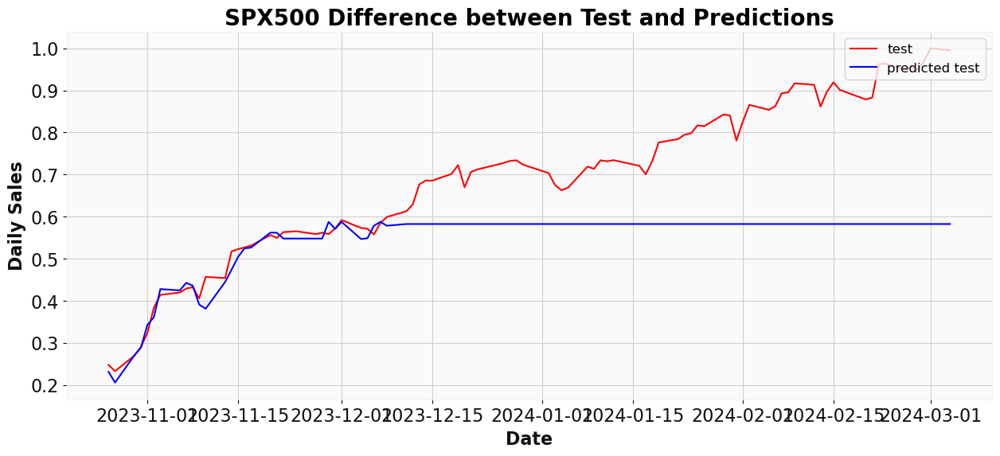

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15441480556134793
Root Mean squared Error - RMSE : 0.20013863480082864
----------------------------------------------------------------------------------------------------


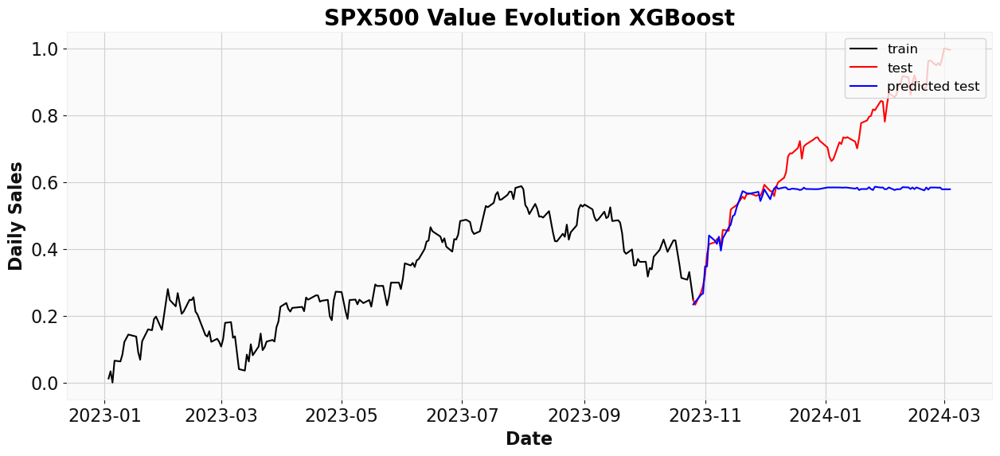

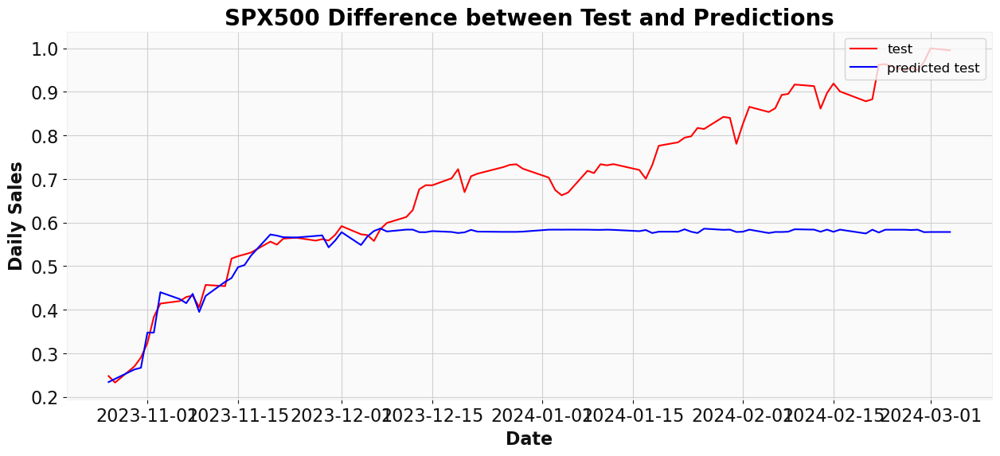

USING AMAZON DATASET
[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 4ms/step


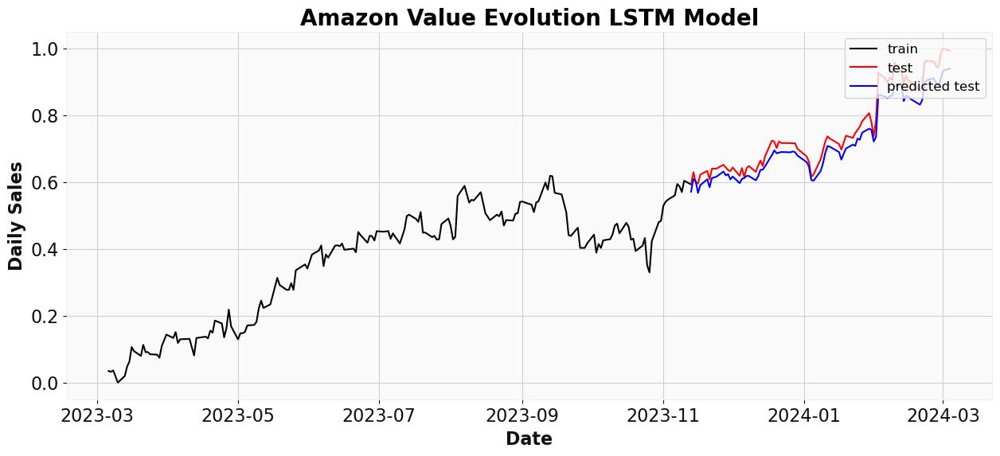

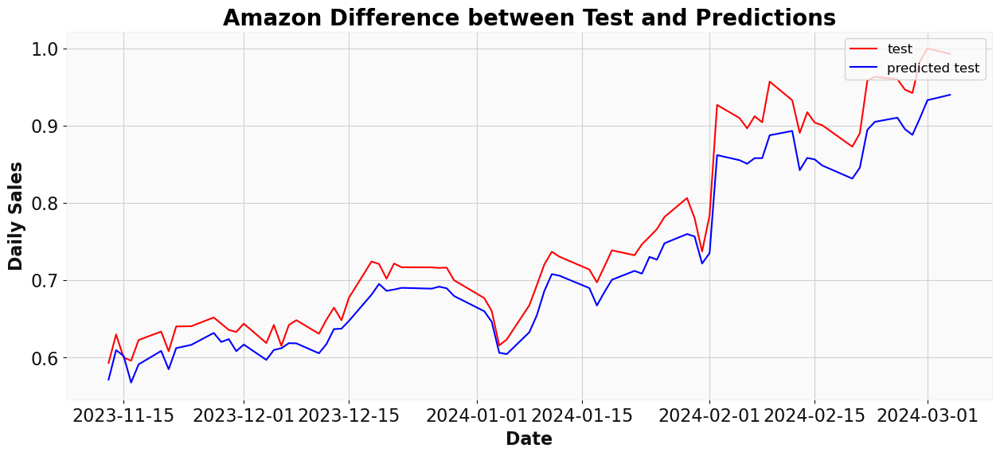

[STATUS] Calculating metrics...
MAE: 0.04039518417605298
RMSE: 0.050414495394885454
USING APPLE DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 5ms/step


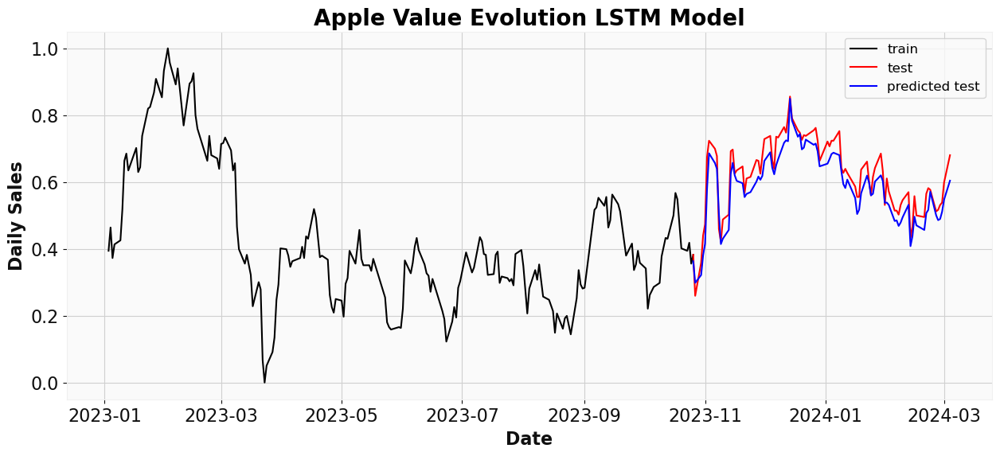

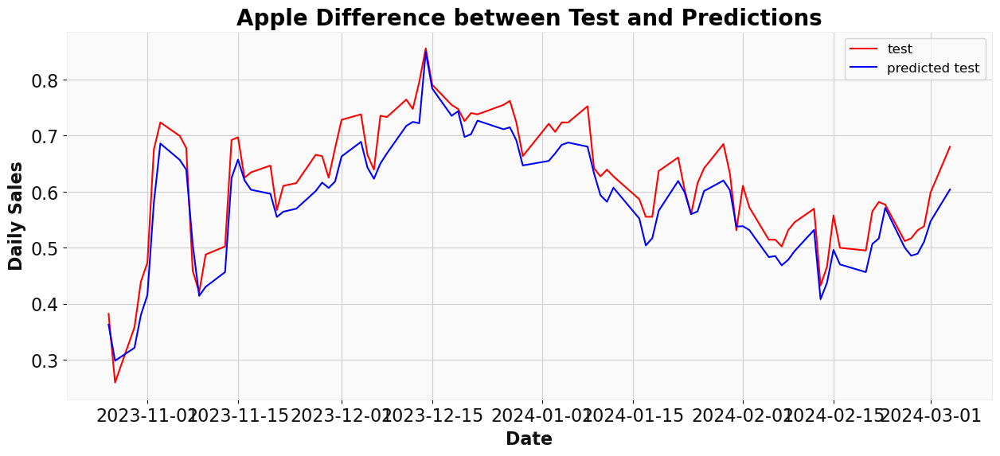

[STATUS] Calculating metrics...
MAE: 0.06191496613188214
RMSE: 0.07723053648843302
USING NETFLIX DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 5ms/step


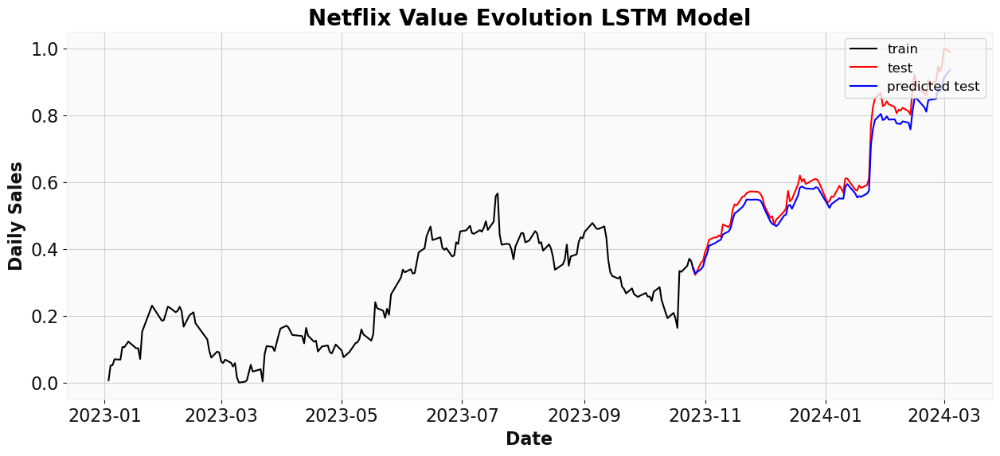

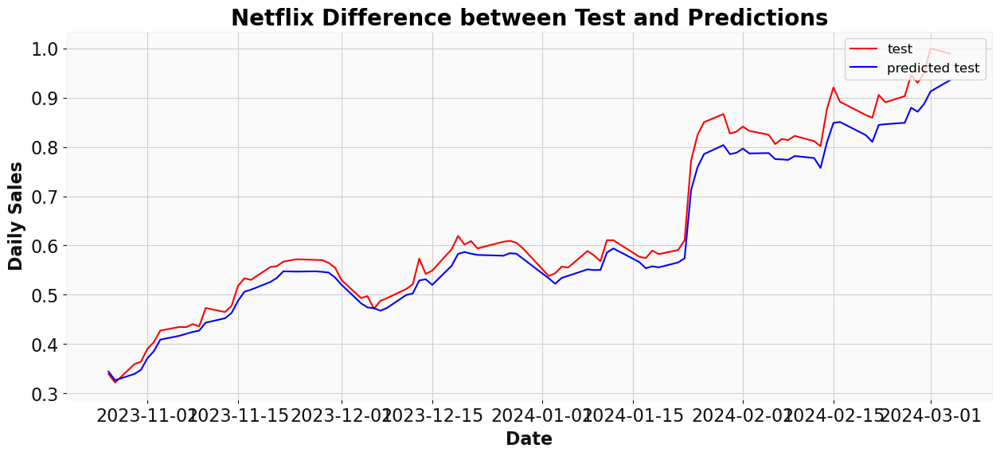

[STATUS] Calculating metrics...
MAE: 0.03965546093374295
RMSE: 0.05052967543777708
USING SPX500 DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 4ms/step


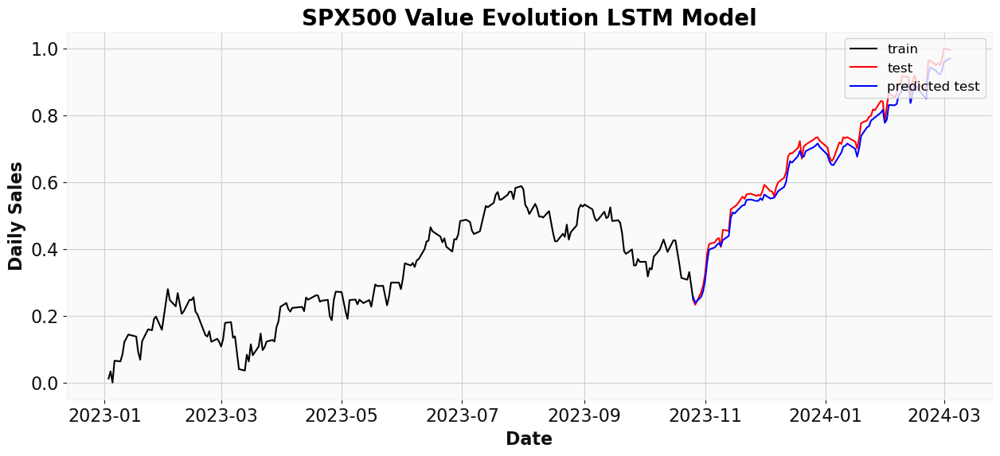

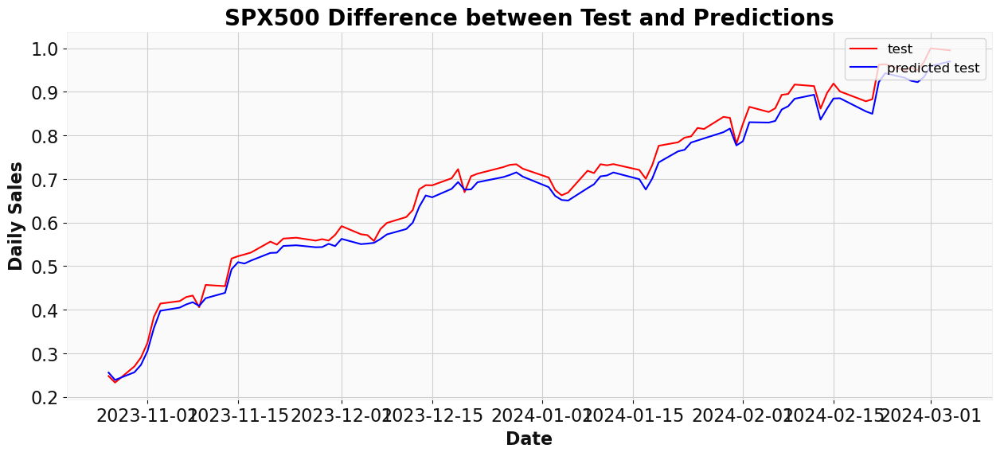

[STATUS] Calculating metrics...
MAE: 0.03407259992560296
RMSE: 0.03976578776063602


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


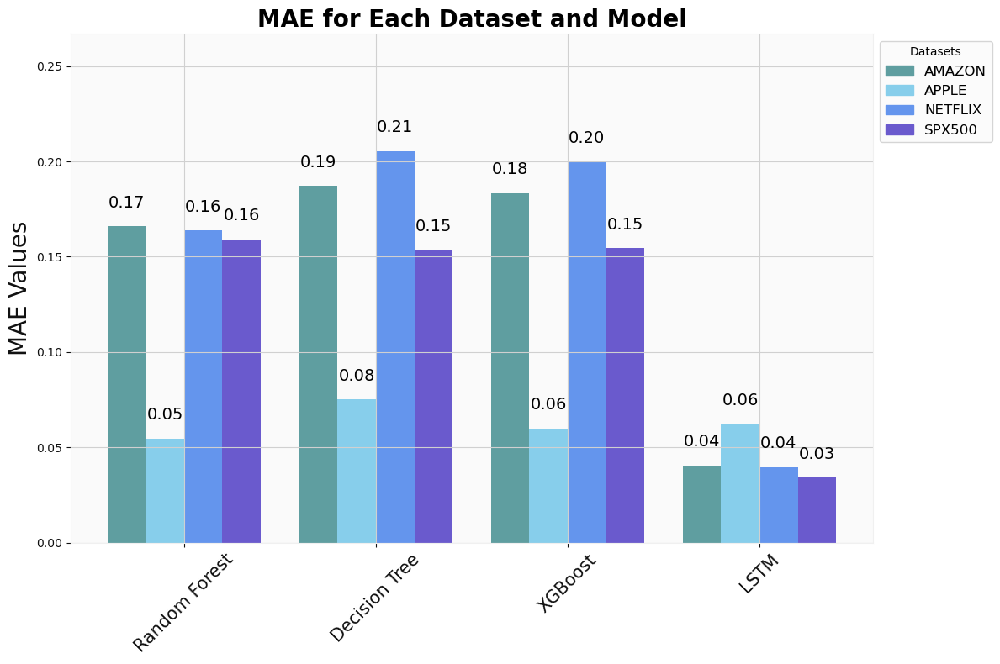

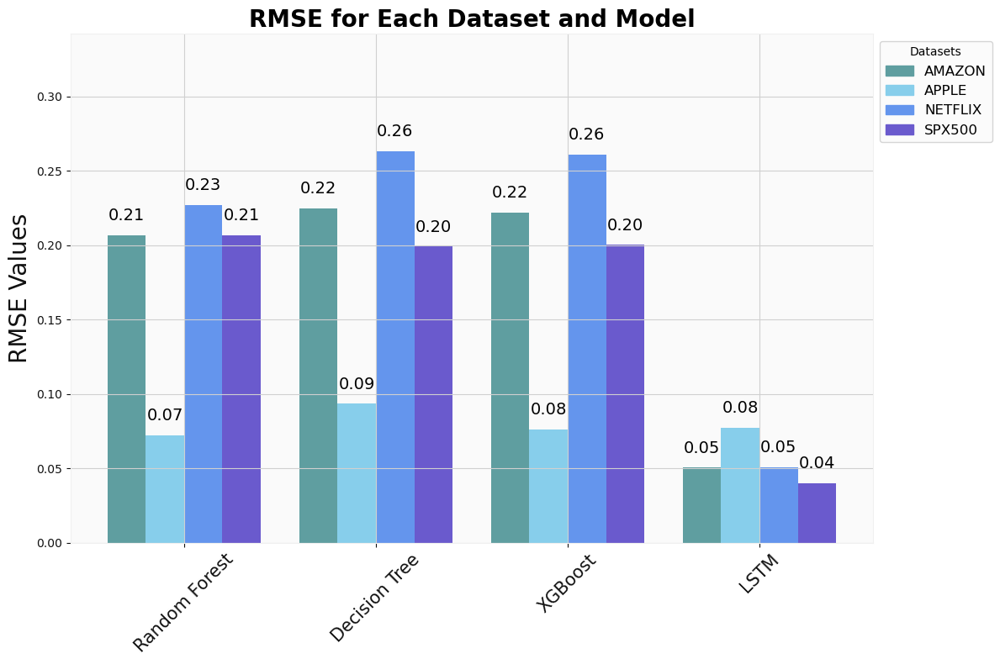

In [35]:
features = ['Open', 'Close', 'High', 'Low', 'Volume']
target = ['Next Close']

forecast(datasets, features, target, 'original')

Now, from the models that work better let's try to see how it predicts futures values. From this point forward, I'll need a classification model to see how the prices are going to evolve.

### Neuronal Network

### Second approach

In this second approach, I'm gonna add the difference between one close and the other one to see if the predictions improve

In [36]:
def add_close_difference(Dataset):
    difference = list()
    difference.append(0)
    
    for i in range(1, len(Dataset.dataset['Close'])):
        diff = Dataset.dataset['Close'][i] - Dataset.dataset['Close'][i-1]
        difference.append(diff)
        
    Dataset.dataset['Difference'] = difference
    return Dataset

In [37]:
AMAZON2 = add_close_difference(AMAZON2)
APPLE2 = add_close_difference(APPLE2)
NETFLIX2 = add_close_difference(NETFLIX2)
SPX5002 = add_close_difference(SPX5002)

USING AMAZON DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.1687914883937579
Root Mean squared Error - RMSE : 0.20855482800880673
----------------------------------------------------------------------------------------------------


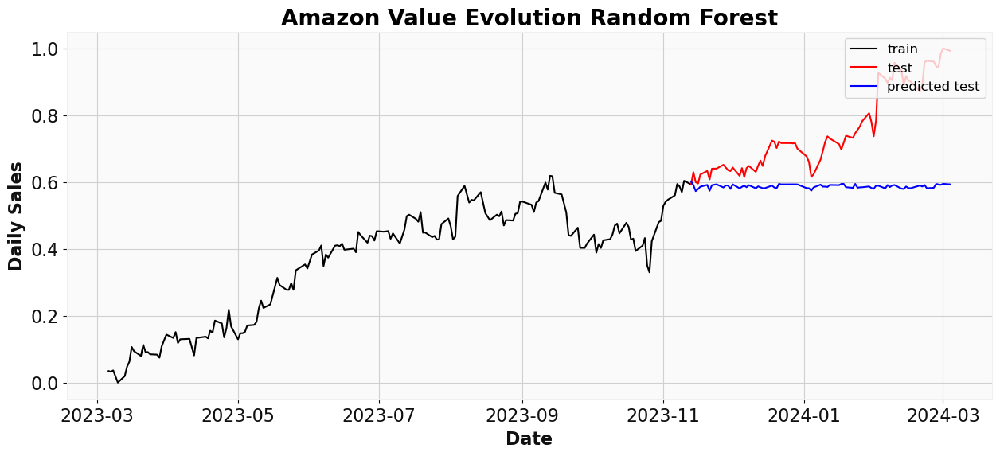

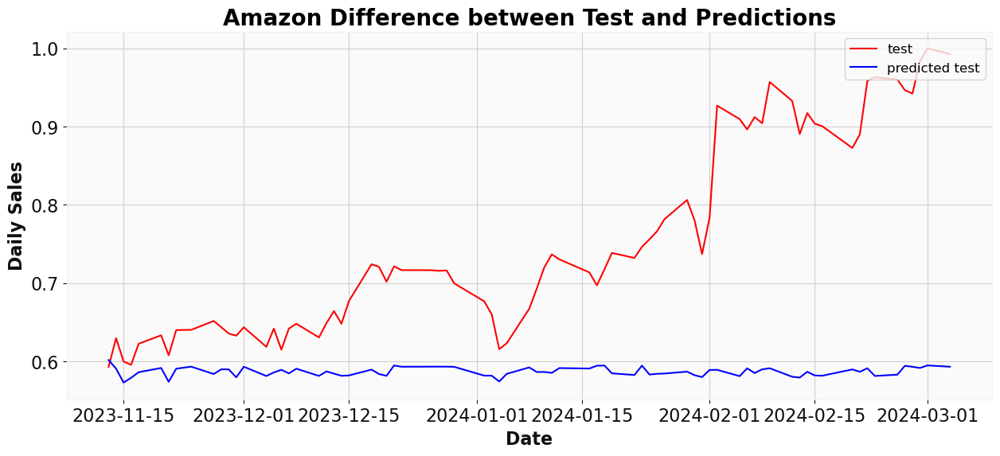

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.1872198979819386
Root Mean squared Error - RMSE : 0.22472496727485075
----------------------------------------------------------------------------------------------------


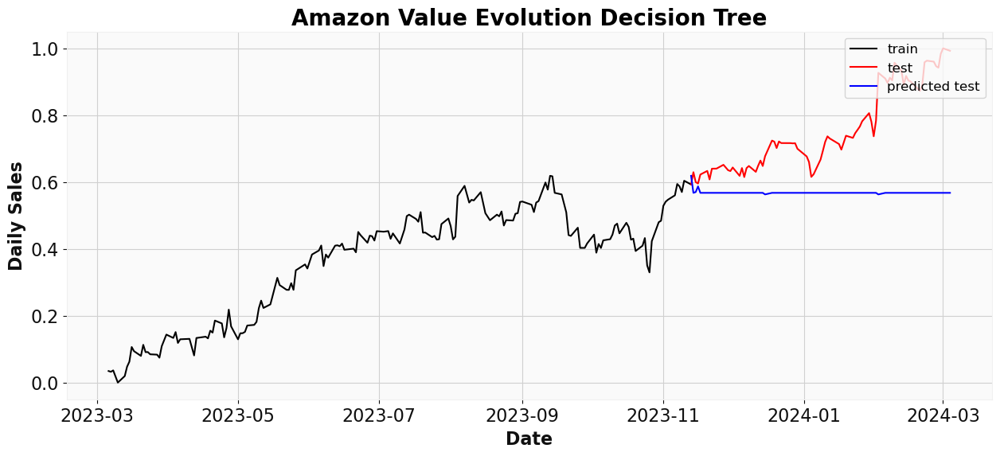

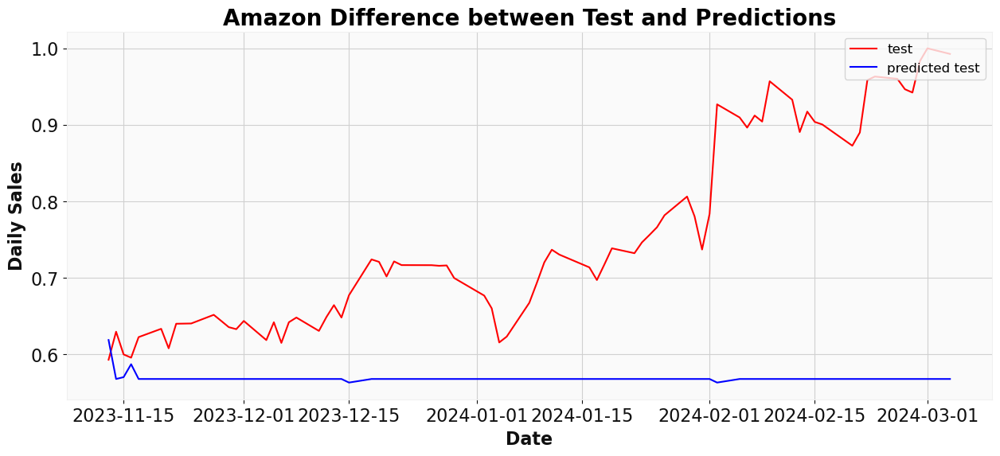

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.18441871974634994
Root Mean squared Error - RMSE : 0.2224752002010815
----------------------------------------------------------------------------------------------------


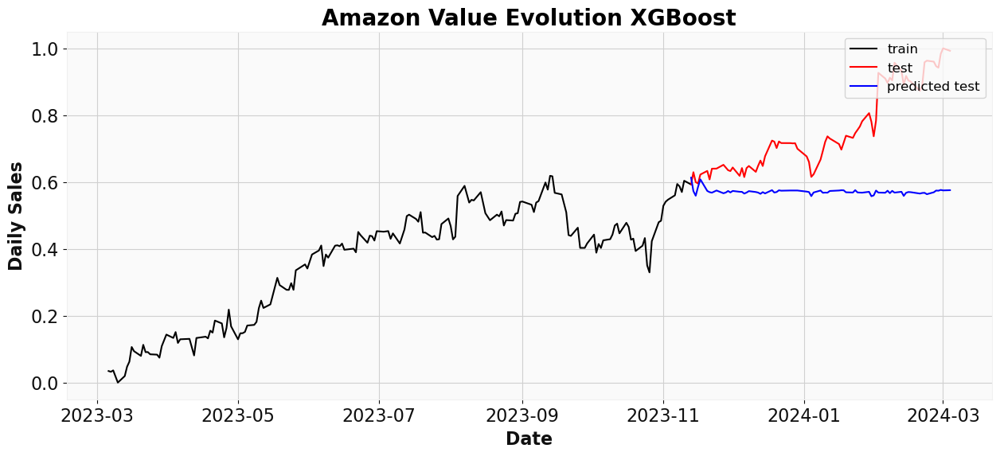

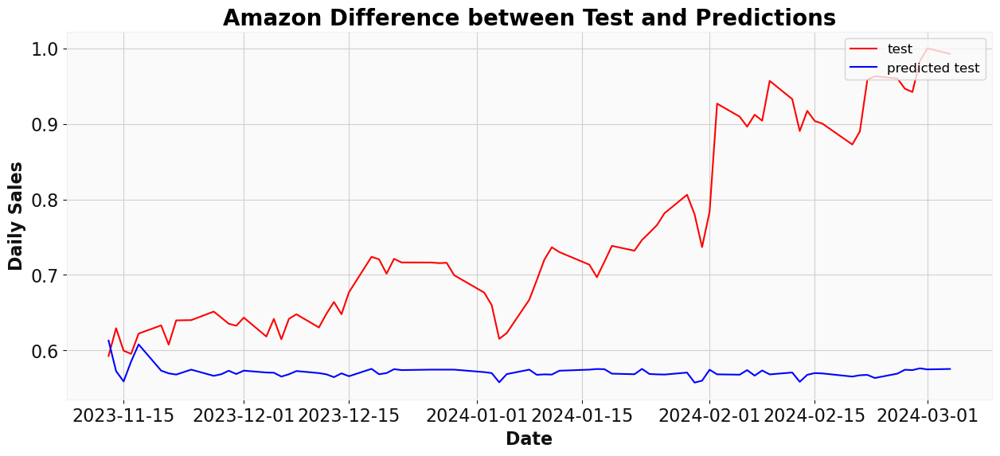

USING APPLE DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.05512252403573012
Root Mean squared Error - RMSE : 0.07265533534179336
----------------------------------------------------------------------------------------------------


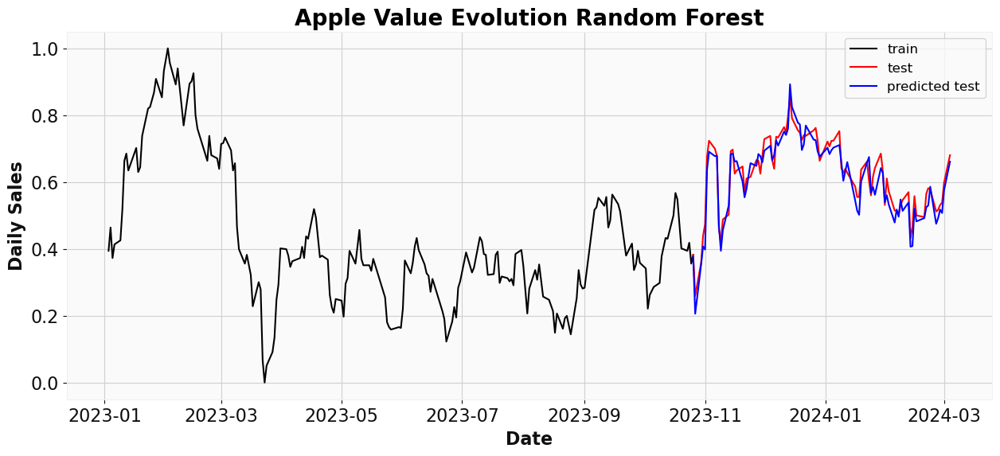

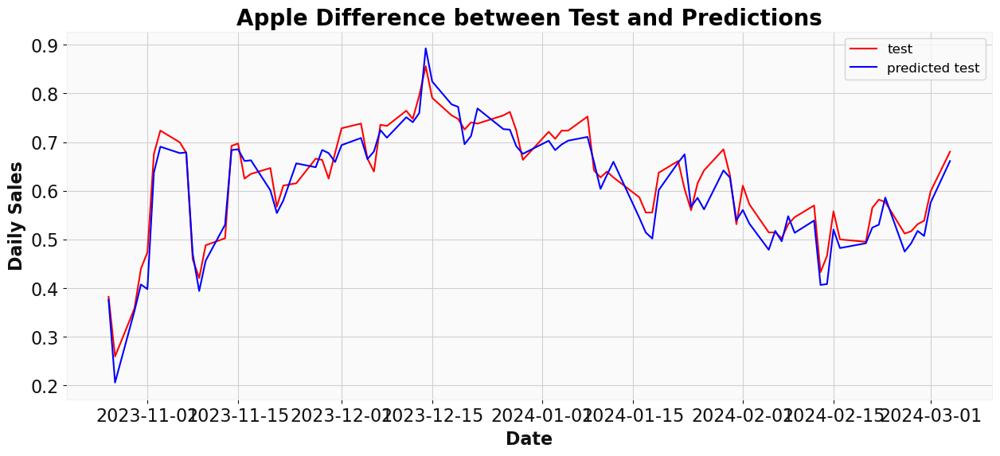

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.07413678704108387
Root Mean squared Error - RMSE : 0.09427106970415855
----------------------------------------------------------------------------------------------------


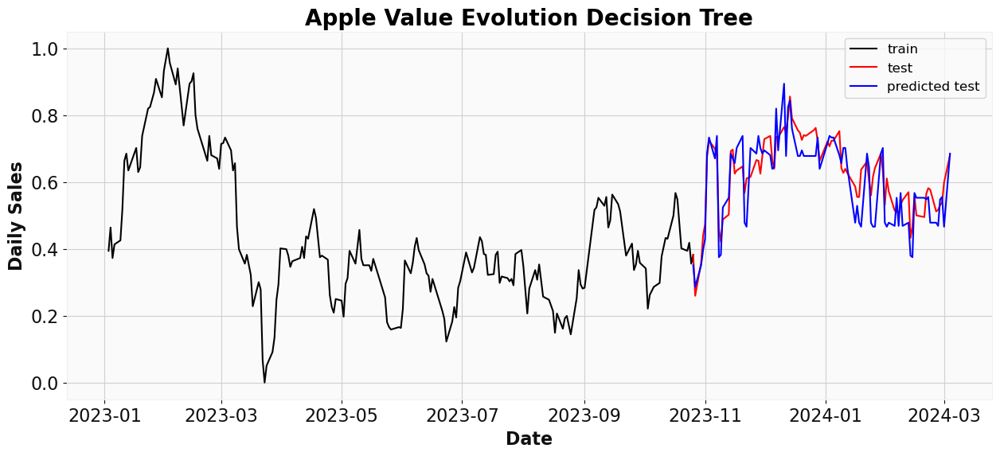

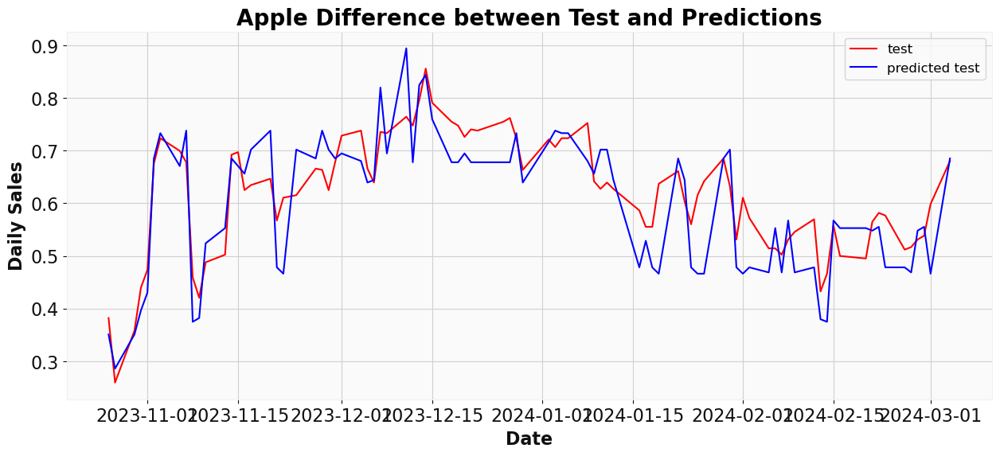

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.061619314544642645
Root Mean squared Error - RMSE : 0.0787360904532126
----------------------------------------------------------------------------------------------------


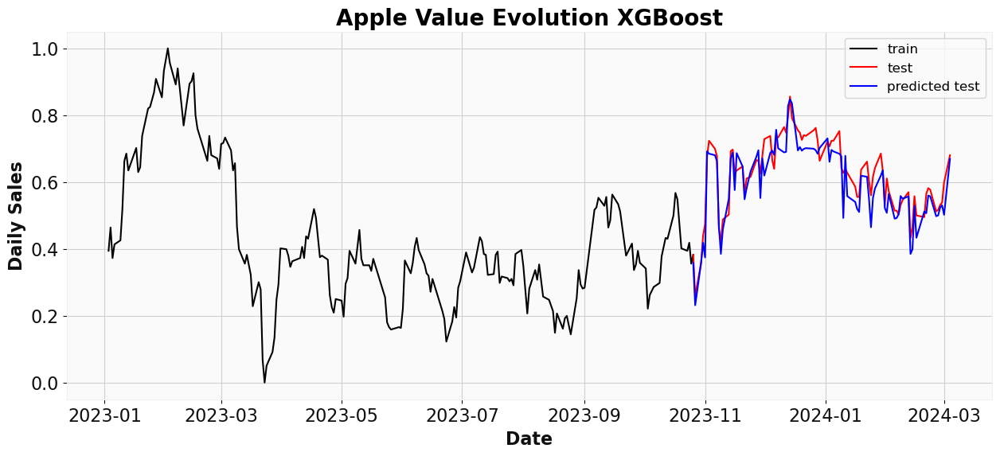

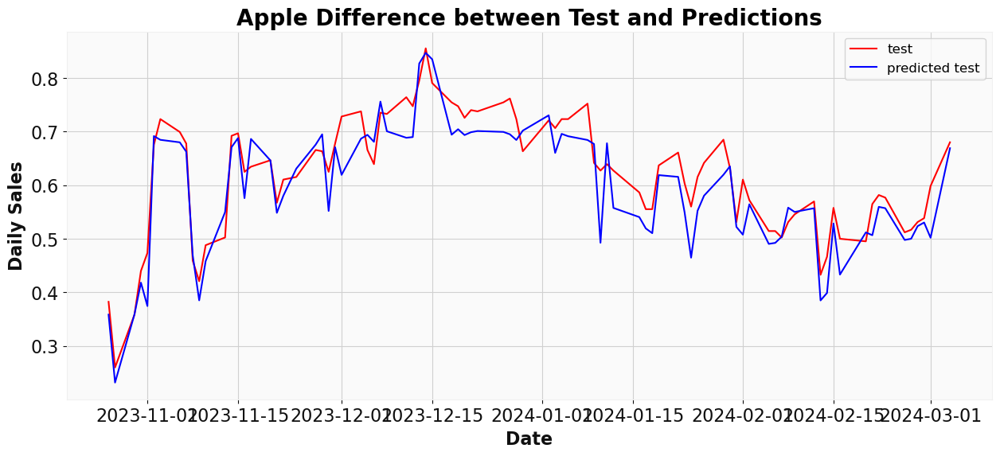

USING NETFLIX DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.16357770610311917
Root Mean squared Error - RMSE : 0.22529279224933488
----------------------------------------------------------------------------------------------------


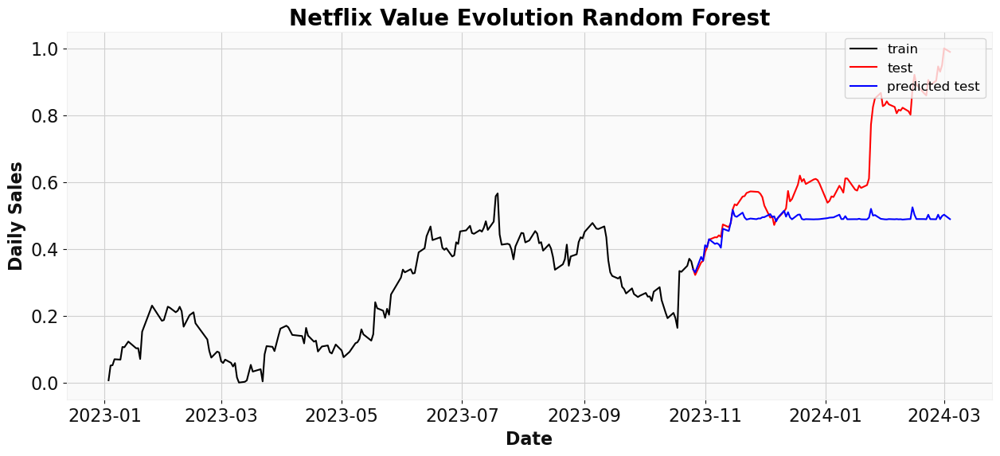

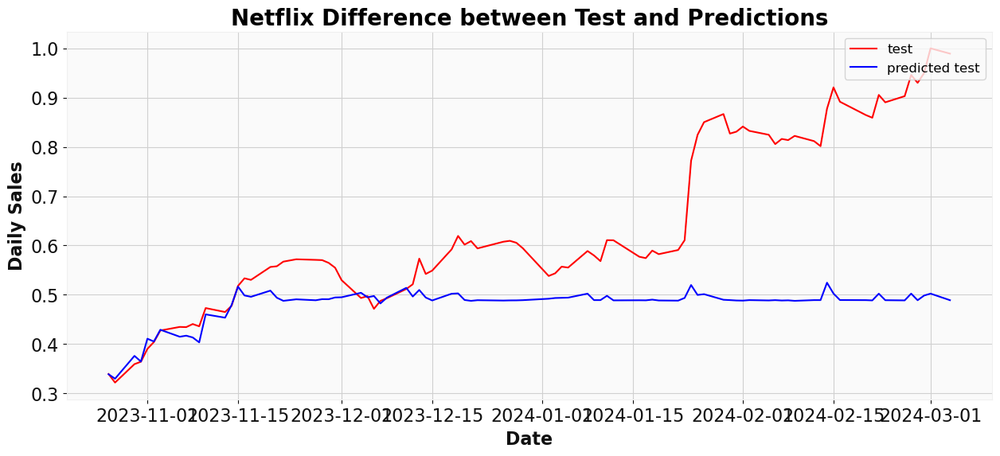

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.19451376159424305
Root Mean squared Error - RMSE : 0.2601036577345391
----------------------------------------------------------------------------------------------------


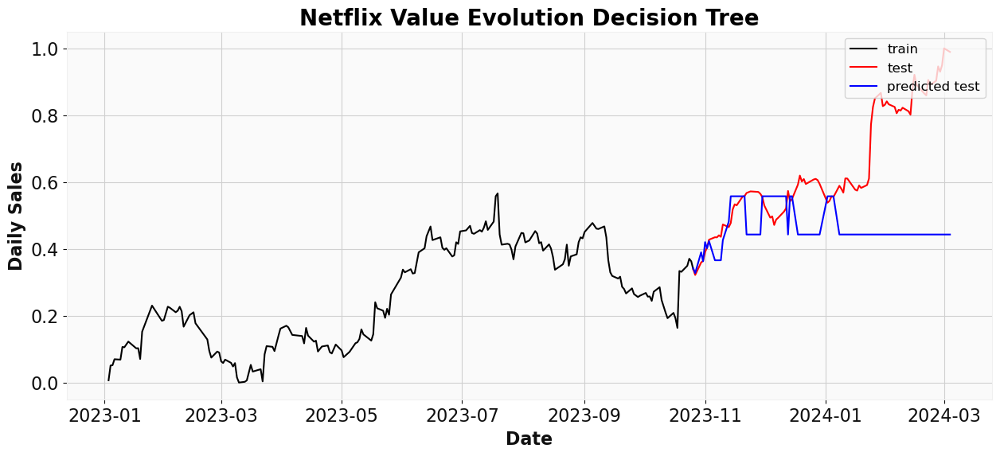

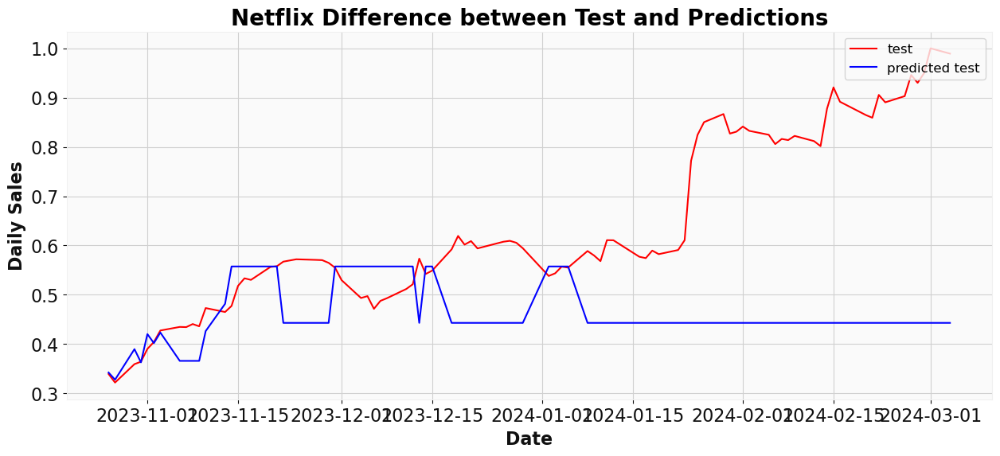

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.18917308308223948
Root Mean squared Error - RMSE : 0.25344618895829213
----------------------------------------------------------------------------------------------------


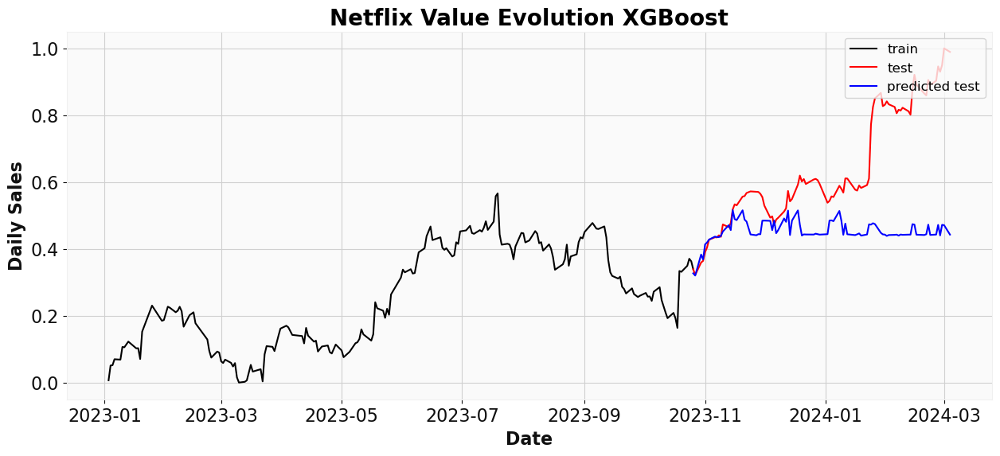

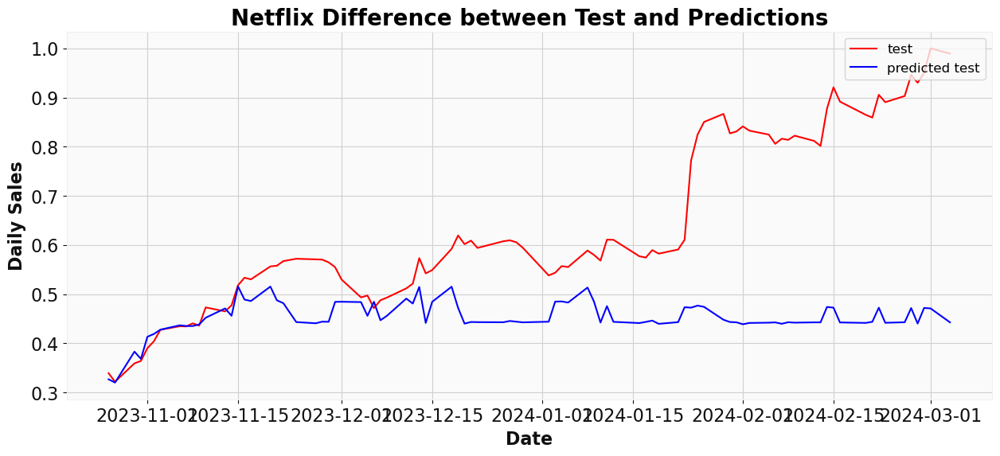

USING SPX500 DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15928649225770822
Root Mean squared Error - RMSE : 0.2072524082942926
----------------------------------------------------------------------------------------------------


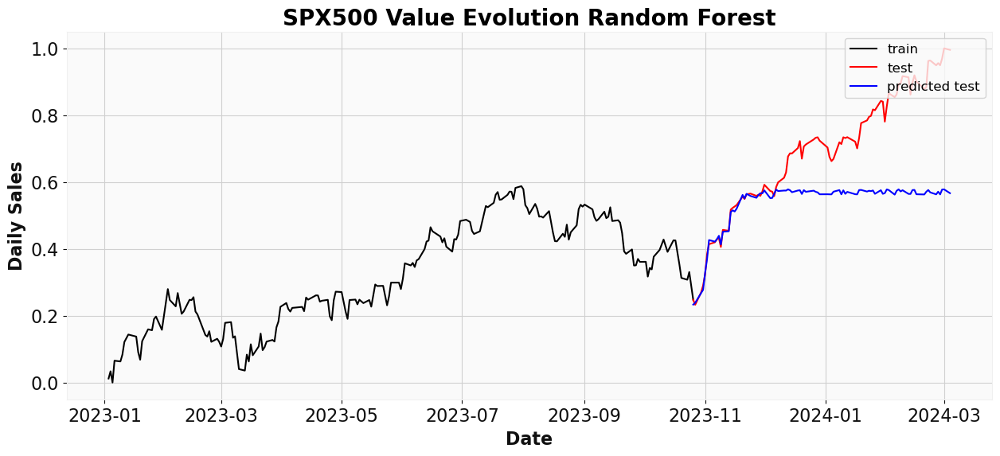

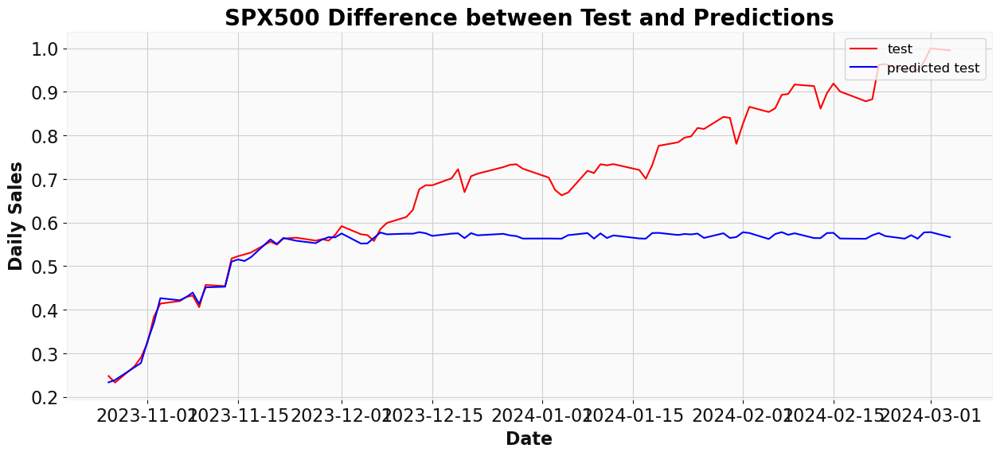

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.14921160722382829
Root Mean squared Error - RMSE : 0.19618840548053673
----------------------------------------------------------------------------------------------------


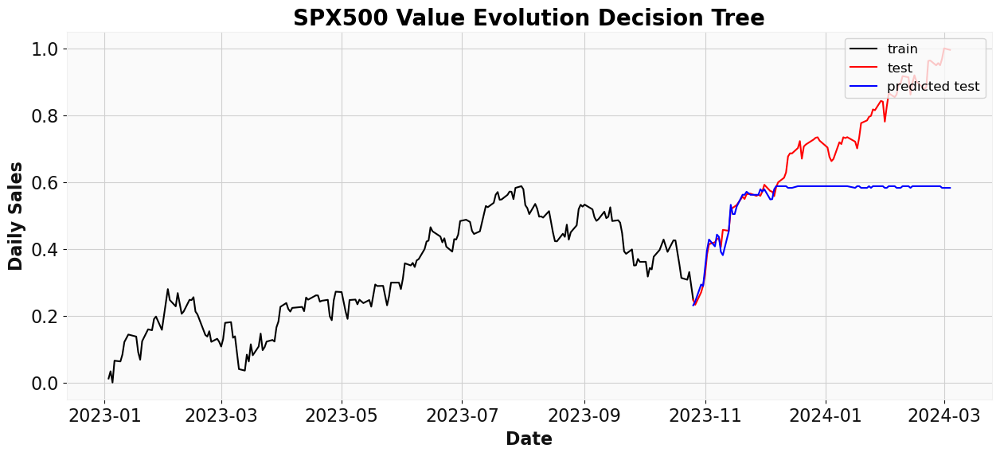

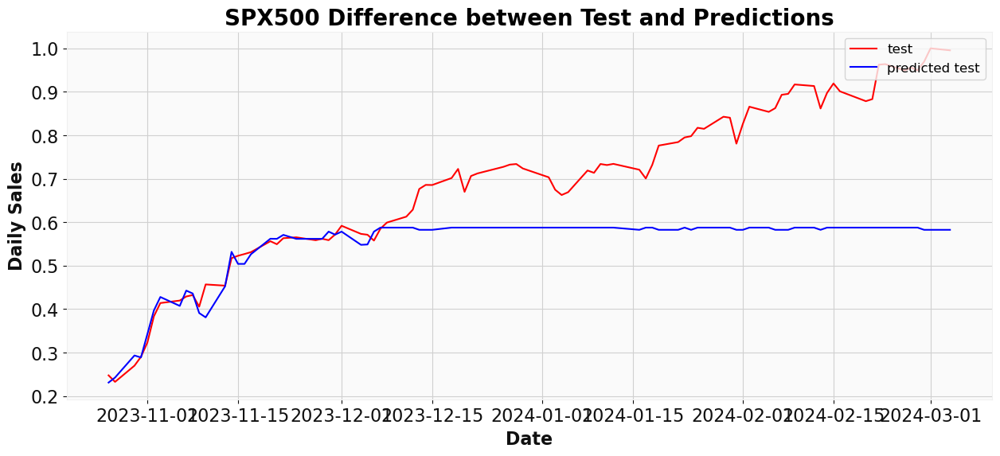

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15839976852202983
Root Mean squared Error - RMSE : 0.20499991961029215
----------------------------------------------------------------------------------------------------


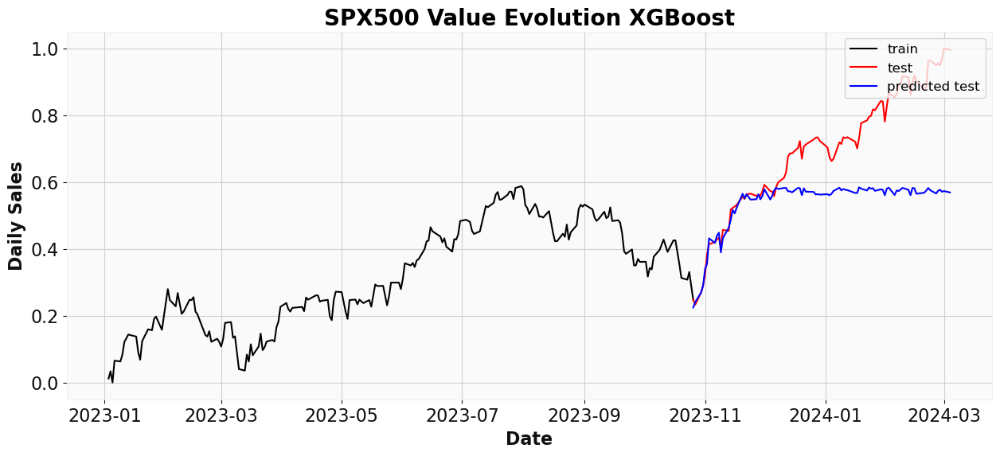

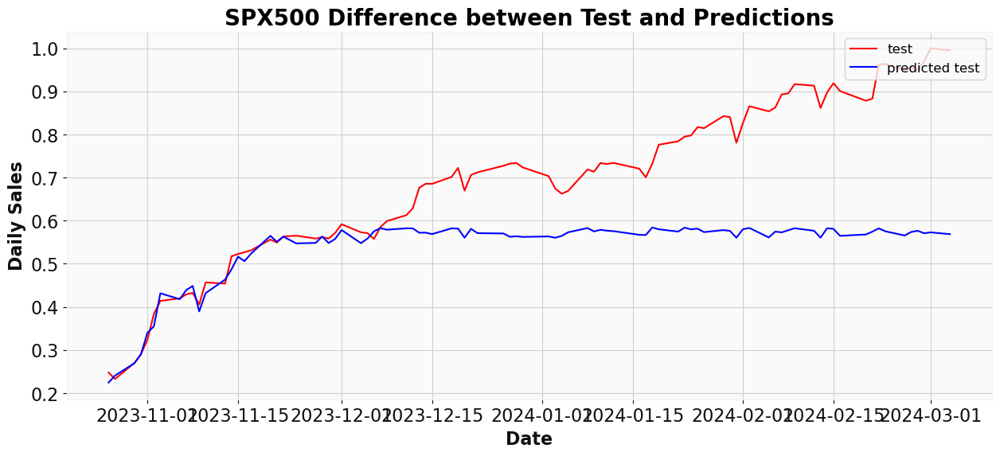

USING AMAZON DATASET
[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 5ms/step


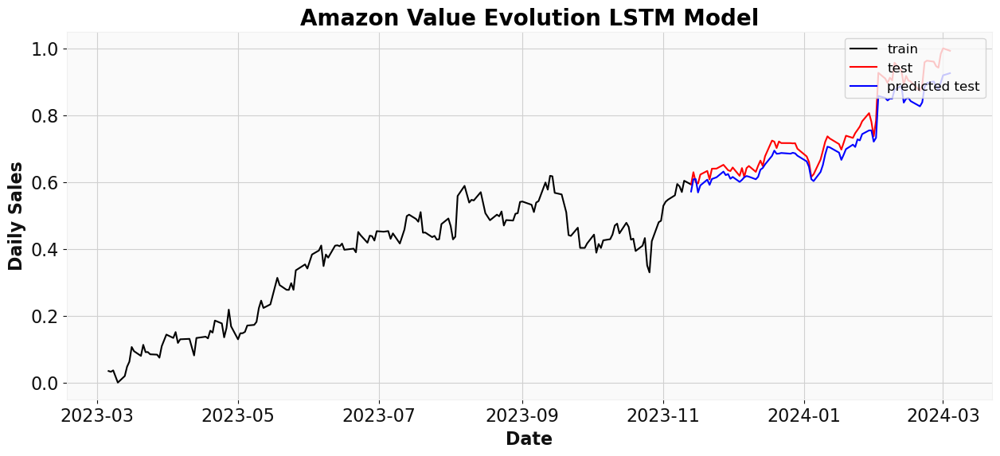

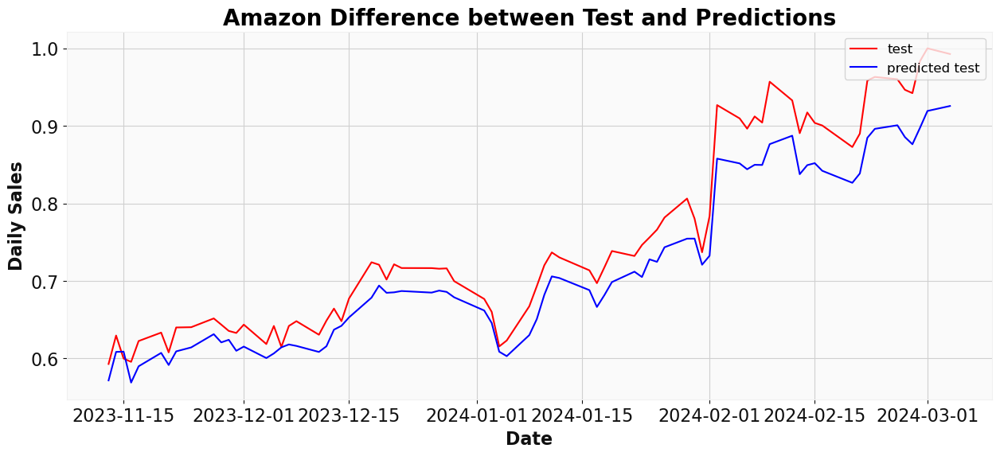

[STATUS] Calculating metrics...
MAE: 0.0432281546770178
RMSE: 0.05350511363217846
USING APPLE DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 6ms/step


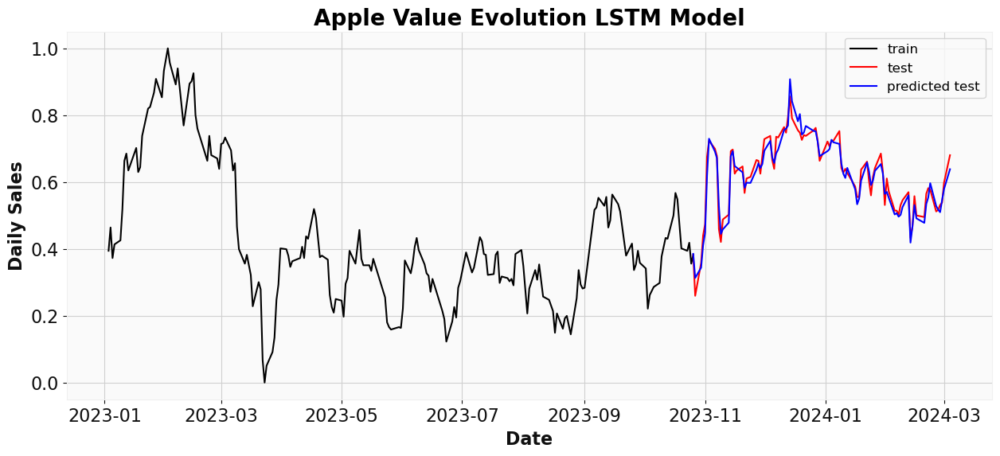

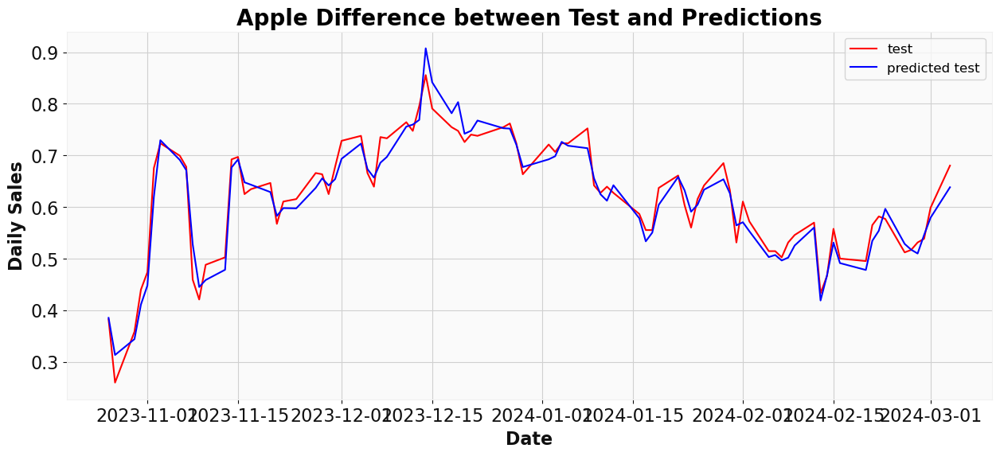

[STATUS] Calculating metrics...
MAE: 0.05117155624169569
RMSE: 0.06747217982331623
USING NETFLIX DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 6ms/step


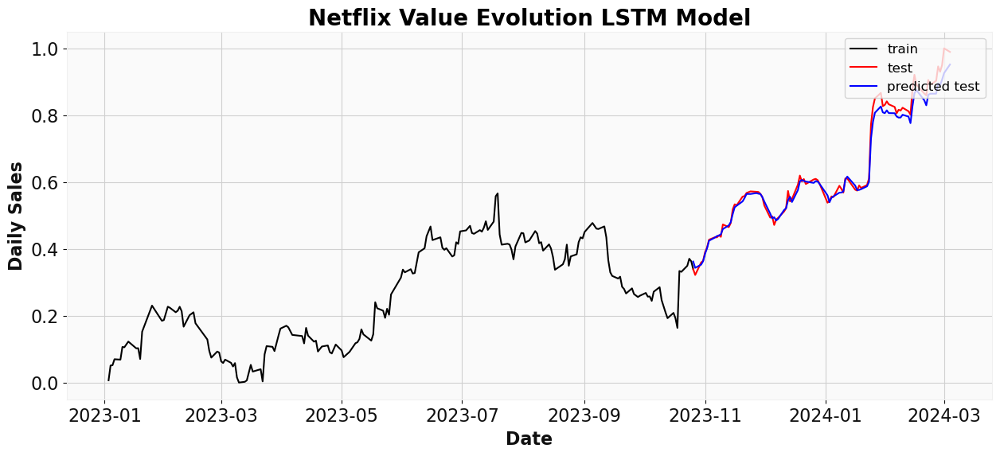

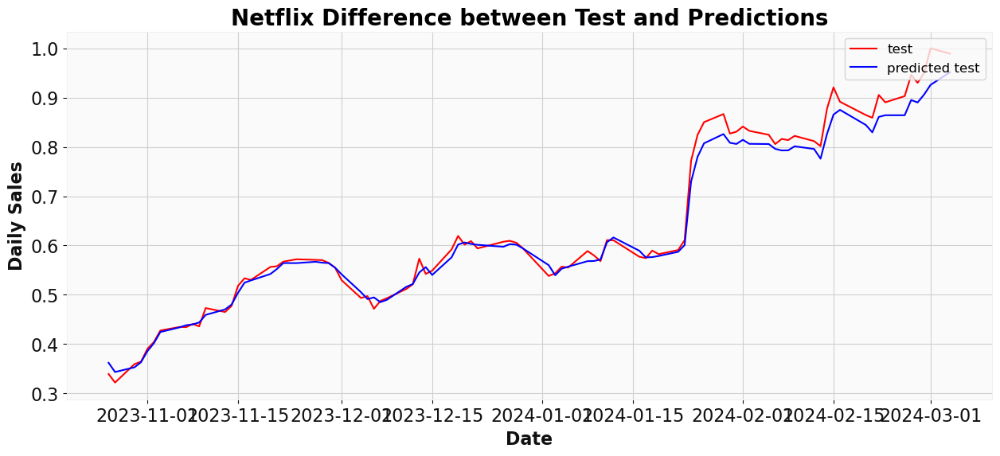

[STATUS] Calculating metrics...
MAE: 0.026181159842025844
RMSE: 0.03890640519388297
USING SPX500 DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 7ms/step


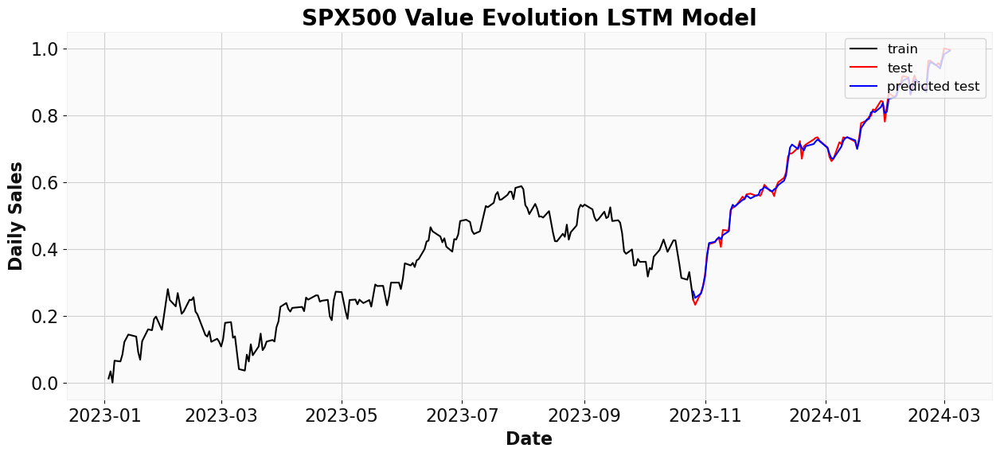

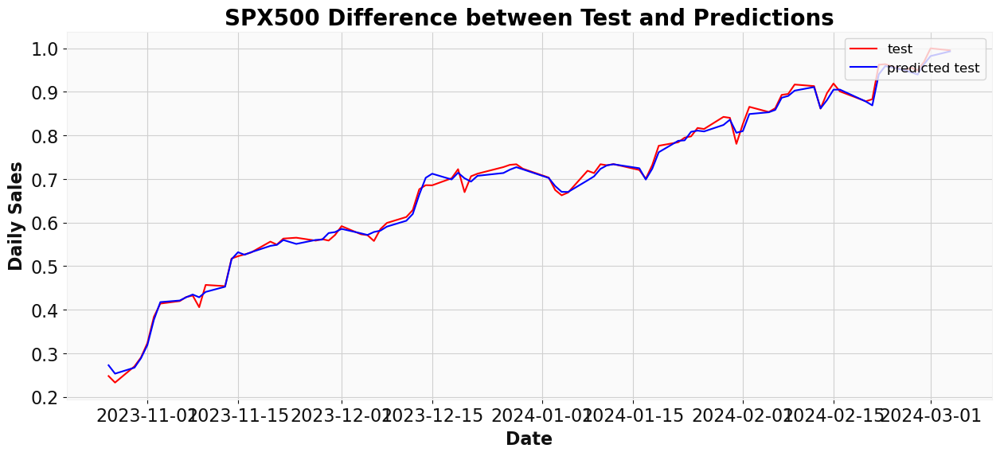

[STATUS] Calculating metrics...
MAE: 0.02099809677999167
RMSE: 0.027339865599482562


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


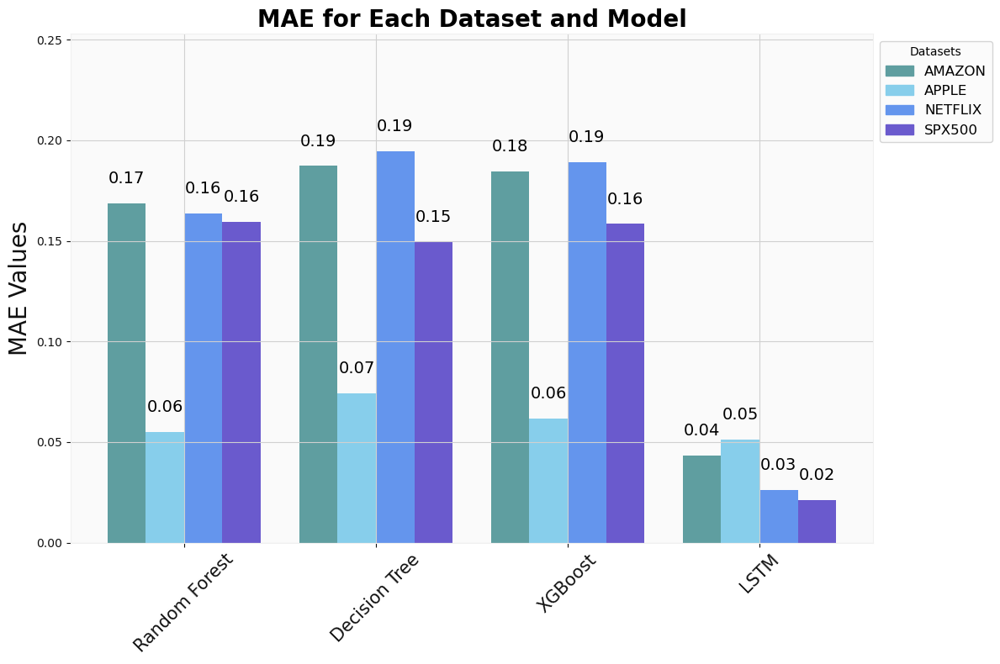

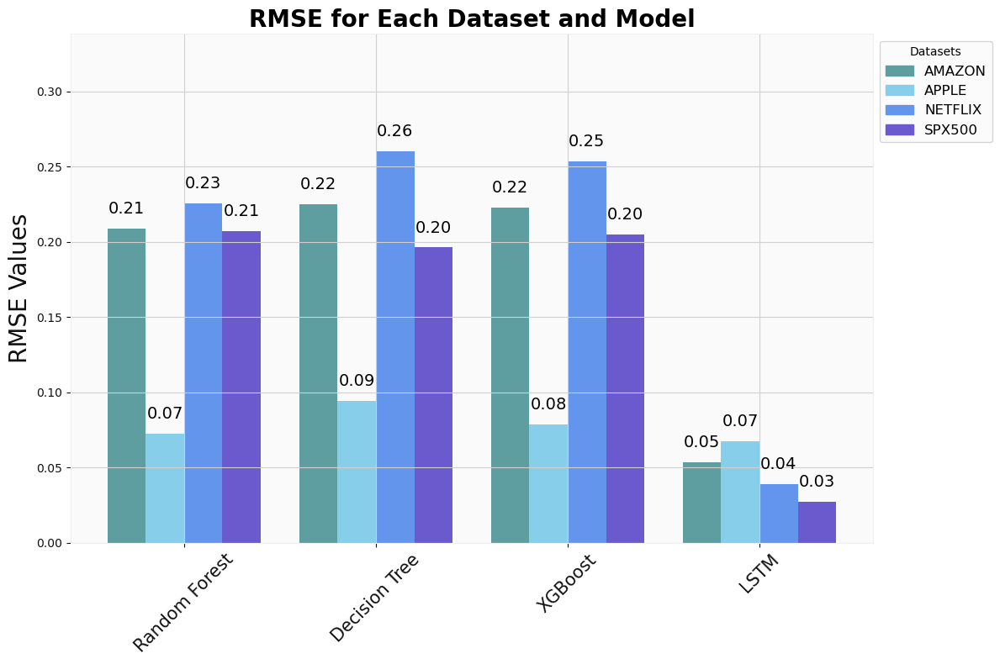

In [38]:
features = ['Open', 'Close', 'High', 'Low', 'Volume', 'Difference']
target = ['Next Close']

forecast(datasets, features, target, 'difference')

### Third approach

We've seen that the volume is never a good a important feature for any model. So, let's try to generate some new variables using that volume, and try to improve those predictions.

In financial analysis, data is mostly representated as a candle, where for each time frame we display the high, low, open and close variables. Below each candle is a barplot where the volume is shown.

Using VSA, we are going to classify each candle for his type, and we are going to analyse if this information is rellevant for futures predictions.

#### No Supply (NS) Candle

A NS candle is one with a smaller volume than the preceding two candles and has a downward movement. It typically signals a price reversal, leading to an upward movement in the following candle.

In [39]:
def mark_no_supply_candles(Dataset):
    ns_list = [0, 0]
        
    for index in range(len(Dataset.dataset)):
        if index < 2:  # No cal processar les dues primeres files
            continue
            
        row = Dataset.dataset.iloc[index]
        
        if row['Open'] > row['Close']:
            volume_t_2 = Dataset.dataset.iloc[index-2]['Volume']
            volume_t_1 = Dataset.dataset.iloc[index-1]['Volume']
            volume_t = row['Volume']
            
            if volume_t_2 > volume_t and volume_t_1 > volume_t:
                ns_list.append(1)
            
            else:
                ns_list.append(0)
        
        else:
            ns_list.append(0)
        
        
    Dataset.dataset['NS'] = ns_list
    
    return Dataset     

In [40]:
AMAZON2 = mark_no_supply_candles(AMAZON2)
APPLE2 = mark_no_supply_candles(APPLE2)
NETFLIX2 = mark_no_supply_candles(NETFLIX2)
SPX5002 = mark_no_supply_candles(SPX5002)

USING AMAZON DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.16819195640797768
Root Mean squared Error - RMSE : 0.20810728389836258
----------------------------------------------------------------------------------------------------


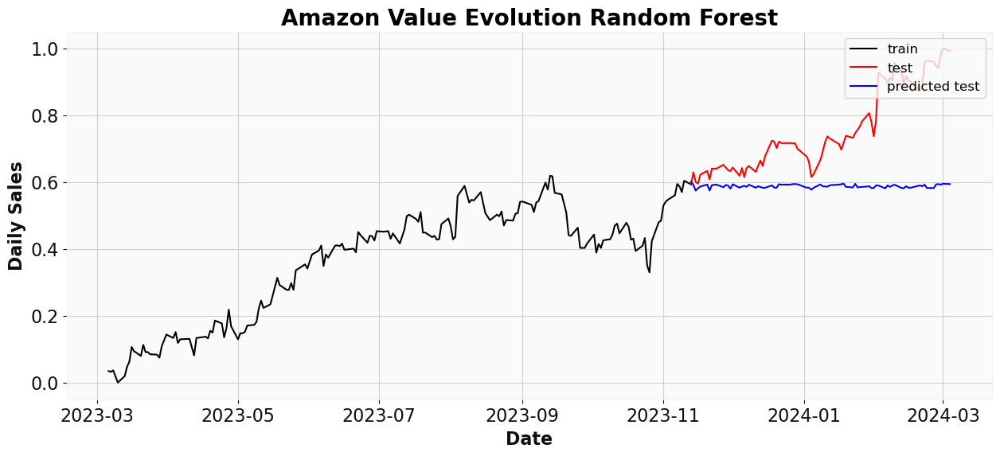

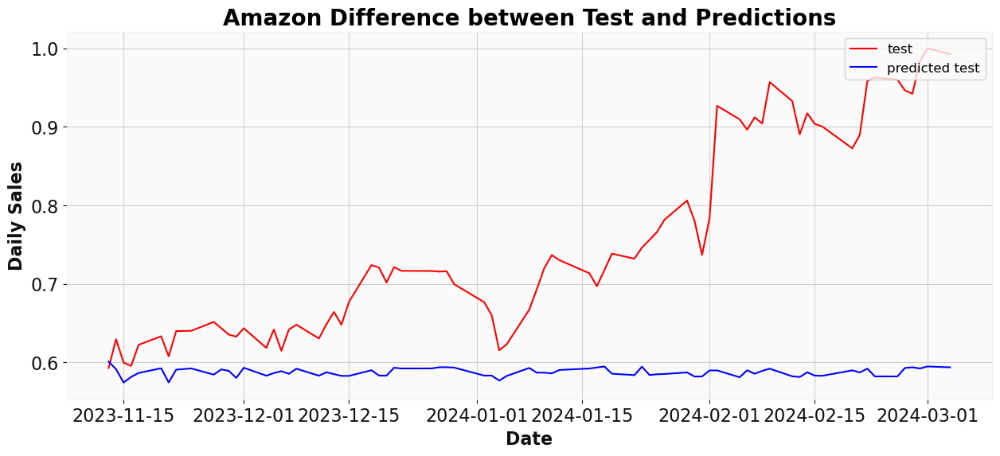

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.18681682859938256
Root Mean squared Error - RMSE : 0.22427774042448922
----------------------------------------------------------------------------------------------------


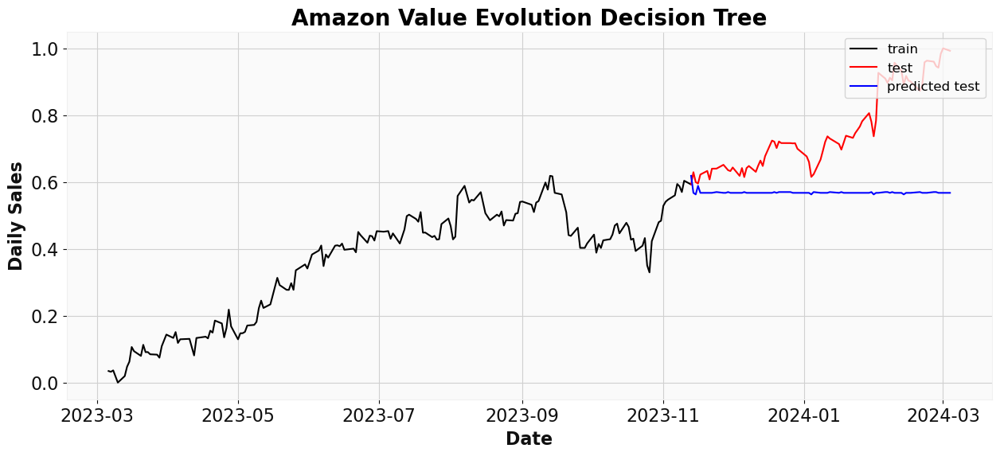

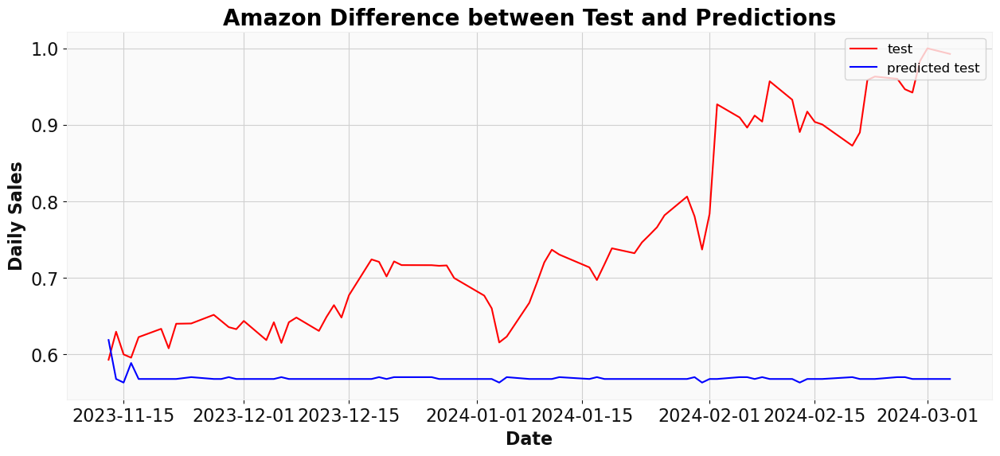

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.18361276769930307
Root Mean squared Error - RMSE : 0.22190173515219808
----------------------------------------------------------------------------------------------------


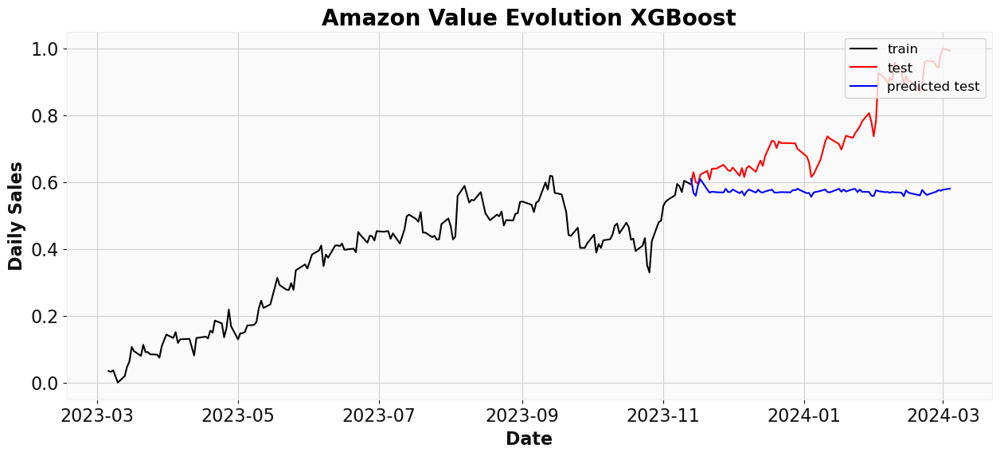

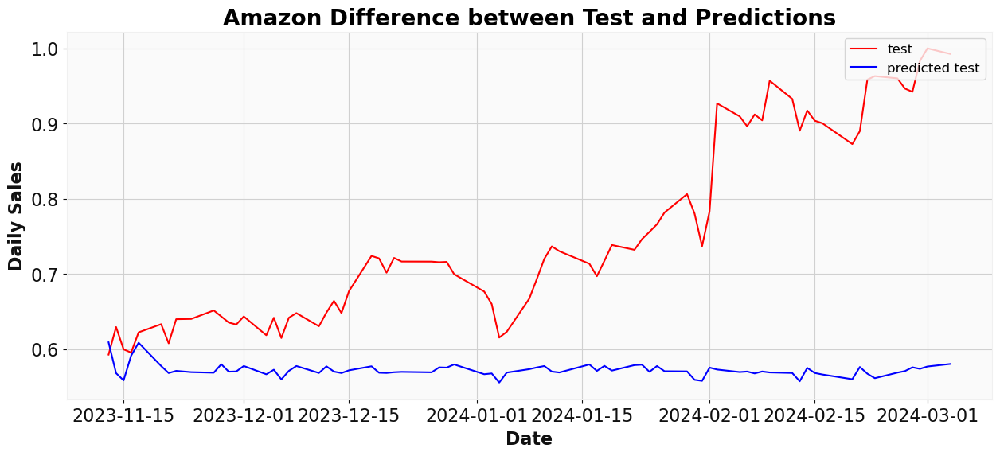

USING APPLE DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.055751500936953864
Root Mean squared Error - RMSE : 0.07294397574907362
----------------------------------------------------------------------------------------------------


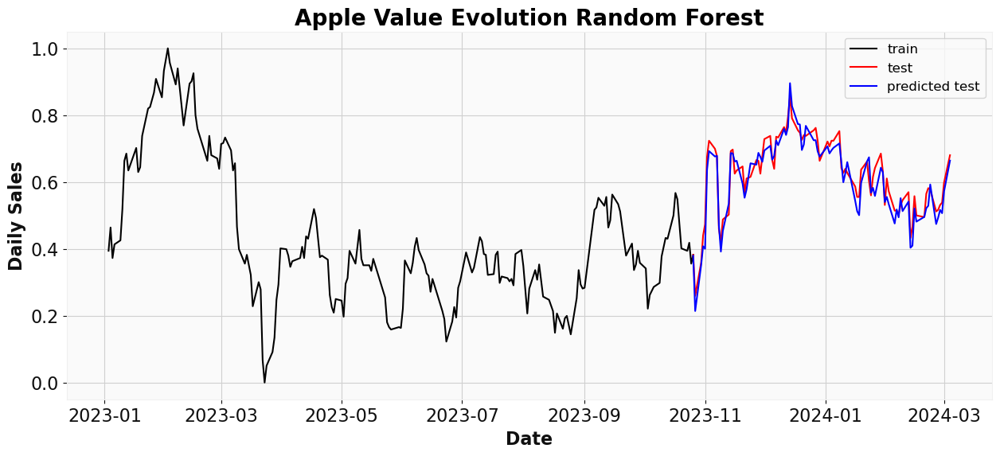

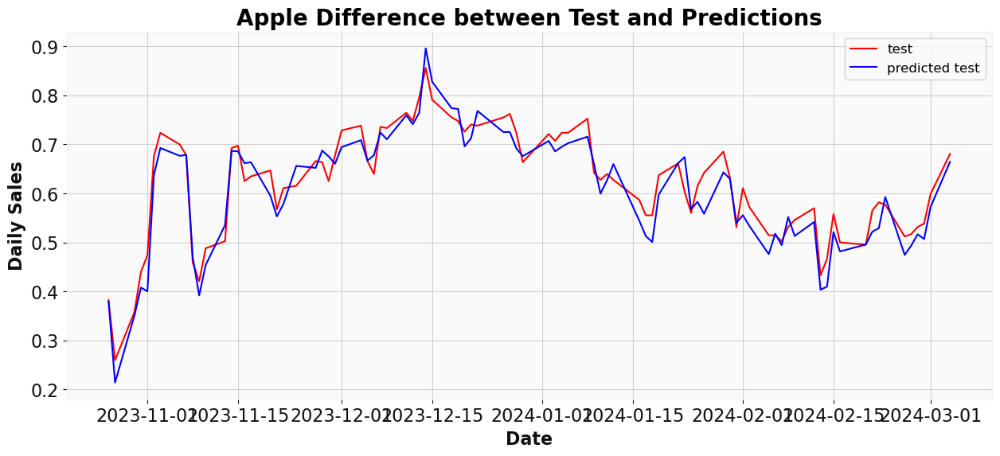

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.0755026333041958
Root Mean squared Error - RMSE : 0.09475463849369725
----------------------------------------------------------------------------------------------------


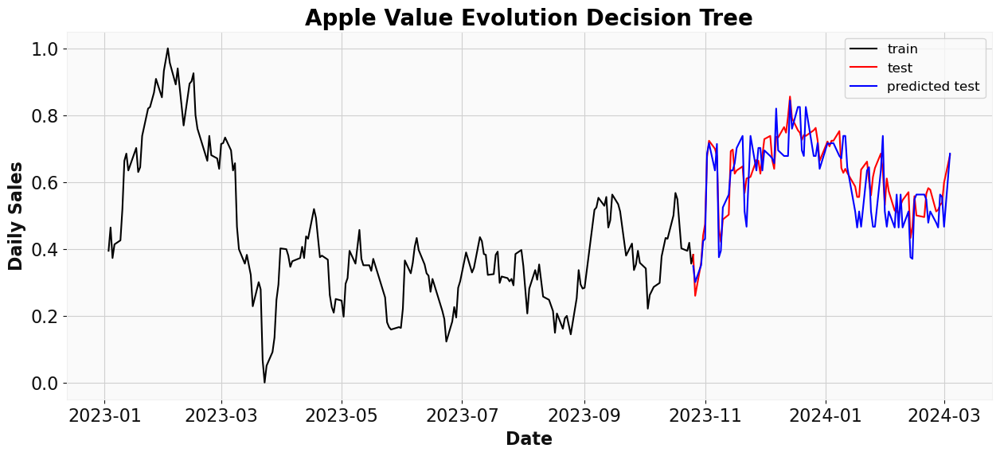

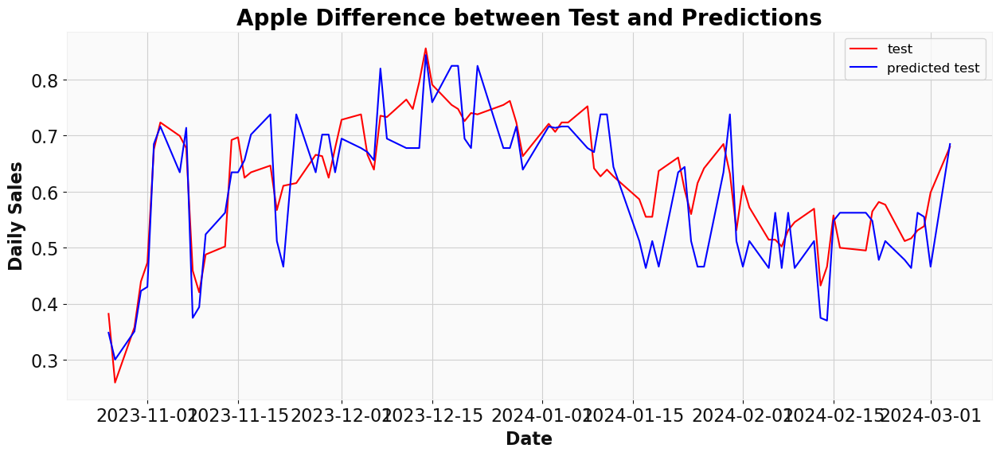

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.05987050012685612
Root Mean squared Error - RMSE : 0.07696423752464183
----------------------------------------------------------------------------------------------------


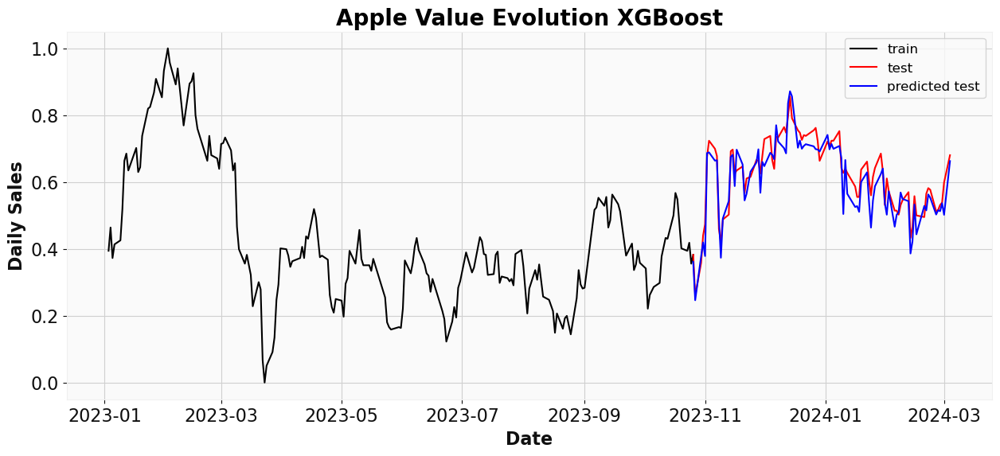

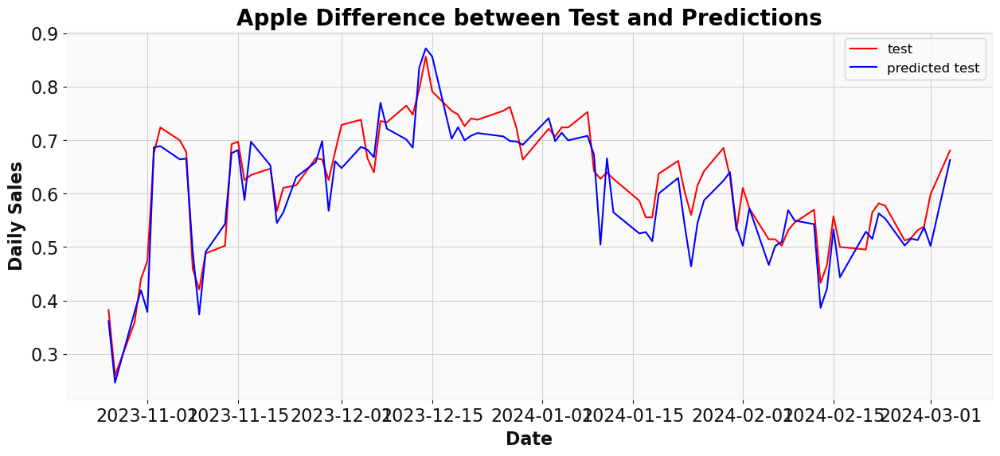

USING NETFLIX DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.16293098917198603
Root Mean squared Error - RMSE : 0.22484338191879905
----------------------------------------------------------------------------------------------------


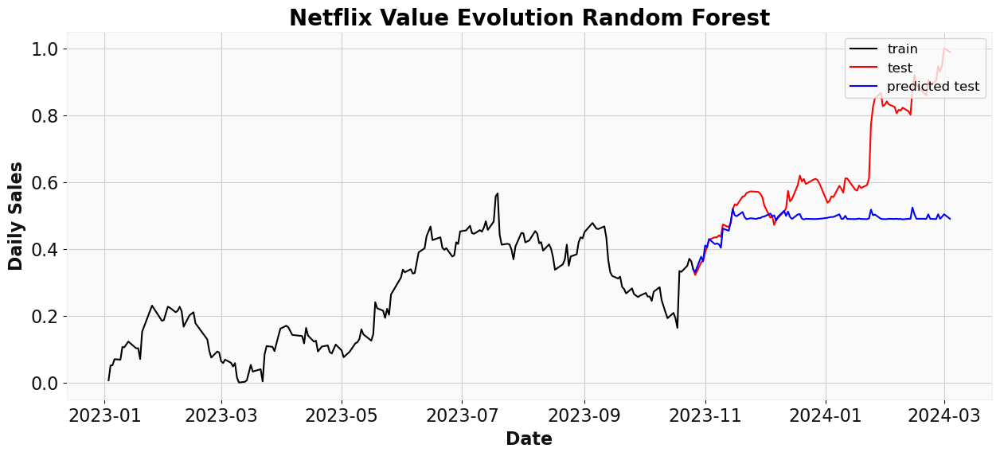

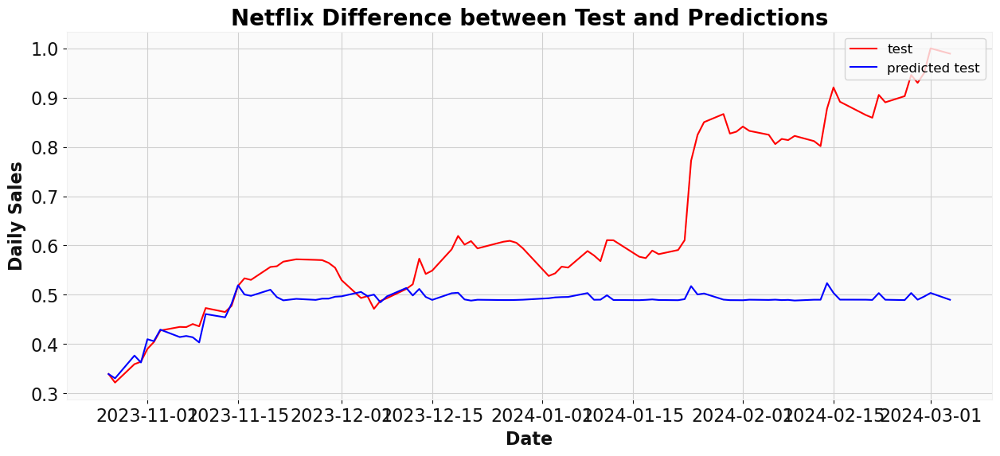

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.12621333709076046
Root Mean squared Error - RMSE : 0.18699728102552202
----------------------------------------------------------------------------------------------------


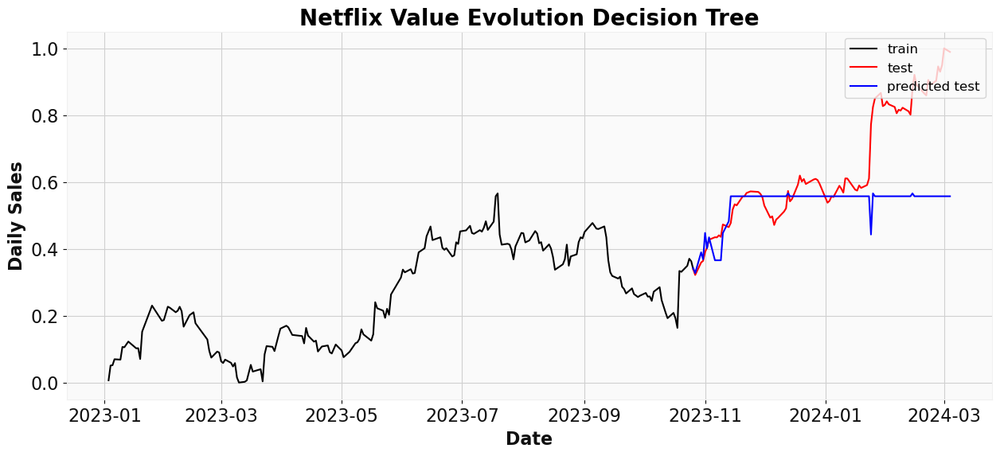

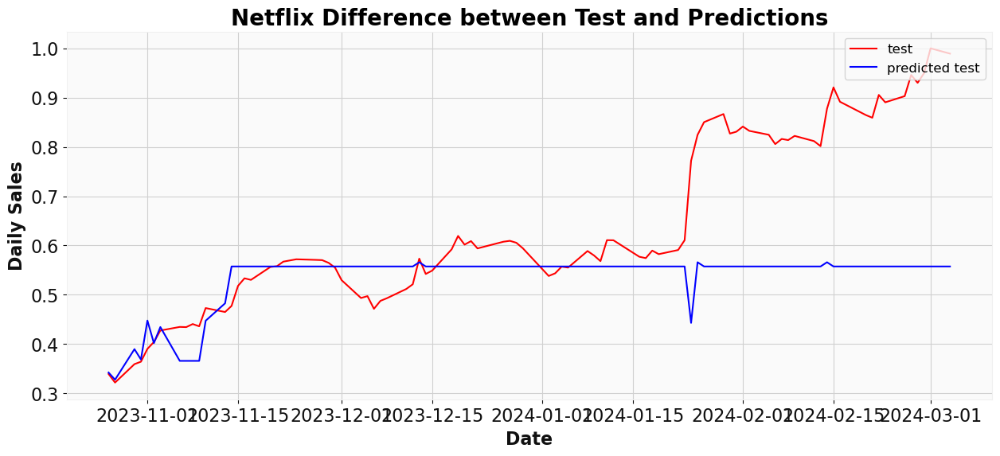

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.18661241444349752
Root Mean squared Error - RMSE : 0.2509499216910019
----------------------------------------------------------------------------------------------------


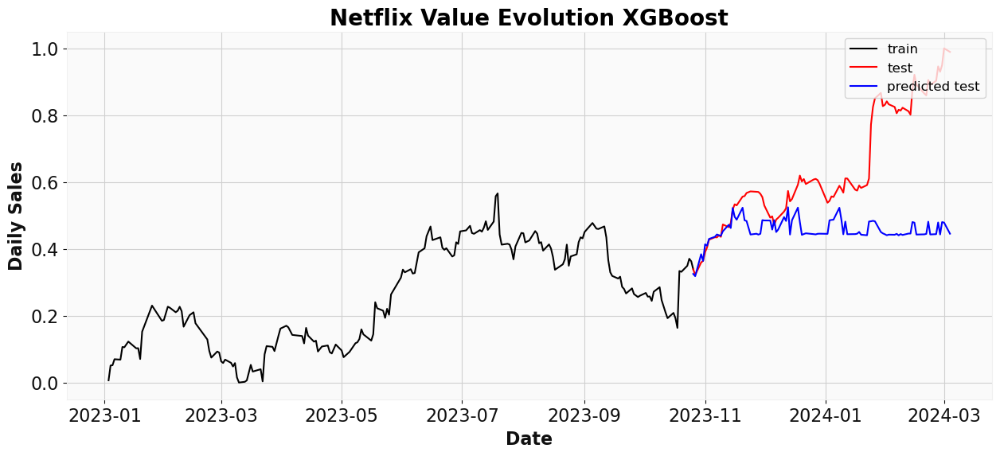

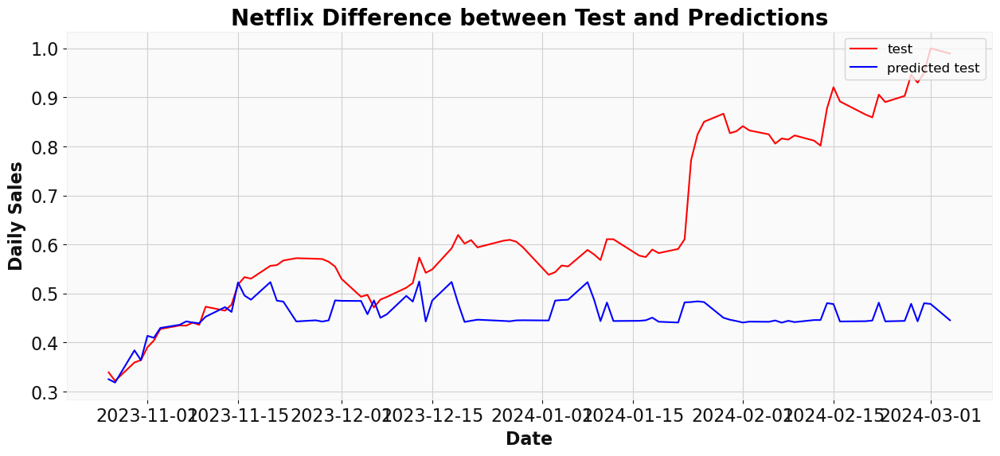

USING SPX500 DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.16030891999192642
Root Mean squared Error - RMSE : 0.20841245505916078
----------------------------------------------------------------------------------------------------


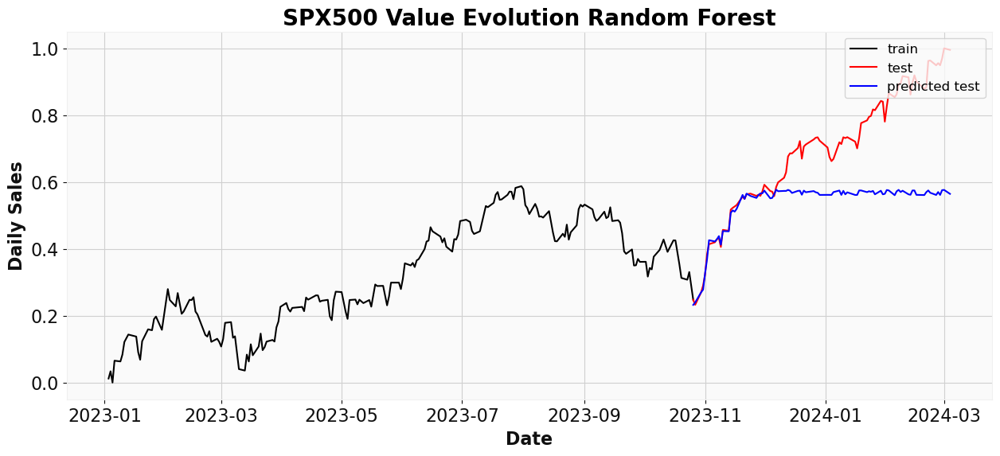

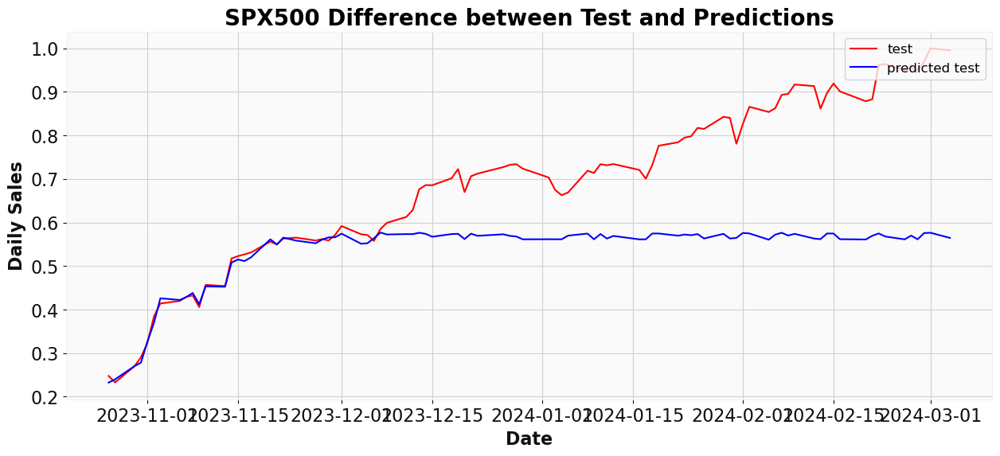

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.14994483340011036
Root Mean squared Error - RMSE : 0.19713522088495106
----------------------------------------------------------------------------------------------------


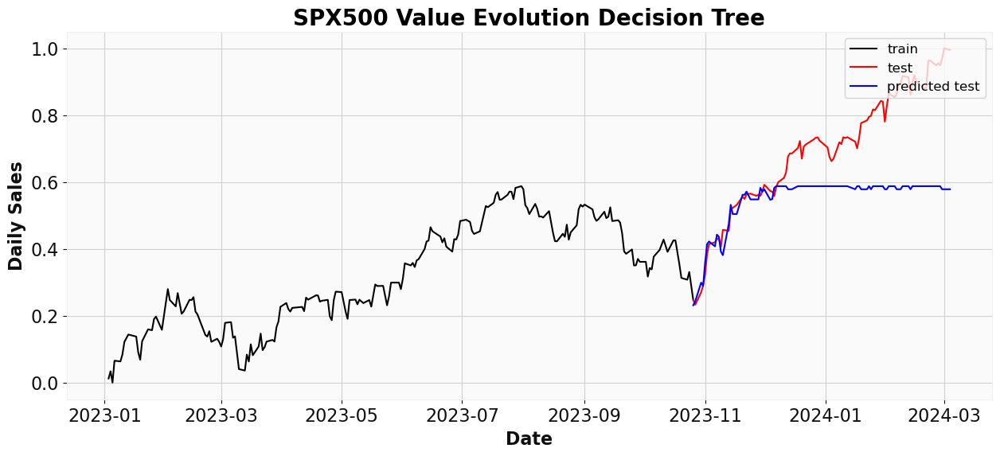

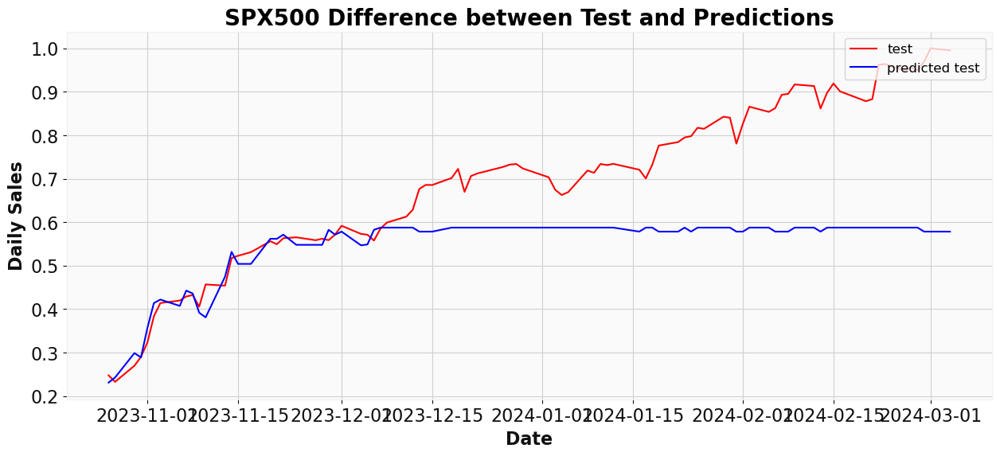

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15736935533204832
Root Mean squared Error - RMSE : 0.2037089653754454
----------------------------------------------------------------------------------------------------


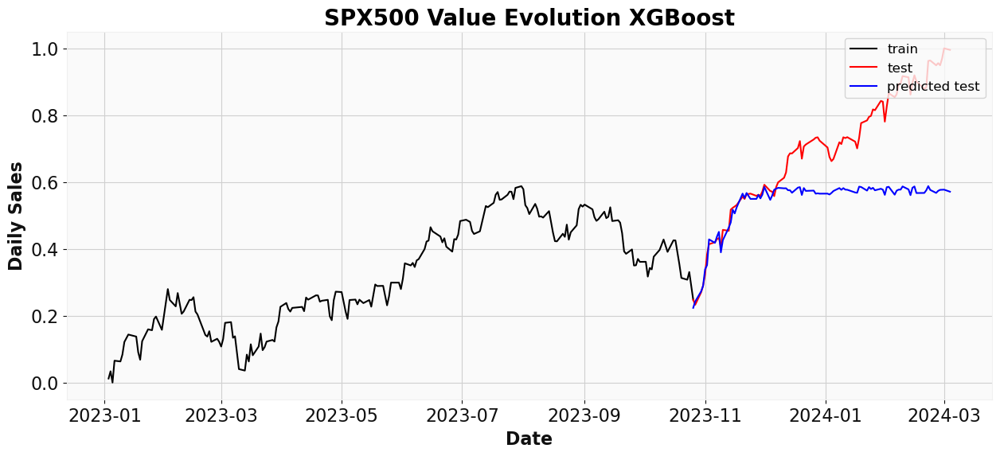

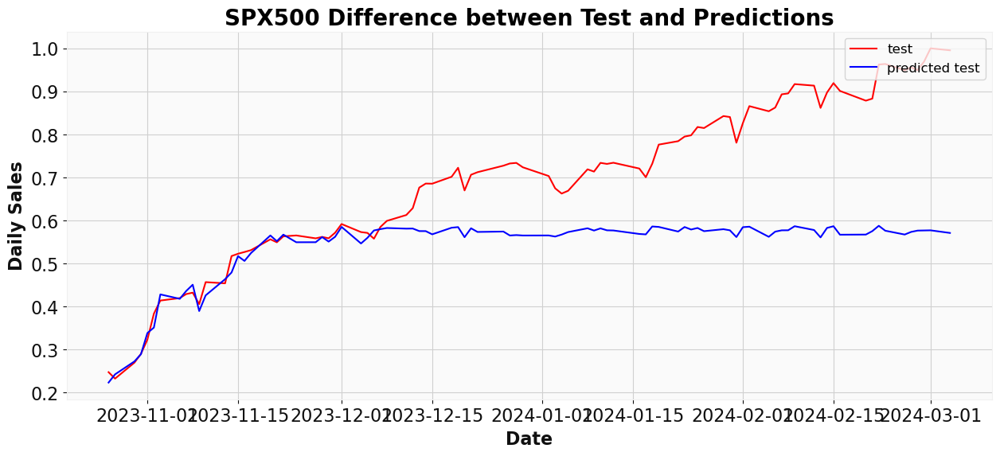

USING AMAZON DATASET
[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 4ms/step


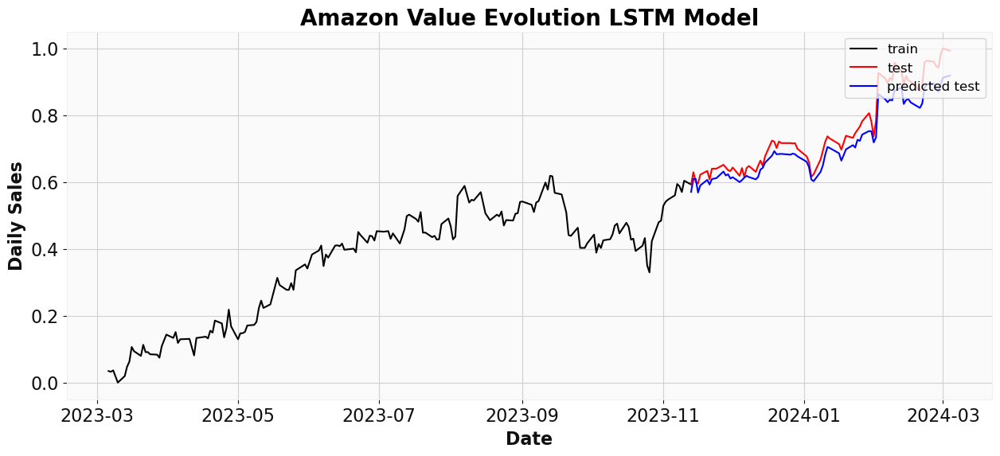

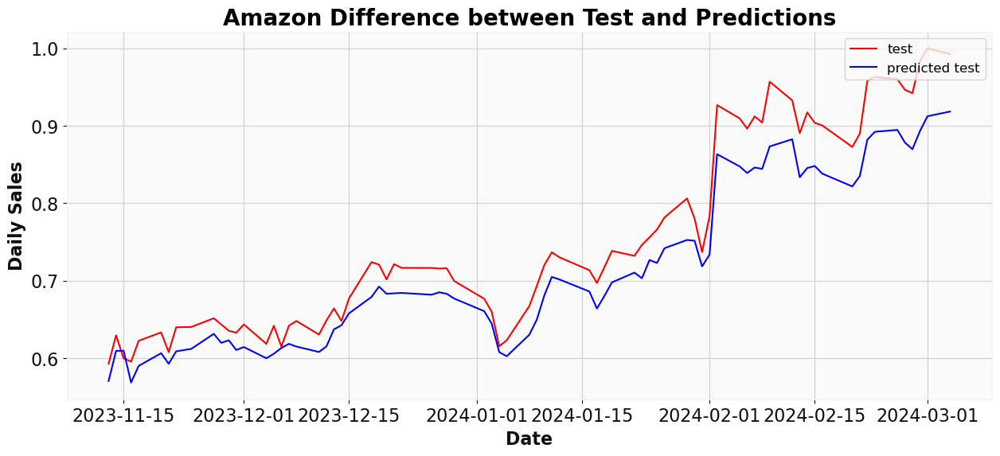

[STATUS] Calculating metrics...
MAE: 0.04484160143343091
RMSE: 0.055155174389774915
USING APPLE DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 5ms/step


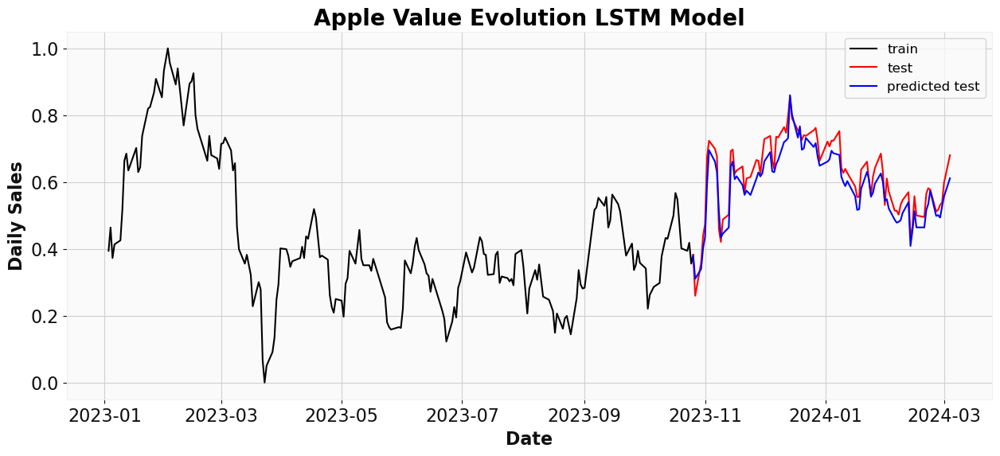

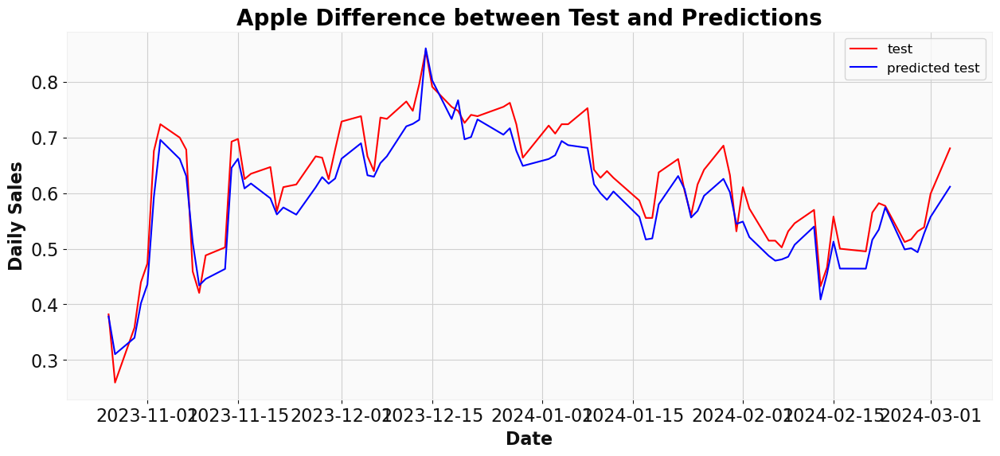

[STATUS] Calculating metrics...
MAE: 0.05815335207956647
RMSE: 0.07279324890891758
USING NETFLIX DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 6ms/step


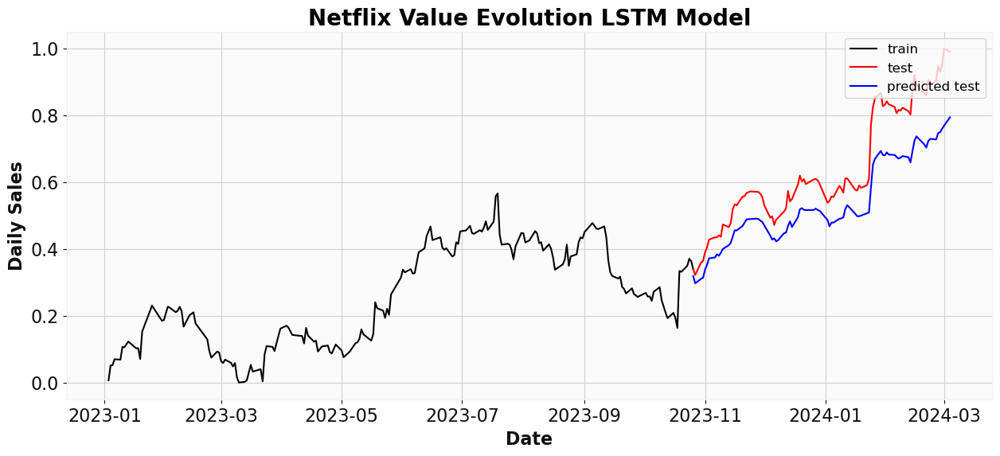

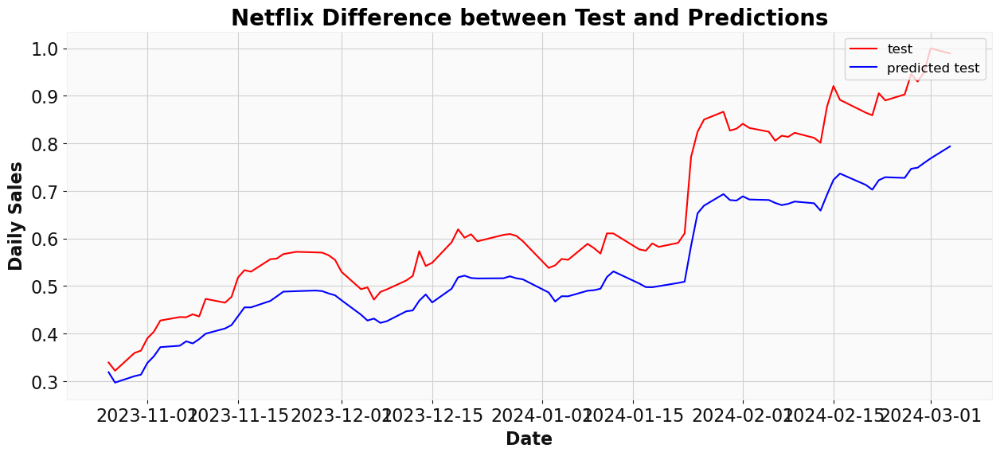

[STATUS] Calculating metrics...
MAE: 0.10925630099359179
RMSE: 0.1223863880900994
USING SPX500 DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 6ms/step


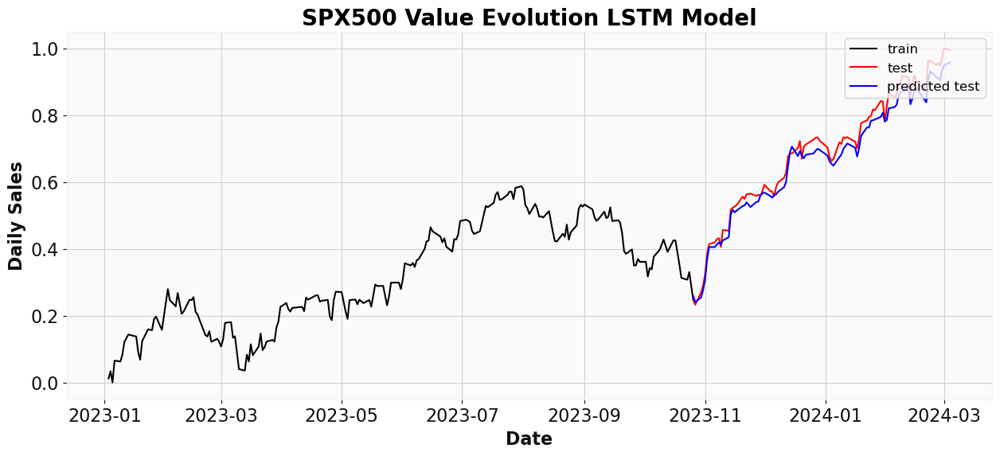

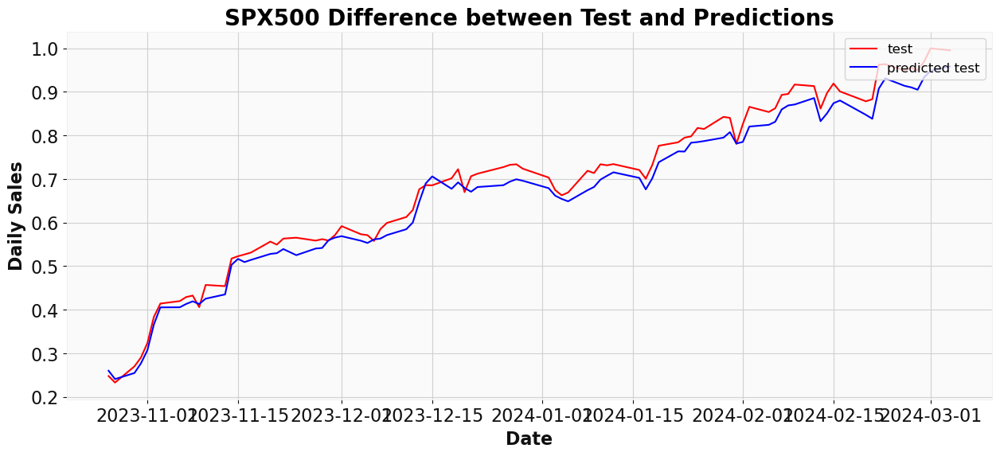

[STATUS] Calculating metrics...
MAE: 0.03536720602169008
RMSE: 0.0417088749584392


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


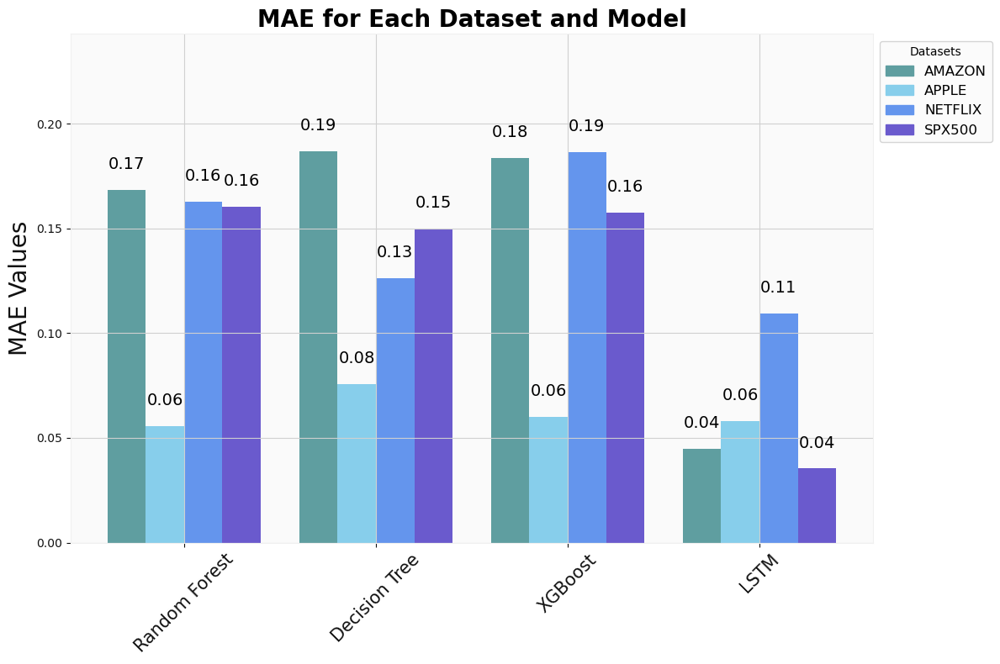

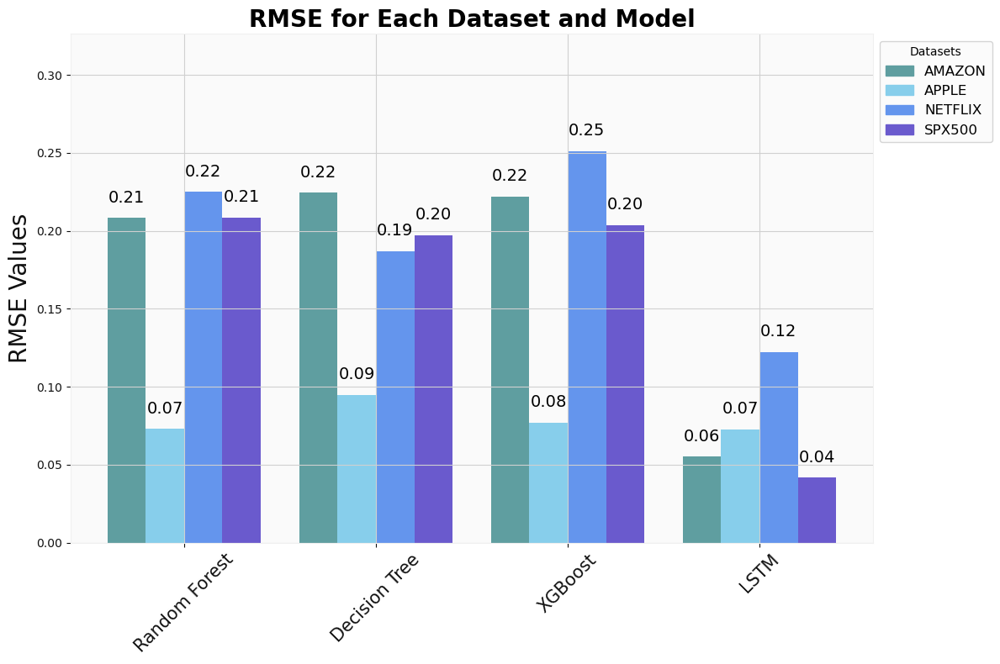

In [41]:
features = ['Open', 'Close', 'High', 'Low', 'Volume', 'Difference', 'NS']
target = ['Next Close']

forecast(datasets, features, target, 'ns')

#### No Demand (ND) Candle

A No Demand (ND) Candle is an up bar with less volume that the two previous ones. From this candle we know the close value will decay for sure.

In [42]:
def mark_no_demand_candles(Dataset):
    nd_list = [0, 0]
    
    for index in range(len(Dataset.dataset)):
        if index < 2:
            continue
        
        row = Dataset.dataset.iloc[index]
        
        if row['Open'] < row['Close']:
            volume_t_2 = Dataset.dataset.iloc[index-2]['Volume']
            volume_t_1 = Dataset.dataset.iloc[index-1]['Volume']
            volume_t = row['Volume']
            
            if volume_t_2 > volume_t and volume_t_1 > volume_t:
                nd_list.append(1)
            
            else:
                nd_list.append(0)
        
        else:
            nd_list.append(0)
            
    Dataset.dataset['ND'] = nd_list
    
    return Dataset

In [43]:
AMAZON2 = mark_no_demand_candles(AMAZON2)
APLLE2 = mark_no_demand_candles(APPLE2)
NETFLIX2 = mark_no_demand_candles(NETFLIX2)
SPX5002 = mark_no_demand_candles(SPX5002)

USING AMAZON DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.16932621103548515
Root Mean squared Error - RMSE : 0.20909704609959207
----------------------------------------------------------------------------------------------------


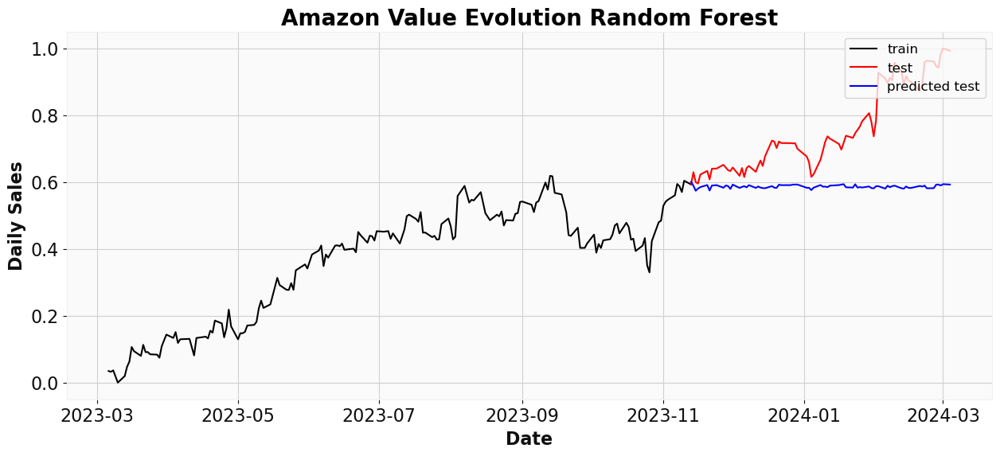

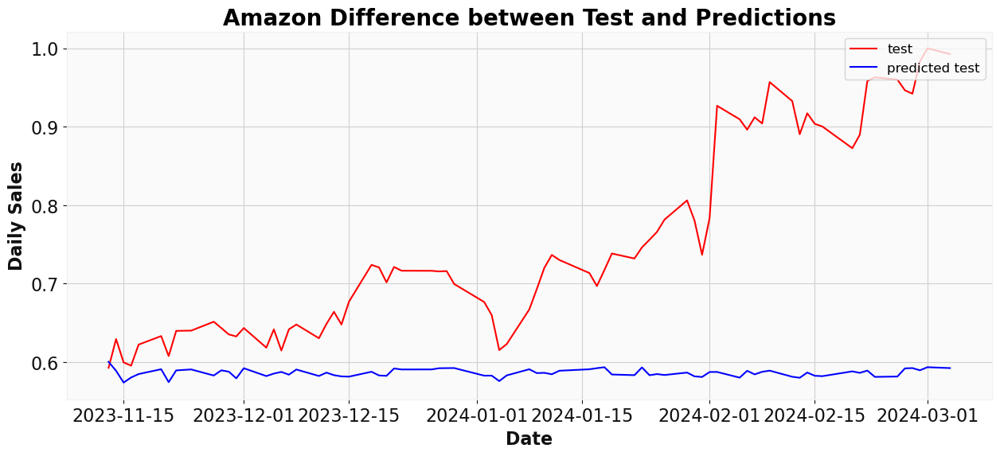

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.1873432212517777
Root Mean squared Error - RMSE : 0.22476132127260512
----------------------------------------------------------------------------------------------------


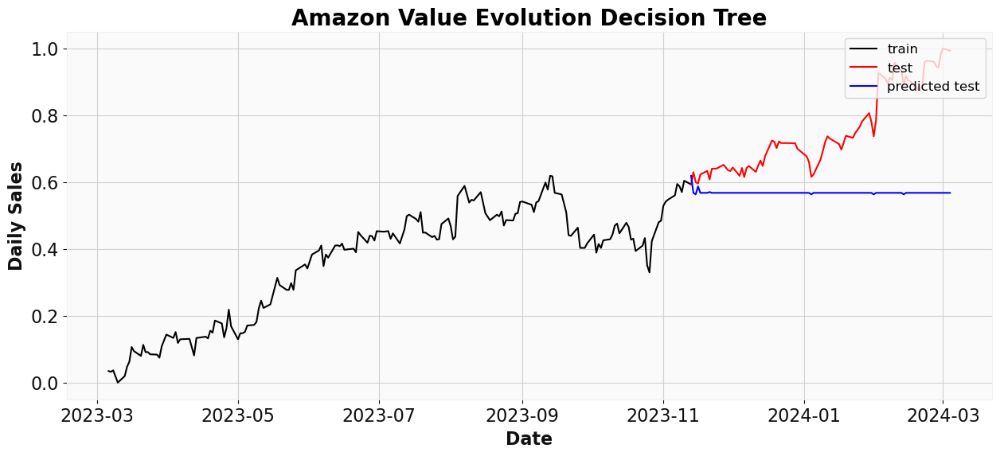

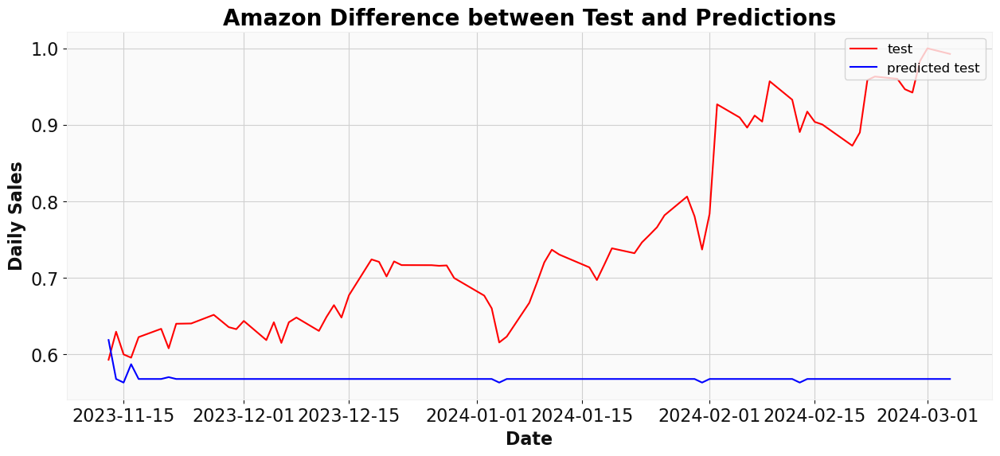

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.18318621568595606
Root Mean squared Error - RMSE : 0.22140905805763633
----------------------------------------------------------------------------------------------------


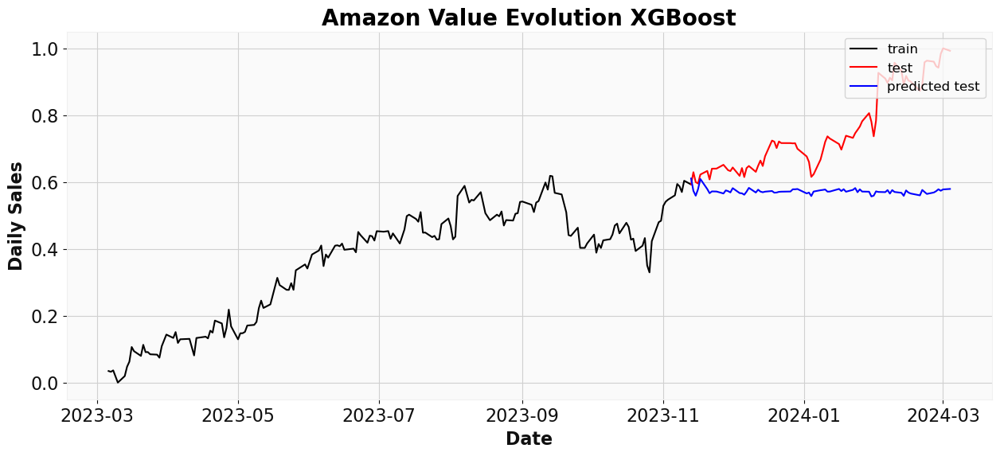

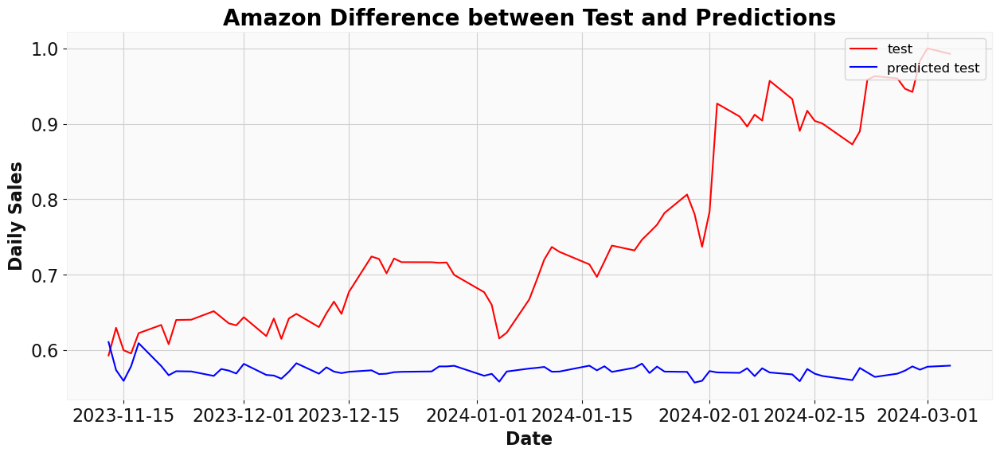

USING APPLE DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.05543256514423063
Root Mean squared Error - RMSE : 0.07283000087767738
----------------------------------------------------------------------------------------------------


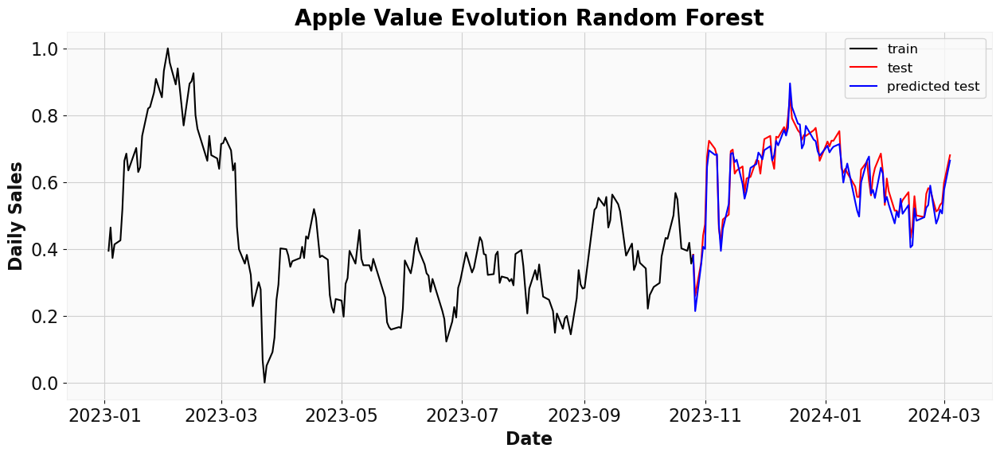

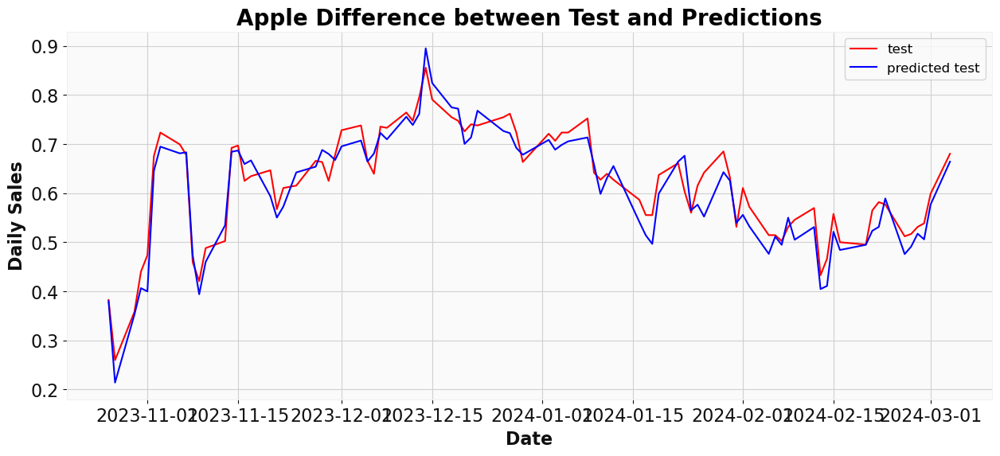

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.08703016826923071
Root Mean squared Error - RMSE : 0.10978610386441554
----------------------------------------------------------------------------------------------------


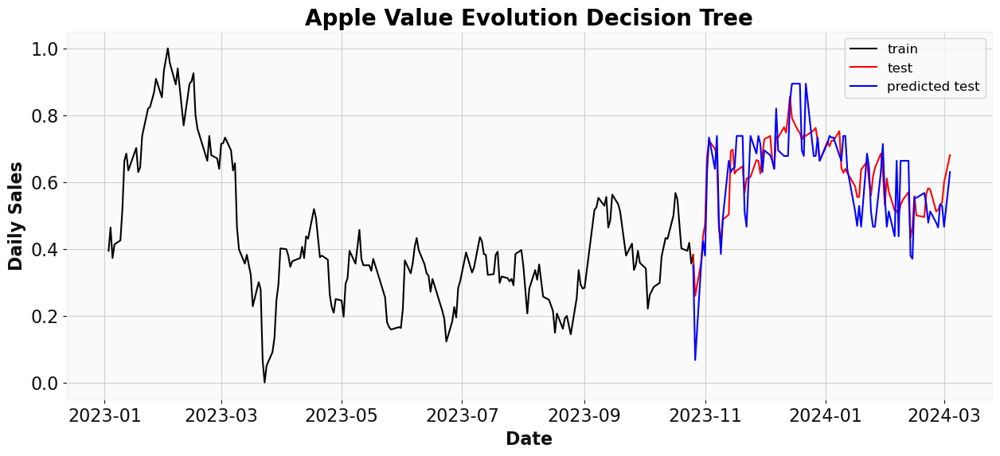

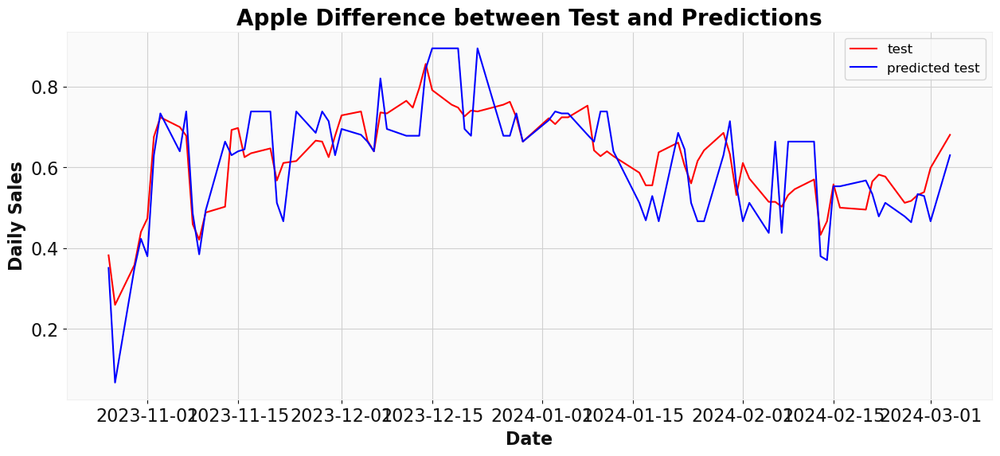

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.05974304923911188
Root Mean squared Error - RMSE : 0.07747210672776804
----------------------------------------------------------------------------------------------------


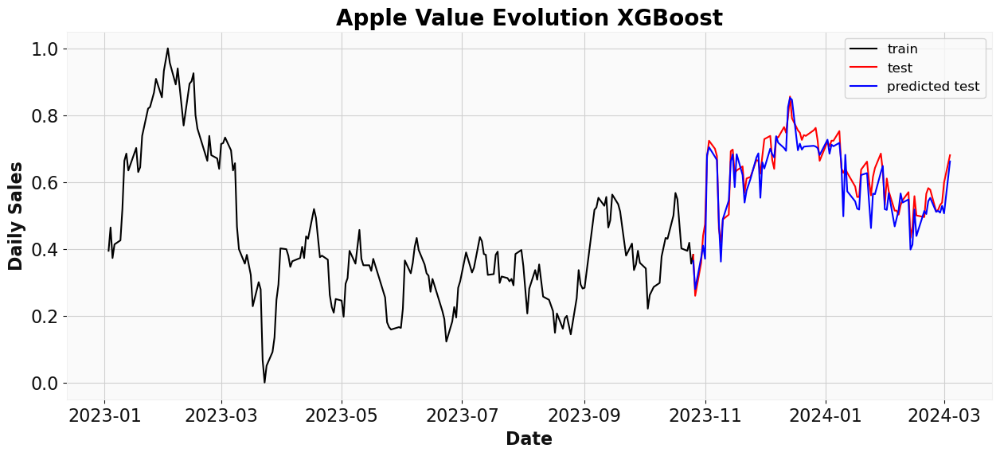

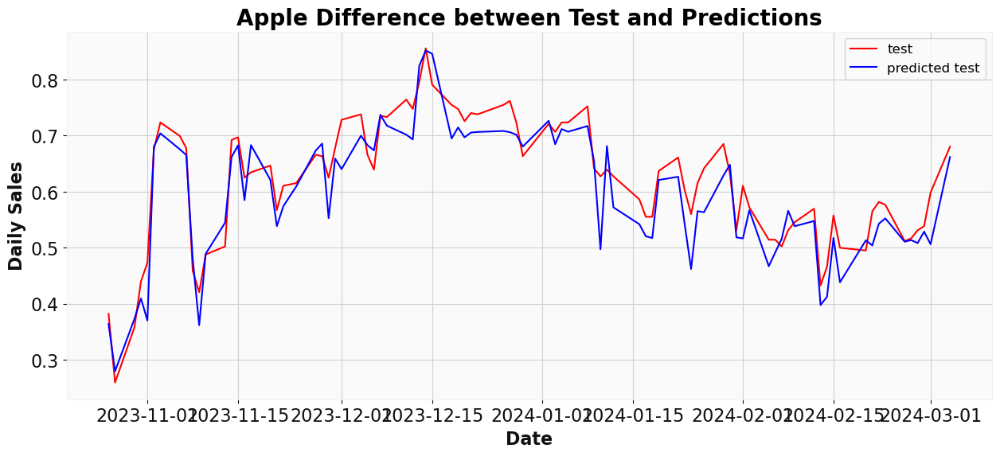

USING NETFLIX DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.16237528867932288
Root Mean squared Error - RMSE : 0.22421855605581084
----------------------------------------------------------------------------------------------------


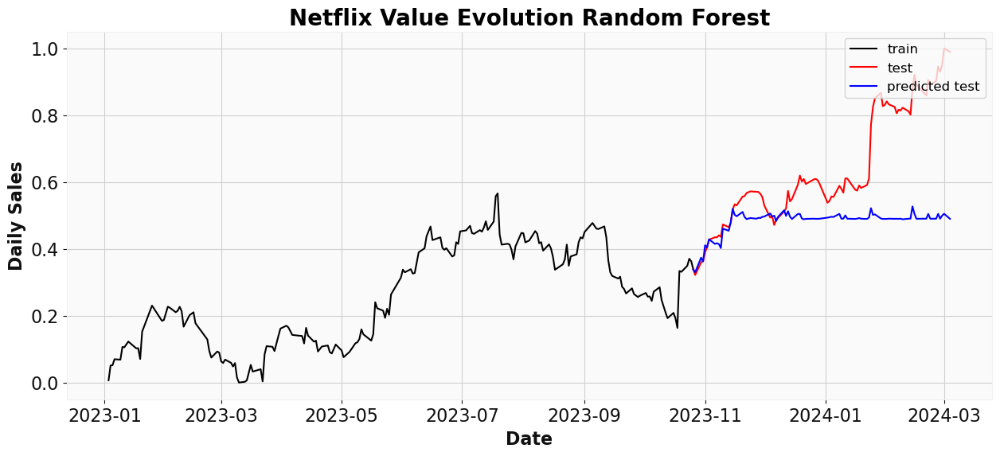

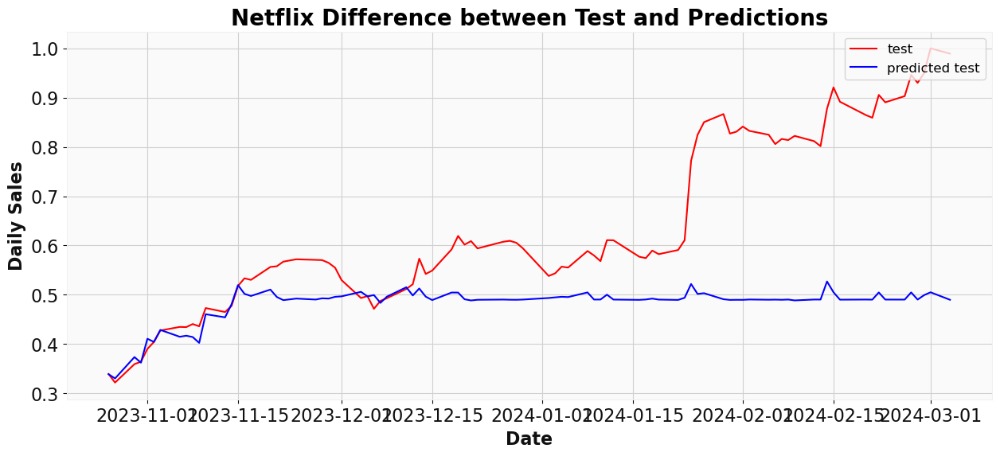

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.20664742673573827
Root Mean squared Error - RMSE : 0.2631596777804639
----------------------------------------------------------------------------------------------------


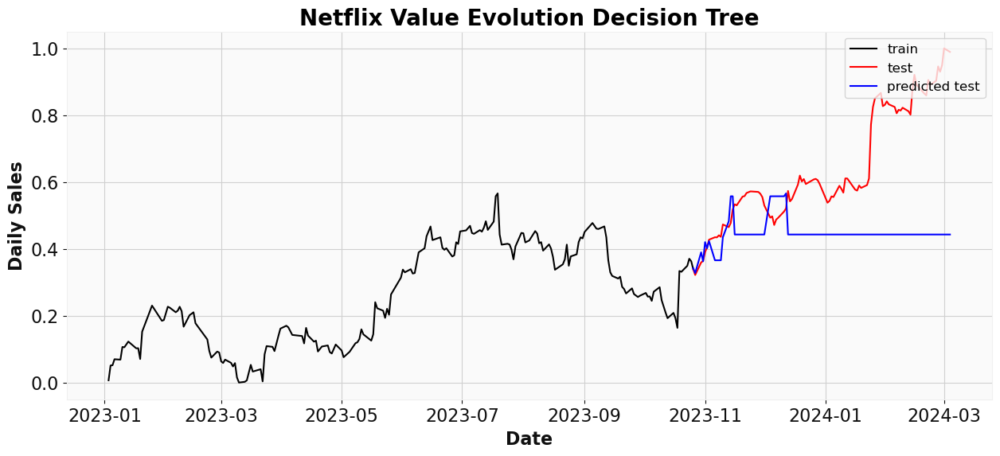

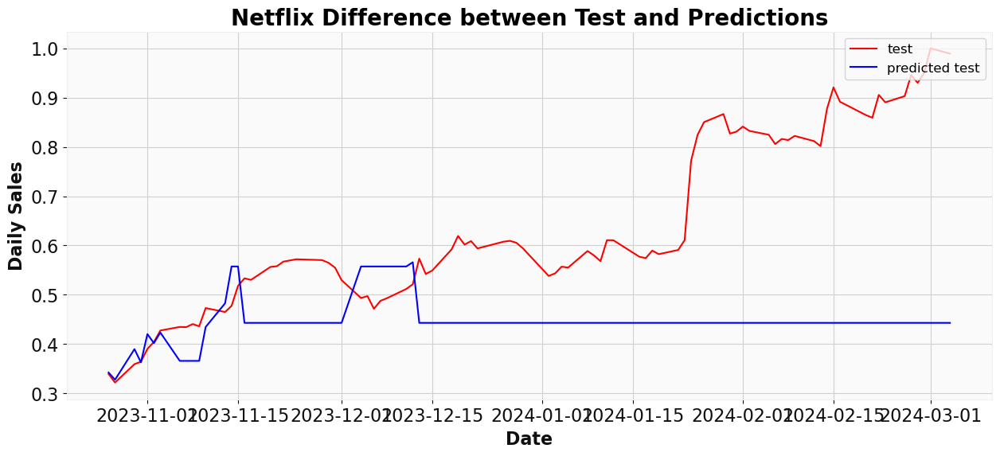

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.19471863014493992
Root Mean squared Error - RMSE : 0.25901888988855265
----------------------------------------------------------------------------------------------------


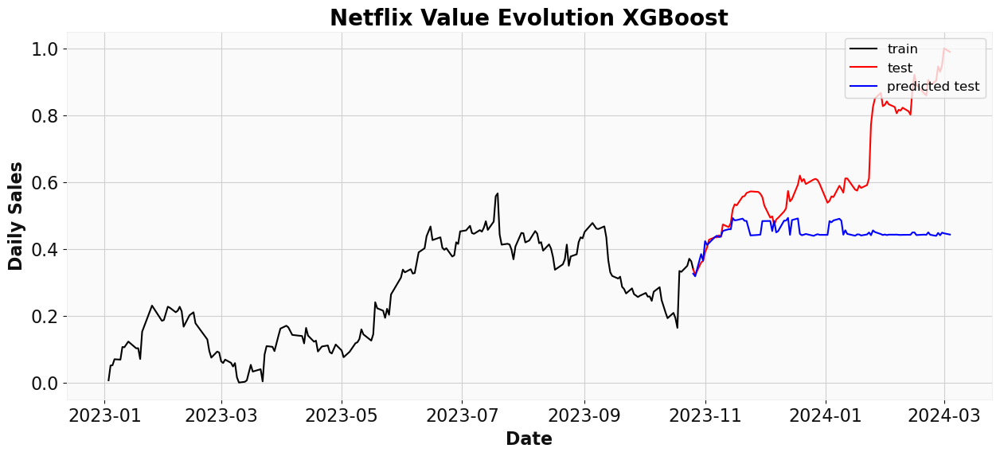

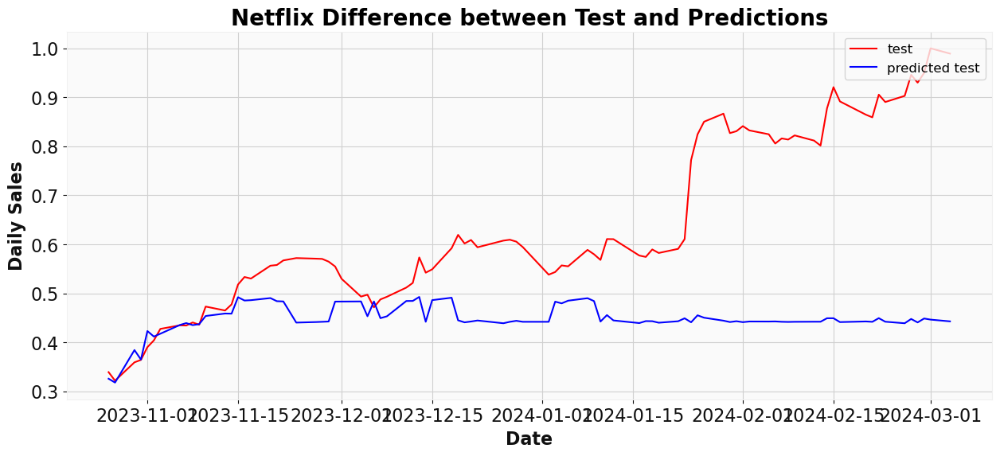

USING SPX500 DATASET
Training and evaluating Random Forest...


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15984840488712174
Root Mean squared Error - RMSE : 0.20785963353323056
----------------------------------------------------------------------------------------------------


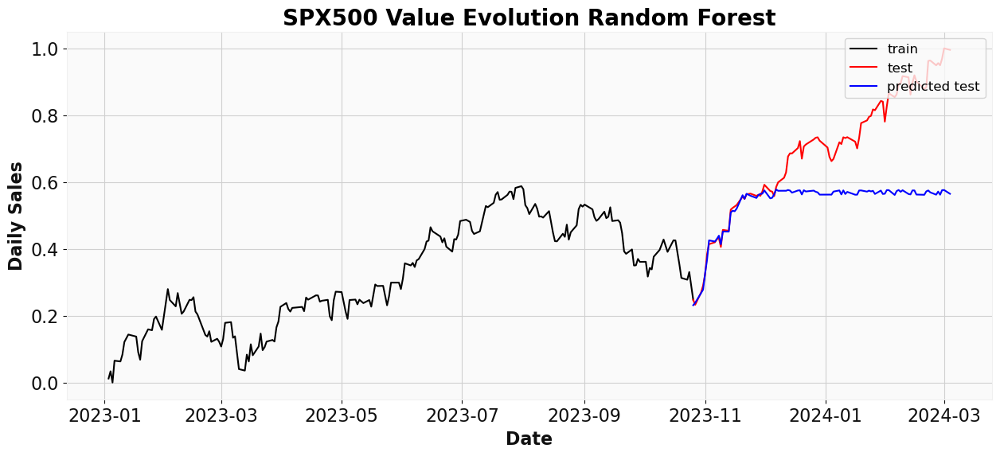

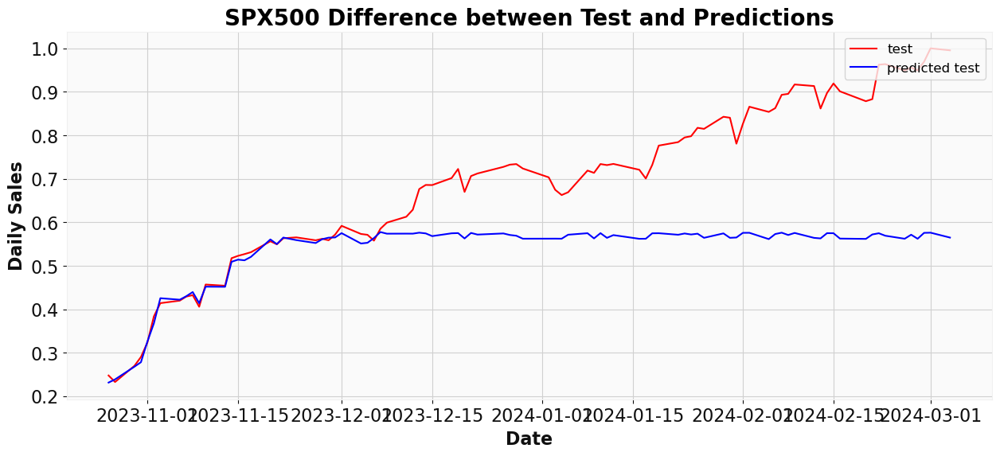

Training and evaluating Decision Tree...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15425938568827668
Root Mean squared Error - RMSE : 0.20114567791403223
----------------------------------------------------------------------------------------------------


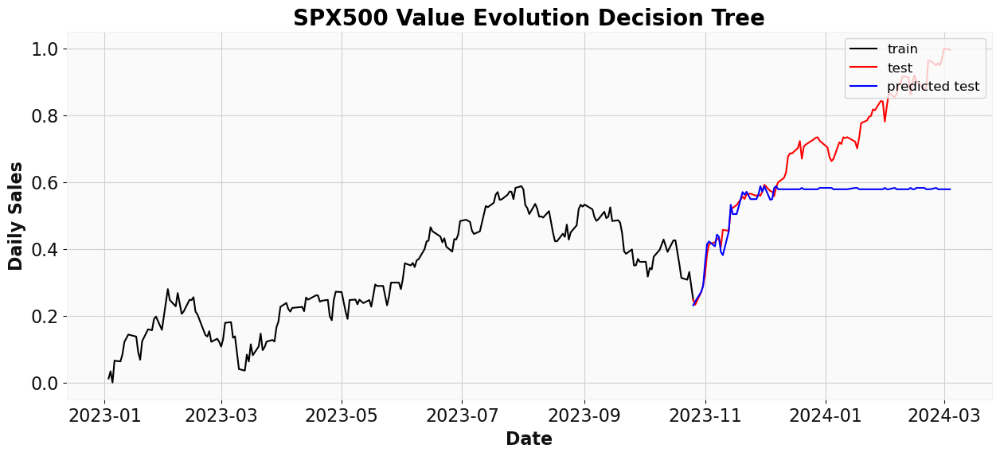

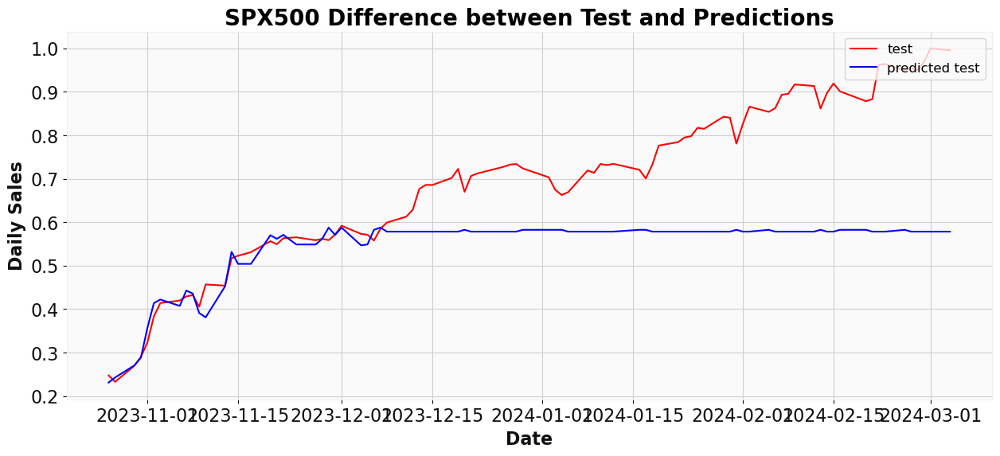

Training and evaluating XGBoost...
----------------------------------------------------------------------------------------------------
Mean Absolute Error - MAE : 0.15961170705494582
Root Mean squared Error - RMSE : 0.20595761003277754
----------------------------------------------------------------------------------------------------


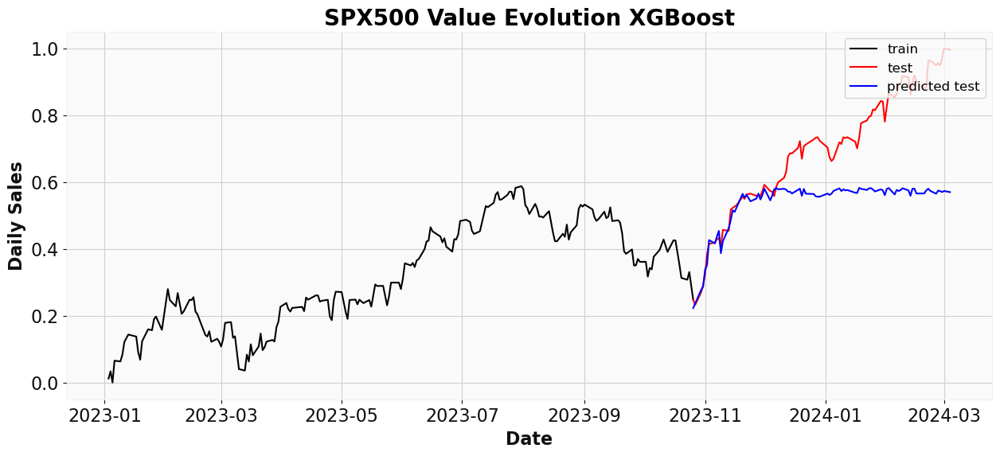

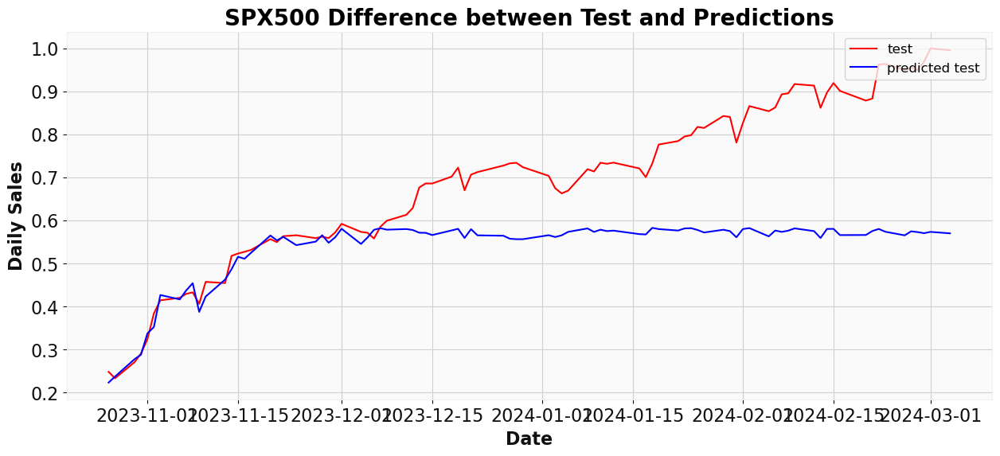

USING AMAZON DATASET
[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 6ms/step


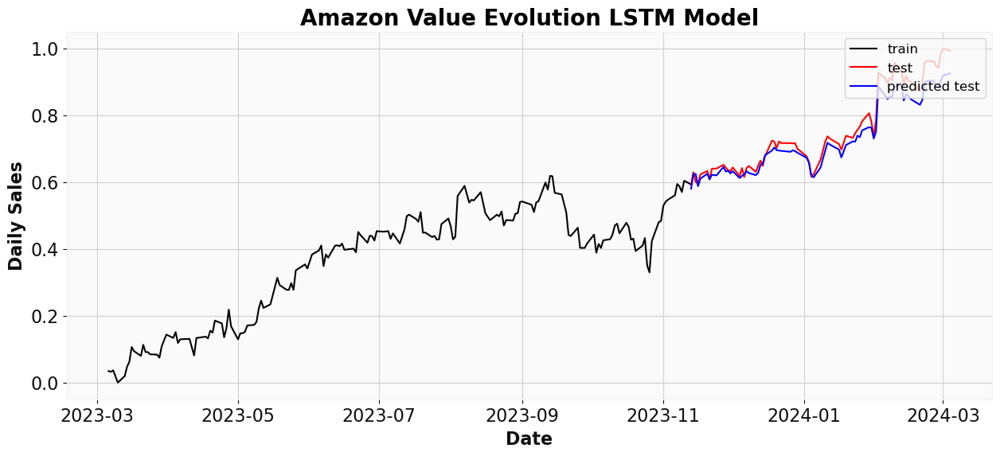

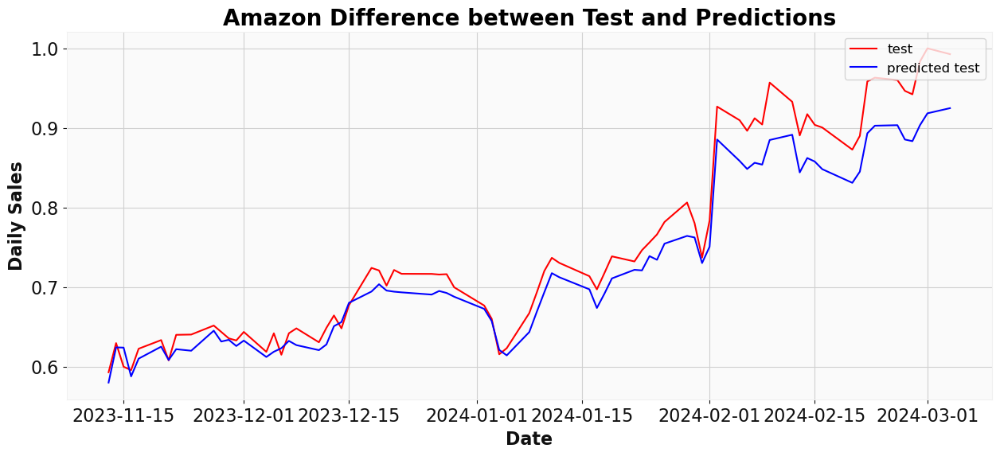

[STATUS] Calculating metrics...
MAE: 0.03567118651512209
RMSE: 0.046372372242931496
USING APPLE DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 6ms/step


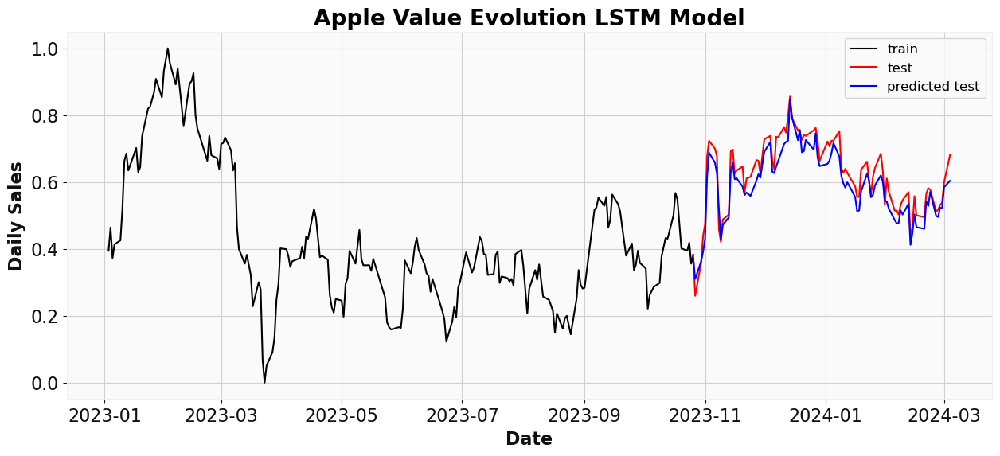

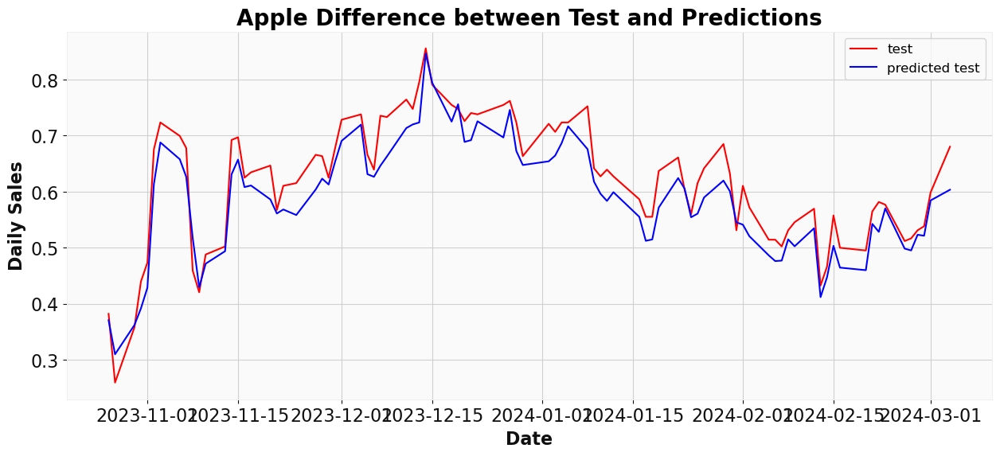

[STATUS] Calculating metrics...
MAE: 0.0571465307658368
RMSE: 0.07098904374845566
USING NETFLIX DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 6ms/step


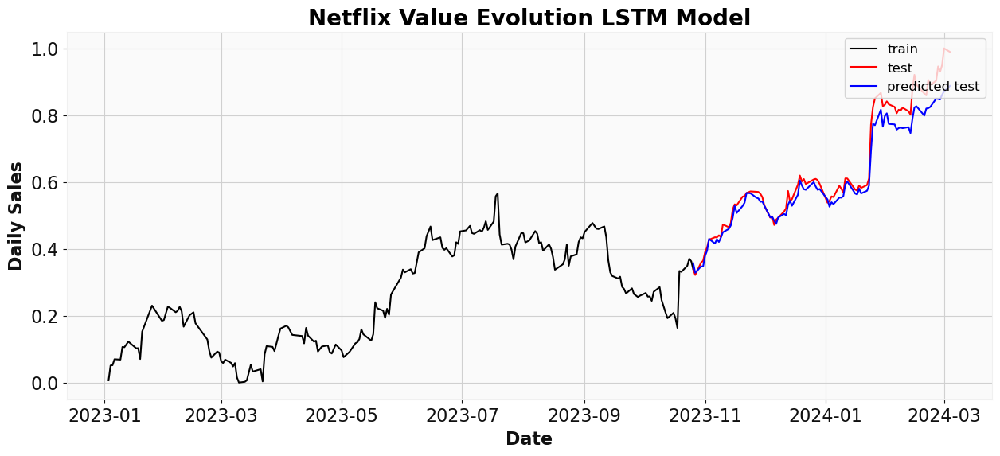

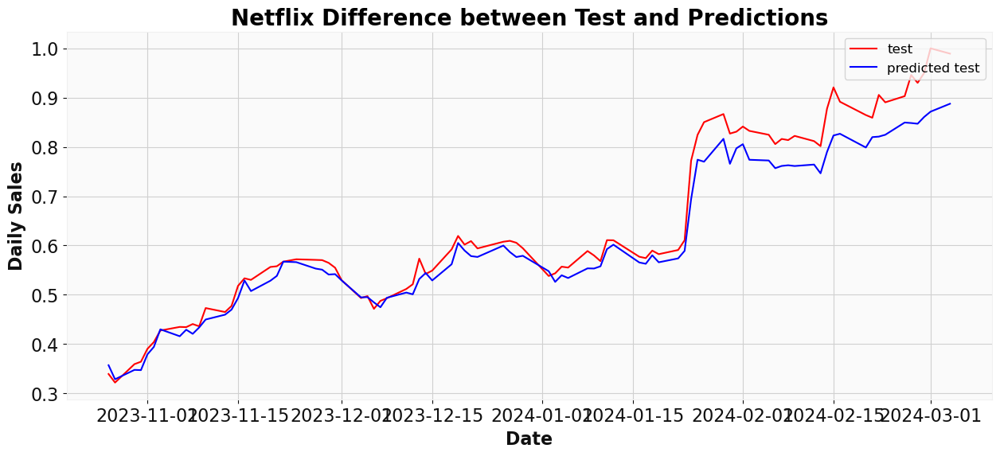

[STATUS] Calculating metrics...
MAE: 0.04112511550973154
RMSE: 0.05473102714428082
USING SPX500 DATASET


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


[STATUS] Training...
[STATUS] Evaluating...
3/3 [==============================] - 0s 7ms/step


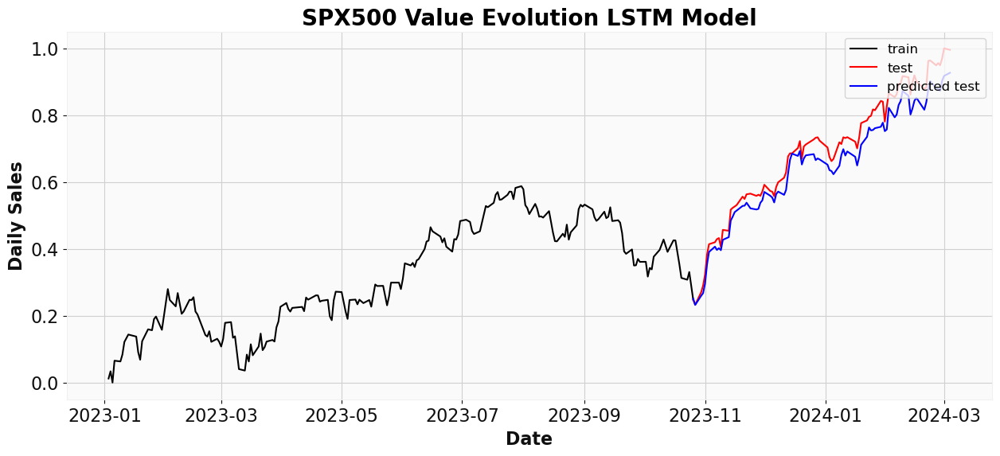

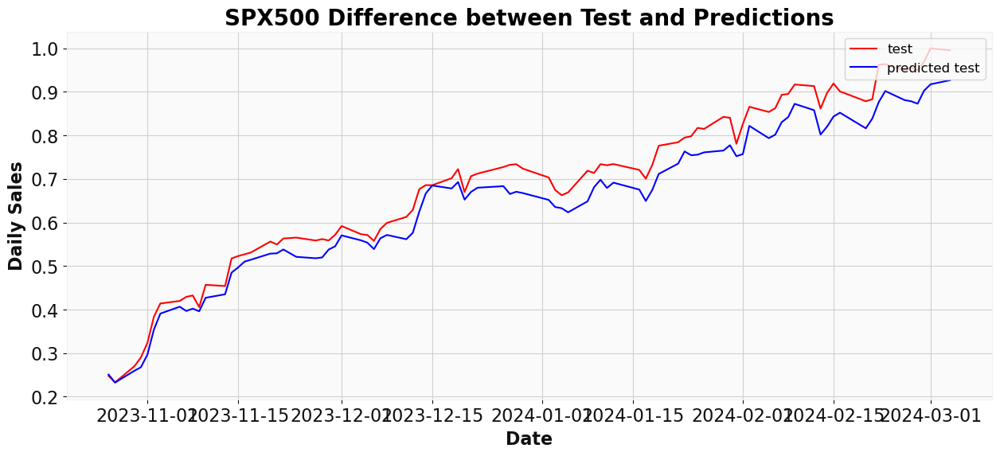

[STATUS] Calculating metrics...
MAE: 0.05082998428120206
RMSE: 0.057778060270205746


/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
/home/marc/anaconda3/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3502: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)


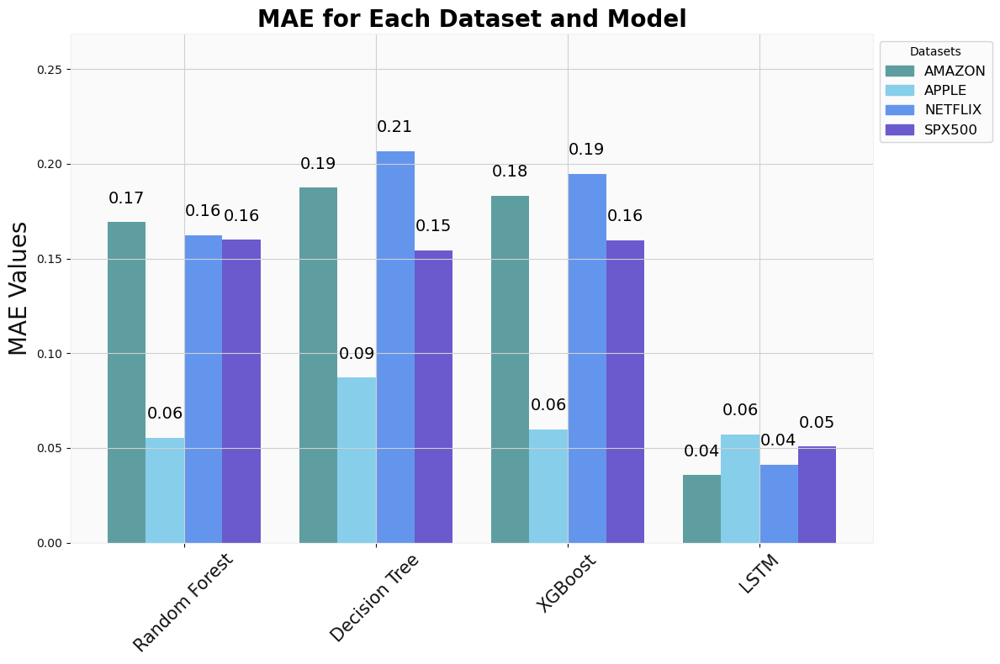

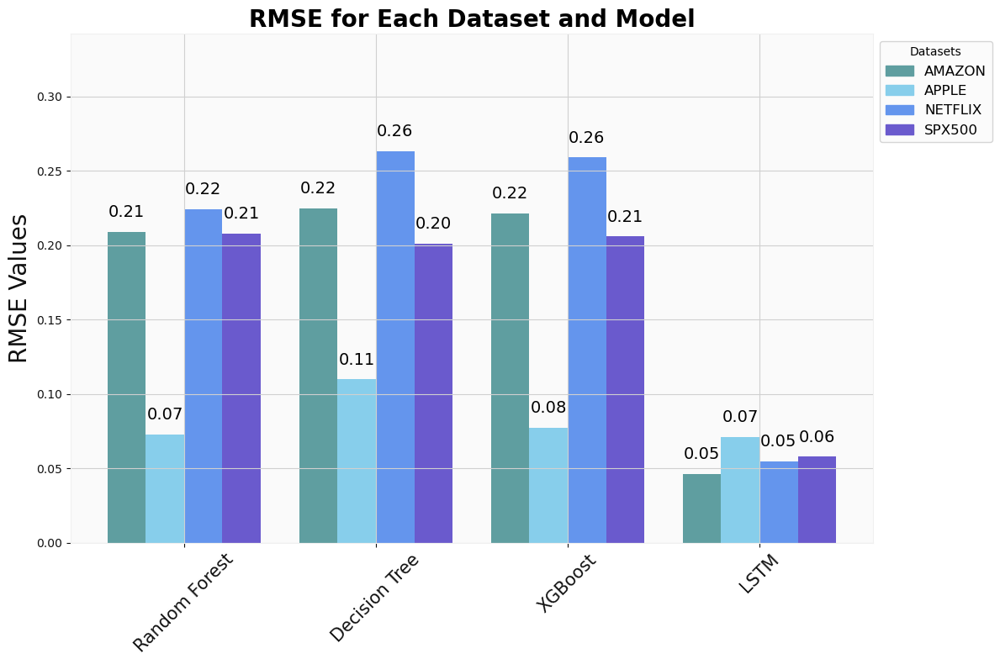

In [44]:
features = ['Open', 'Close', 'High', 'Low', 'Volume', 'Difference', 'NS', 'ND']
target = ['Next Close']

forecast(datasets, features, target, 'ns_nd')

Despite those predictions are pretty good, this results have not been tested using on-time data, which makes those results not trustworthy.

# Second Part of the Project

From this point, the goal of the project was trying to predict the exact value of the stock given the information before that moment. Now, let's try to make a classification model like this:
+ Return 1 if after candle were're now, the expected is a upbar.
+ Return 0 if otherwise

For this we're going to use the same information as before. The questions we are going to try to answer are:
1. How much importance is the model giving to all the information we are giving him?
2. We know context is key to predict the value of future instances. Is the model understanding this context? Can he do it?

The first candle we are going to study are the NS ones. From theory we know that after a NS, the price is going to rise, but we also know that the context plays a key role on those predictions.

We are going to calculate the proportion of NS that actually rise their price after it. 

In [45]:
def calculate_positive_differences(Dataset, candle_type):
    NS_count = 0
    total = 0

    for i in range(len(Dataset.dataset)-1):
        if Dataset.dataset.iloc[i][candle_type] == 1:
            total = total + 1
            if Dataset.dataset.iloc[i+1]['Difference'] > 0:
                NS_count = NS_count + 1

    print(NS_count/total)

In [46]:
calculate_positive_differences(AMAZON2, 'NS')

0.55


In [47]:
calculate_positive_differences(APPLE2, 'NS')

0.38235294117647056


In [48]:
calculate_positive_differences(NETFLIX2, 'NS')

0.48484848484848486


In [49]:
calculate_positive_differences(SPX5002, 'NS')

0.68


Now let's check the ND candles type.

In [50]:
calculate_positive_differences(AMAZON2, 'ND')

0.5454545454545454


In [51]:
calculate_positive_differences(APPLE2, 'ND')

0.6486486486486487


In [52]:
calculate_positive_differences(NETFLIX2, 'ND')

0.525


In [53]:
calculate_positive_differences(SPX5002, 'ND')

0.5301204819277109


Let's calculate how much NS and ND we have for each dataset.

In [54]:
def count_NS_and_ND_from(Dataset):
    total_candles = len(Dataset.dataset)
    NS_candles = len(Dataset.dataset[Dataset.dataset['NS'] == 1])
    ND_candles = len(Dataset.dataset[Dataset.dataset['ND'] == 1])
    
    print(f"Dataset: {Dataset.name}. NS: {NS_candles}/{total_candles}. ND: {ND_candles}/{total_candles}")

In [55]:
count_NS_and_ND_from(AMAZON2)

Dataset: Amazon. NS: 60/251. ND: 33/251


In [56]:
count_NS_and_ND_from(APPLE2)

Dataset: Apple. NS: 68/293. ND: 37/293


In [57]:
count_NS_and_ND_from(NETFLIX2)

Dataset: Netflix. NS: 67/293. ND: 40/293


In [58]:
count_NS_and_ND_from(SPX5002)

Dataset: SPX500. NS: 25/293. ND: 83/293


Let's try it with the classification model.

In [59]:
def label_positives_differences(Dataset):
    labels = list()
    
    for i in range(len(Dataset.dataset)):
        if Dataset.dataset.iloc[i]['Close'] < Dataset.dataset.iloc[i]['Next Close']:
            labels.append(1)
        else:
            labels.append(0)
            
    Dataset.dataset['Next Candle UpBar'] = labels
    
    return Dataset

In [60]:
AMAZON2 = label_positives_differences(AMAZON2)

In [61]:
APPLE2 = label_positives_differences(APPLE2)

In [62]:
NETFLIX2 = label_positives_differences(NETFLIX2)

In [63]:
SPX5002 = label_positives_differences(SPX5002)

Let's check how many of these values 

Now let's try to predict those values

In [64]:
def find_optimal_threshold(fpr, tpr, thresholds):
    youden_index = tpr - fpr
    optimal_idx = np.argmax(youden_index)
    optimal_threshold = thresholds[optimal_idx]
    return optimal_threshold

In [65]:
def forecast_classification(datasets, features, target, new_feature):
    dictionary_solutions = dict()
    auc_roc_values_dictionary = dict()
    
    models = {
        "Random Forest": RandomForestClassifier(n_estimators=1000),
        "Logistic Regression": LogisticRegression(),
        "Support Vector Machine": SVC(probability=True),
        "K-Nearest Neighbors": KNeighborsClassifier(n_neighbors=5),
        "Gradient Boosting": GradientBoostingClassifier(),
        "Naive Bayes": GaussianNB()
    }
        
    for model_name, model in models.items():
        subdictionary_solutions = dict()
        subdictionary_auc_solutions = dict()

        for dataset_name, dataset in datasets.items():
            print(f"[STATUS] Using {dataset_name} Dataset")
            X_train, y_train, X_test, y_test = dataset.split_data(features, target)

            model.fit(X_train, y_train)
            if hasattr(model, "predict_proba"):
                y_proba = model.predict_proba(X_test)[:, 1]
            else:
                y_proba = model.decision_function(X_test)

            fpr, tpr, thresholds = roc_curve(y_test, y_proba)
            roc_auc = auc(fpr, tpr)
            optimal_threshold = find_optimal_threshold(fpr, tpr, thresholds)

            print(f"{model_name} - ROC AUC: {roc_auc}, Optimal Threshold: {optimal_threshold}")

            plt.figure()        
            plt.plot(fpr, tpr, lw=2, color='darkorange', label=f'{model_name} (AUC = {roc_auc:.2f})')

            plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
            plt.xlim([0.0, 1.0])
            plt.ylim([0.0, 1.05])
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.title(f'ROC Curve {dataset_name} using {model_name}')
            plt.legend(loc="lower right", fontsize='large')
            
            # Ensure the directory exists
            directory = 'Informe/Imatges/Annex'
            if not os.path.exists(directory):
                os.makedirs(directory)

            # Build the filename
            filename = f"Roc_{dataset_name}_{new_feature if new_feature else 'default'}.png"
            filepath = os.path.join(directory, filename)

            # Save the plot as a PNG image
            plt.savefig(filepath, bbox_inches='tight')

            # Show the plot
            plt.show() 

            y_pred = (y_proba >= optimal_threshold).astype(int)
            
            subdictionary_solutions[dataset_name] = y_pred
            subdictionary_auc_solutions[dataset_name] = roc_auc

        dictionary_solutions[model_name] = subdictionary_solutions
        auc_roc_values_dictionary[model_name] = subdictionary_auc_solutions
        
    return dictionary_solutions, auc_roc_values_dictionary


In [66]:
import tensorflow as tf
from sklearn.metrics import roc_curve, auc

class TimeSeriesBinaryClassifierModel:
    def __init__(self, input_shape, threshold=0.5):
        self.input_shape = input_shape
        self.threshold = threshold
        self.model = self.build_model()

    def build_model(self):
        model = tf.keras.Sequential([
            tf.keras.layers.LSTM(128, activation='relu', input_shape=(self.input_shape, 1)),
            tf.keras.layers.Dense(64, activation='relu'),
            tf.keras.layers.Dense(64, activation='relu'),
            tf.keras.layers.Dense(1, activation='sigmoid')
        ])
        model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
        return model

    def train(self, X_train, y_train, X_test, y_test, epochs=50, batch_size=32):
        history = self.model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, 
                                 validation_data=(X_test, y_test), verbose=0)
        return history

    def evaluate(self, X_test, y_test):
        val_loss, val_accuracy = self.model.evaluate(X_test, y_test)
        return val_loss, val_accuracy

    def predict(self, X):
        predictions = self.model.predict(X)
        predicted_labels = (predictions >= self.threshold).astype(int)
        return predicted_labels.flatten()

    def calculate_roc_auc(self, X_test, y_test):
        y_pred_proba = self.model.predict(X_test).ravel()
        fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
        roc_auc = auc(fpr, tpr)
        return fpr, tpr, thresholds, roc_auc

In [67]:
def forecast_classification_NN(Dataset, features, target, new_feature):
    X_train, y_train, X_test, y_test = Dataset.split_data(features, target)
    
    input_shape = X_train.shape[1]    
    model = TimeSeriesBinaryClassifierModel(input_shape=input_shape)
    
    print(f"[STATUS] Using {Dataset.name} Dataset")
    
    model.train(X_train, y_train, X_test, y_test, epochs=100, batch_size=32)
    
    val_loss, val_accuracy = model.evaluate(X_test, y_test)
    print(f'Validation Accuracy: {val_accuracy}')
    
    predicted_labels = model.predict(X_test)
    
    fpr, tpr, thresholds, roc_auc = model.calculate_roc_auc(X_test, y_test)
    print(f"ROC AUC: {roc_auc}")
    import numpy as np

    optimal_threshold = find_optimal_threshold(fpr, tpr, thresholds)
    print(f'Optimal Threshold: {optimal_threshold:.2f}')

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve {Dataset.name} using LSTM')
    plt.legend(loc="lower right", fontsize='large')
    
    # Ensure the directory exists
    directory = 'Informe/Imatges/Annex'
    if not os.path.exists(directory):
        os.makedirs(directory)

    # Build the filename
    filename = f"Roc_{Dataset.name}_{new_feature if new_feature else 'default'}.png"
    filepath = os.path.join(directory, filename)

    # Save the plot as a PNG image
    plt.savefig(filepath, bbox_inches='tight')

    # Show the plot
    plt.show() 
    
    model = TimeSeriesBinaryClassifierModel(input_shape=input_shape, threshold=optimal_threshold)
    model.train(X_train, y_train, X_test, y_test, epochs=100, batch_size=32)
    val_loss, val_accuracy = model.evaluate(X_test, y_test)
    print(f'Validation Accuracy (Optimal Threshold): {val_accuracy}')
    predicted_labels = model.predict(X_test)

    return predicted_labels, roc_auc   

In [68]:
def run_forecast_classification(datasets, features, target, new_feature=None):
    predictions_dictionary_NN = dict()
    predictions_dictionary = dict()
    
    auc_roc_dictionary_NN = dict()
    auc_roc_dictionary = dict()
        
    for dataset_name, dataset in datasets.items():      
        predictions, auc_roc_value = forecast_classification_NN(dataset, features, target, new_feature)  
        predictions_dictionary_NN[dataset_name] = predictions
        auc_roc_dictionary_NN[dataset_name] = auc_roc_value
                
    predictions_dictionary, auc_roc_dictionary = forecast_classification(datasets, features, target, new_feature)
    predictions_dictionary['NN'] = predictions_dictionary_NN
    auc_roc_dictionary['NN'] = auc_roc_dictionary_NN
        
    return predictions_dictionary, auc_roc_dictionary

In [69]:
def plot_auc_roc(roc_curve, new_feature=None):
    data = roc_curve
    # Preparació de les dades per l'histograma
    models = list(data.keys())
    datasets = list(data[models[0]].keys())
    num_models = len(models)
    num_datasets = len(datasets)

    fig, ax = plt.subplots(figsize=(10, 6))

    # Amplada de les barres
    bar_width = 0.15
    index = np.arange(num_models)

    # Creació de les barres per cada dataset
    colors = ['cadetblue', 'skyblue', 'cornflowerblue', 'slateblue']
    for i, dataset in enumerate(datasets):
        values = [data[model][dataset] for model in models]
        ax.bar(index + i * bar_width, values, bar_width, label=dataset, color=colors[i])

    # Configuració de l'eix x i les etiquetes
    ax.set_ylabel('Valor', fontsize=20)
    ax.set_title('Auc Roc Value for each dataset',
            fontsize=20, loc='center', fontdict=dict(weight='bold'))
    ax.set_xticks(index + bar_width * (num_datasets - 1) / 2)
    ax.set_xticklabels(models, rotation=45, ha='right', fontsize=12)  # Girar els noms dels models
    ax.legend(loc='upper right', fontsize='large')  # Pots canviar 'upper right' per la posició que desitgis

    # Fixar els límits de l'eix Y fins a 1
    ax.set_ylim(0, 1)

    # Mostrar l'histograma
    plt.tight_layout()
    
    # Ensure the directory exists
    directory = 'Informe/Imatges/SegonEnfoc'
    if not os.path.exists(directory):
        os.makedirs(directory)

    # Build the filename
    filename = f"Area_Under_Curve_{new_feature if new_feature else 'default'}.png"
    filepath = os.path.join(directory, filename)

    # Save the plot as a PNG image
    plt.savefig(filepath, bbox_inches='tight')
    
    plt.show()

[STATUS] Using Amazon Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.9479 - accuracy: 0.5000
Validation Accuracy: 0.5
3/3 [==============================] - 0s 3ms/step
ROC AUC: 0.6329639889196677
Optimal Threshold: 0.20


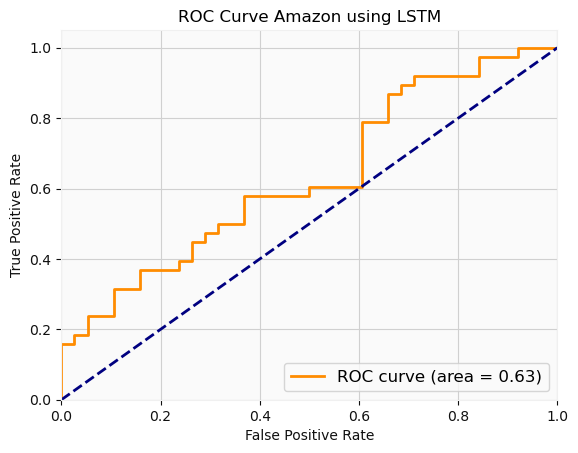

3/3 [==============================] - 0s 3ms/step - loss: 0.9216 - accuracy: 0.5000
Validation Accuracy (Optimal Threshold): 0.5
3/3 [==============================] - 0s 2ms/step
[STATUS] Using Apple Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.7219 - accuracy: 0.4773
Validation Accuracy: 0.47727271914482117
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.35093167701863354
Optimal Threshold: inf


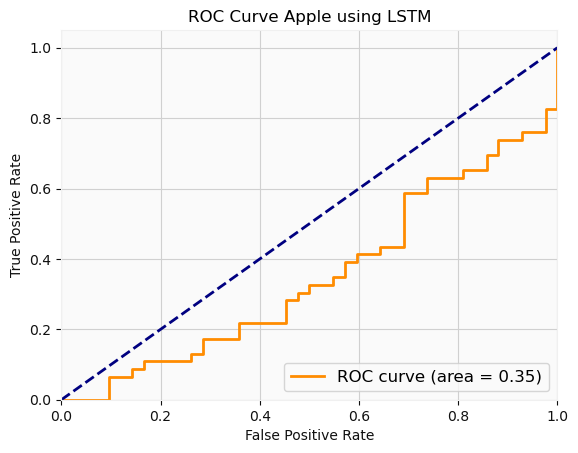

3/3 [==============================] - 0s 3ms/step - loss: 0.7130 - accuracy: 0.4773
Validation Accuracy (Optimal Threshold): 0.47727271914482117
3/3 [==============================] - 0s 2ms/step
[STATUS] Using Netflix Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.6946 - accuracy: 0.3864
Validation Accuracy: 0.3863636255264282
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.3715332286760858
Optimal Threshold: inf


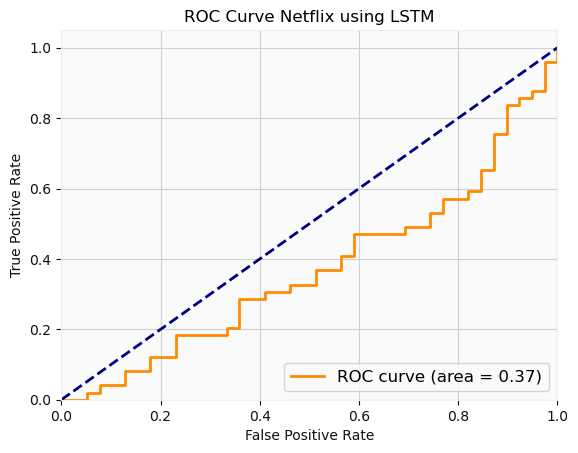

3/3 [==============================] - 0s 3ms/step - loss: 0.6949 - accuracy: 0.5341
Validation Accuracy (Optimal Threshold): 0.5340909361839294
3/3 [==============================] - 0s 3ms/step
[STATUS] Using SPX500 Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.7076 - accuracy: 0.3523
Validation Accuracy: 0.35227271914482117
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.6061120543293718
Optimal Threshold: 0.46


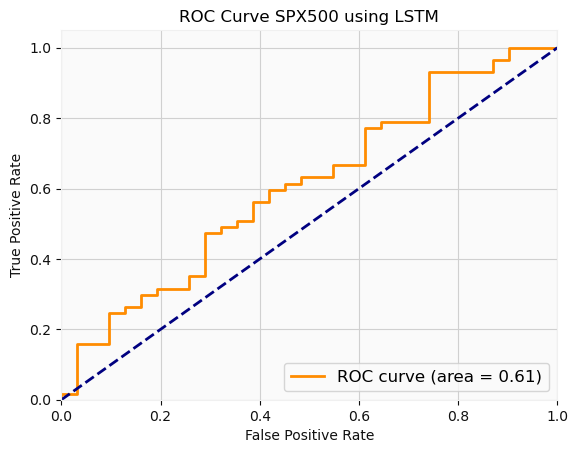

3/3 [==============================] - 0s 3ms/step - loss: 0.7169 - accuracy: 0.3523
Validation Accuracy (Optimal Threshold): 0.35227271914482117
3/3 [==============================] - 0s 2ms/step
[STATUS] Using AMAZON Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5408587257617727, Optimal Threshold: 0.066


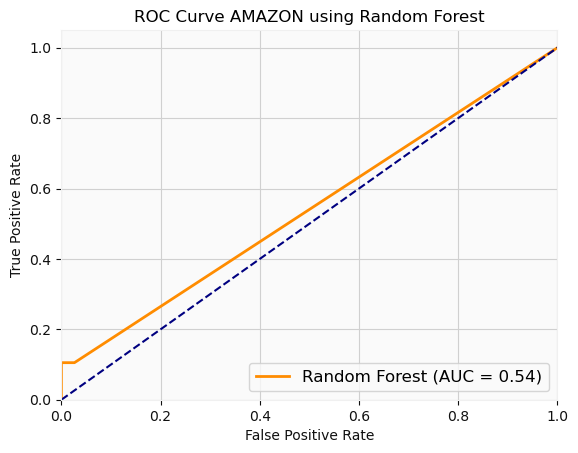

[STATUS] Using APPLE Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5111283643892339, Optimal Threshold: 0.583


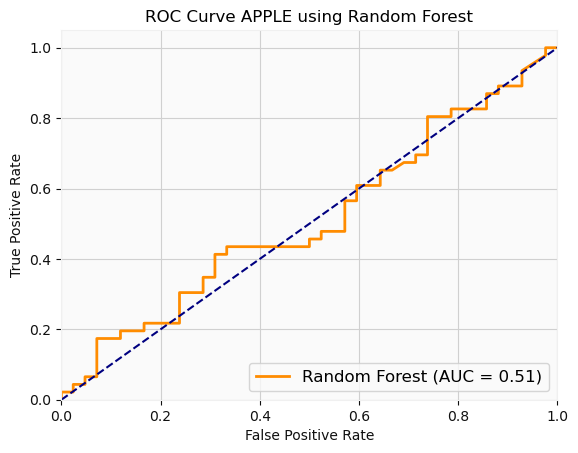

[STATUS] Using NETFLIX Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5931449502878074, Optimal Threshold: 0.569


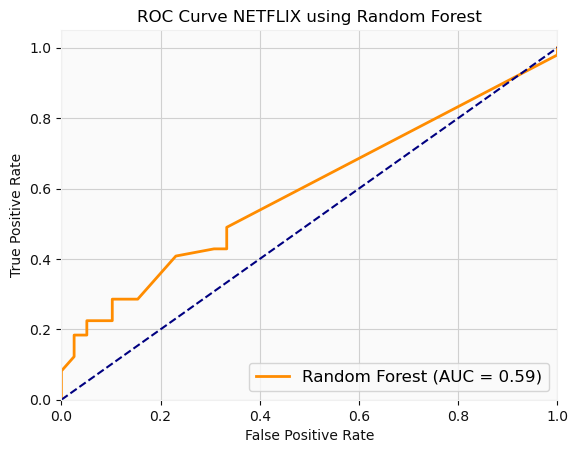

[STATUS] Using SPX500 Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5398981324278439, Optimal Threshold: 0.474


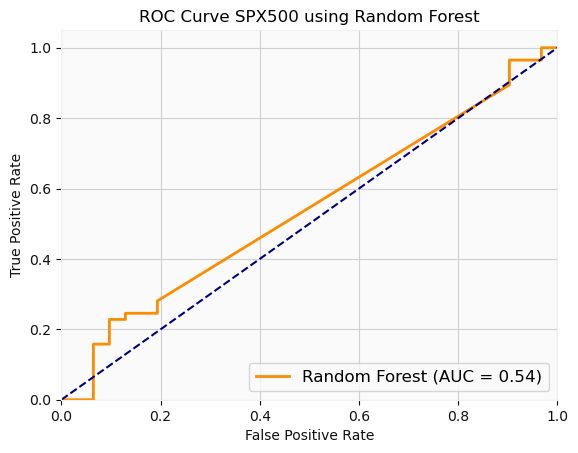

[STATUS] Using AMAZON Dataset
Logistic Regression - ROC AUC: 0.6329639889196677, Optimal Threshold: 0.4756615756677013


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


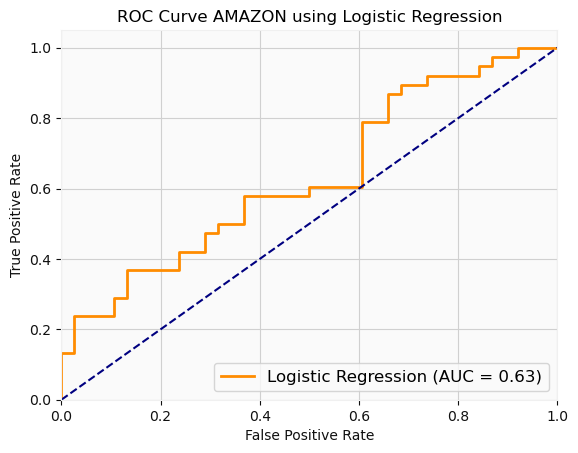

[STATUS] Using APPLE Dataset
Logistic Regression - ROC AUC: 0.6625258799171843, Optimal Threshold: 0.45062395294900104


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


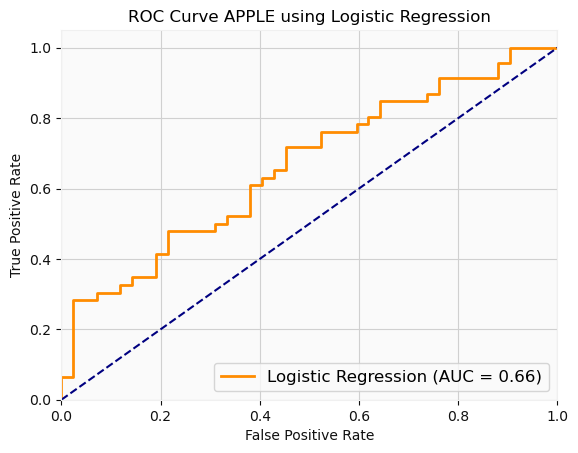

[STATUS] Using NETFLIX Dataset
Logistic Regression - ROC AUC: 0.6268969126111983, Optimal Threshold: 0.4639015480157984


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


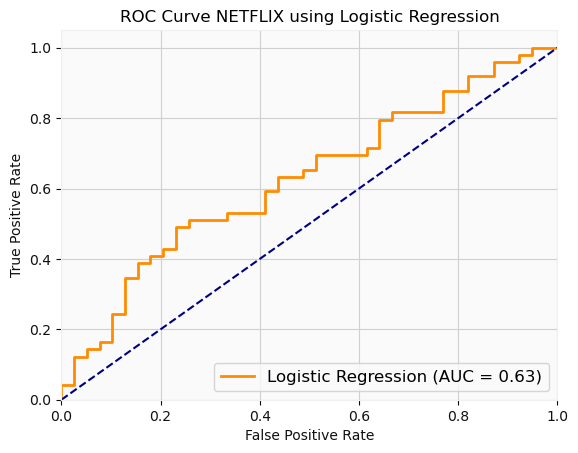

[STATUS] Using SPX500 Dataset
Logistic Regression - ROC AUC: 0.6066779852857951, Optimal Threshold: 0.38530415496849035


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


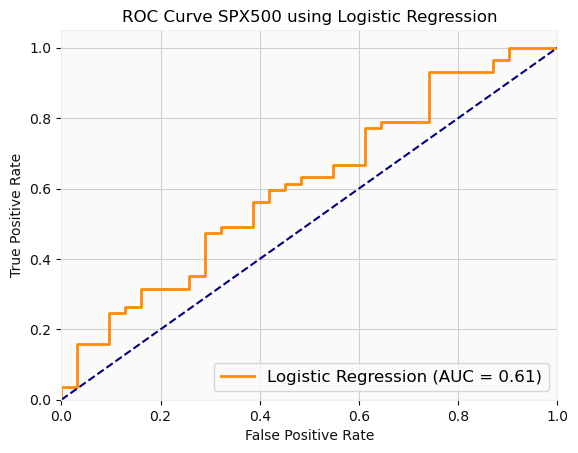

[STATUS] Using AMAZON Dataset
Support Vector Machine - ROC AUC: 0.41066481994459836, Optimal Threshold: 0.3701948614527993


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


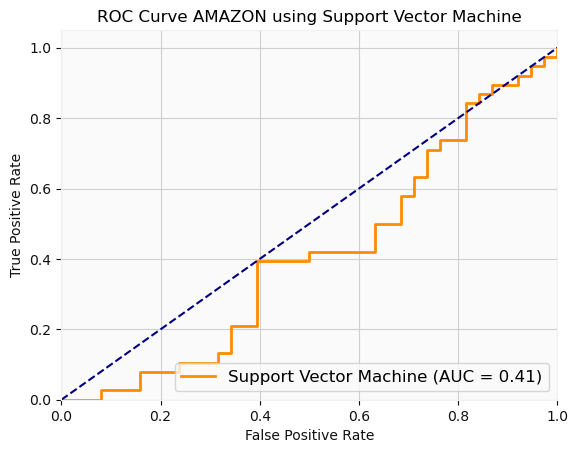

[STATUS] Using APPLE Dataset
Support Vector Machine - ROC AUC: 0.3436853002070393, Optimal Threshold: 0.5


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


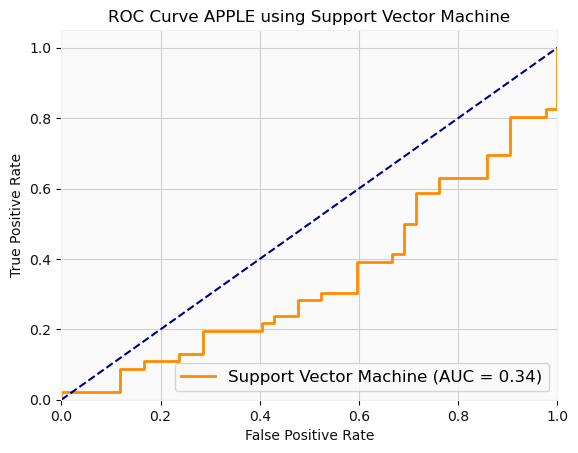

[STATUS] Using NETFLIX Dataset
Support Vector Machine - ROC AUC: 0.5274725274725275, Optimal Threshold: 0.4669074447352568


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


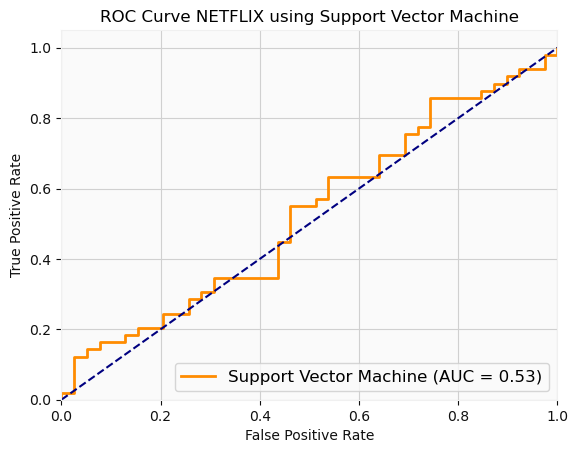

[STATUS] Using SPX500 Dataset
Support Vector Machine - ROC AUC: 0.5732880588568194, Optimal Threshold: 0.5317380522151629


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


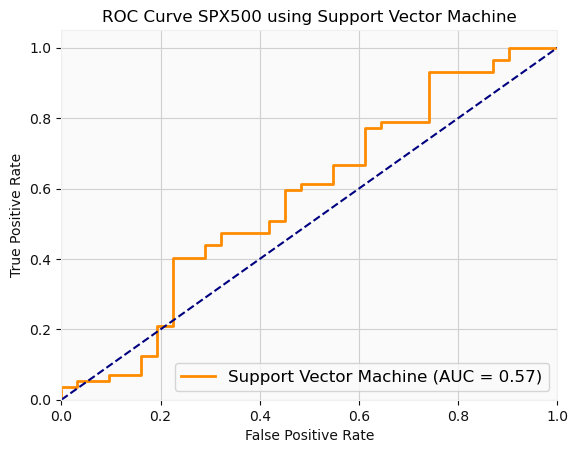

[STATUS] Using AMAZON Dataset
K-Nearest Neighbors - ROC AUC: 0.4736842105263158, Optimal Threshold: inf


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


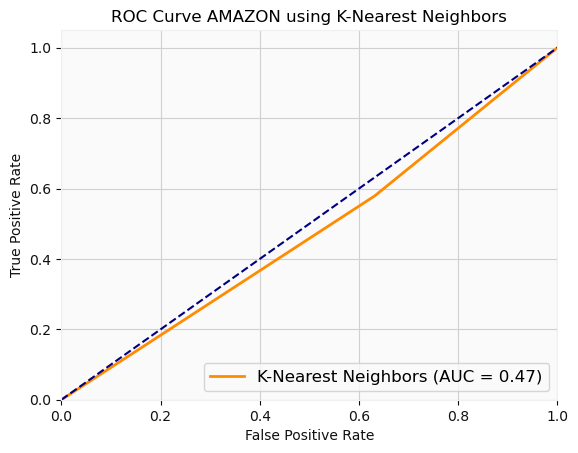

[STATUS] Using APPLE Dataset
K-Nearest Neighbors - ROC AUC: 0.5797101449275363, Optimal Threshold: 0.4


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


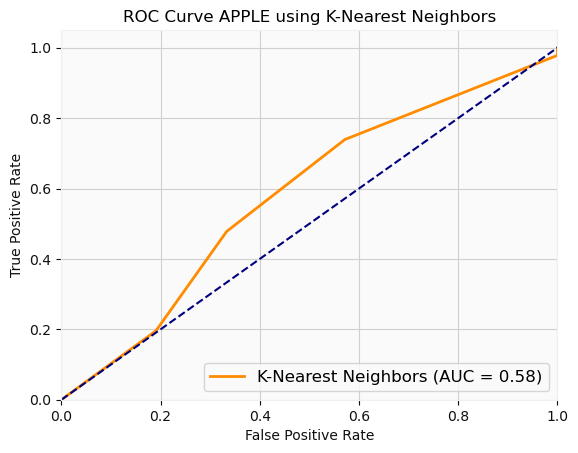

[STATUS] Using NETFLIX Dataset
K-Nearest Neighbors - ROC AUC: 0.4429618001046573, Optimal Threshold: 0.8


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


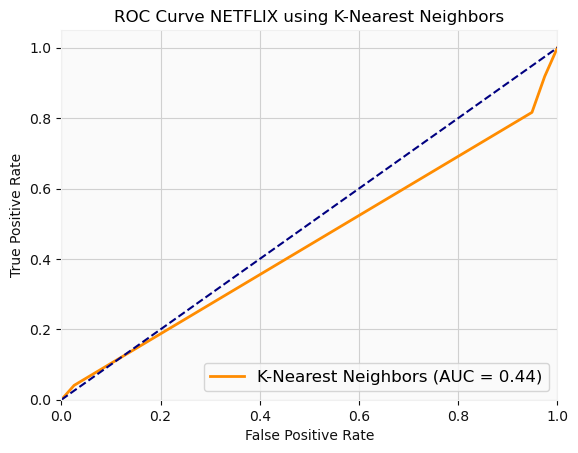

[STATUS] Using SPX500 Dataset
K-Nearest Neighbors - ROC AUC: 0.4603848330503678, Optimal Threshold: 0.6


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


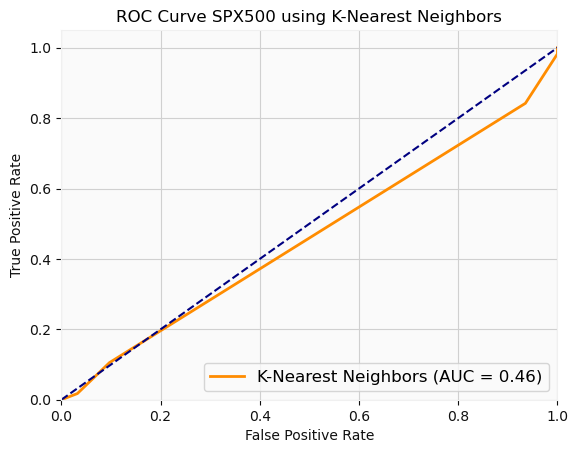

[STATUS] Using AMAZON Dataset
Gradient Boosting - ROC AUC: 0.5, Optimal Threshold: 0.1036416009598881


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


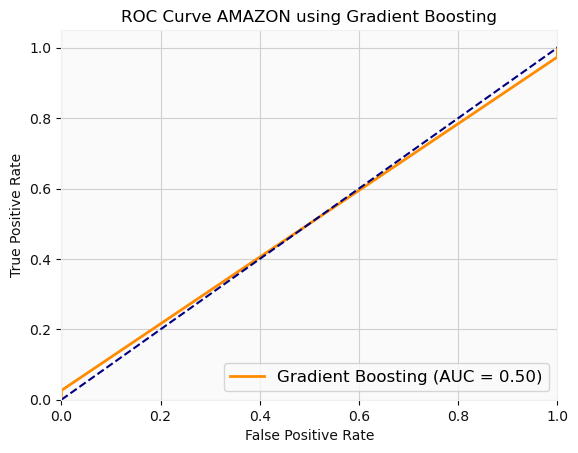

[STATUS] Using APPLE Dataset
Gradient Boosting - ROC AUC: 0.4508281573498965, Optimal Threshold: 0.4091029757179587


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


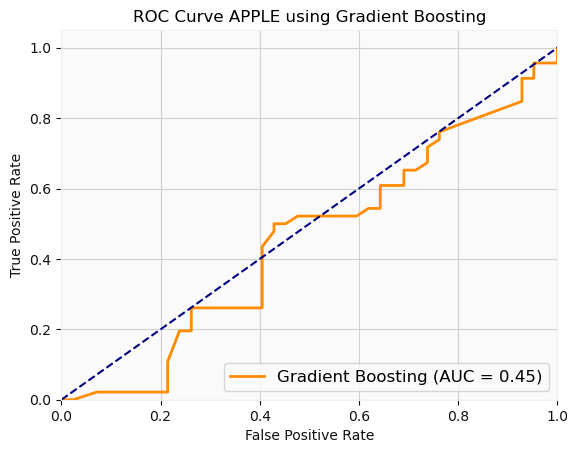

[STATUS] Using NETFLIX Dataset
Gradient Boosting - ROC AUC: 0.5792778649921508, Optimal Threshold: 0.6490841179593507


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


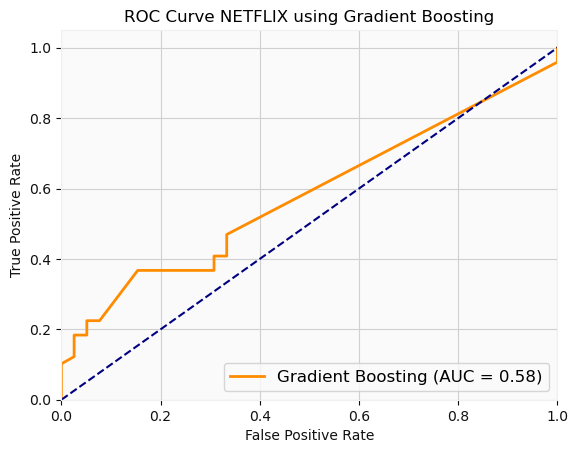

[STATUS] Using SPX500 Dataset
Gradient Boosting - ROC AUC: 0.5458404074702885, Optimal Threshold: 0.2317158614819127


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


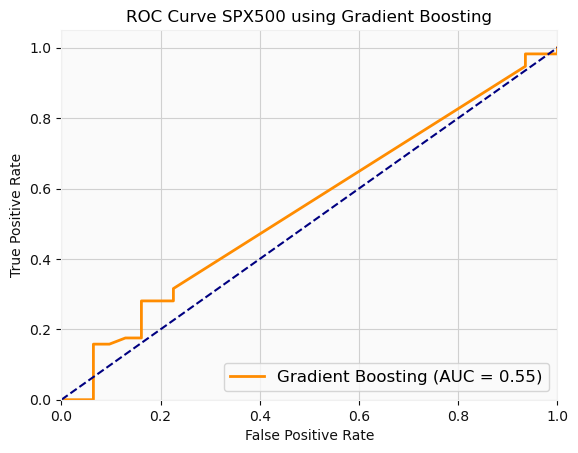

[STATUS] Using AMAZON Dataset
Naive Bayes - ROC AUC: 0.6329639889196677, Optimal Threshold: 0.08866133614420484


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


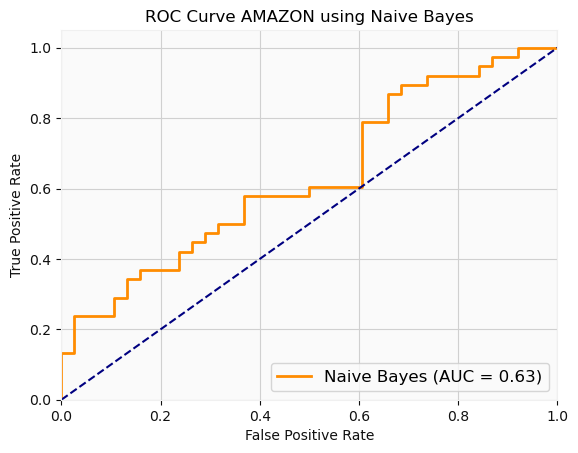

[STATUS] Using APPLE Dataset
Naive Bayes - ROC AUC: 0.3887163561076604, Optimal Threshold: 0.3502851912793998


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


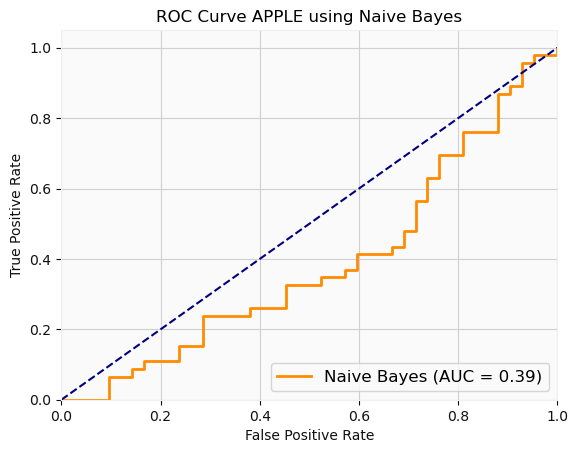

[STATUS] Using NETFLIX Dataset
Naive Bayes - ROC AUC: 0.3731030873888017, Optimal Threshold: inf


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


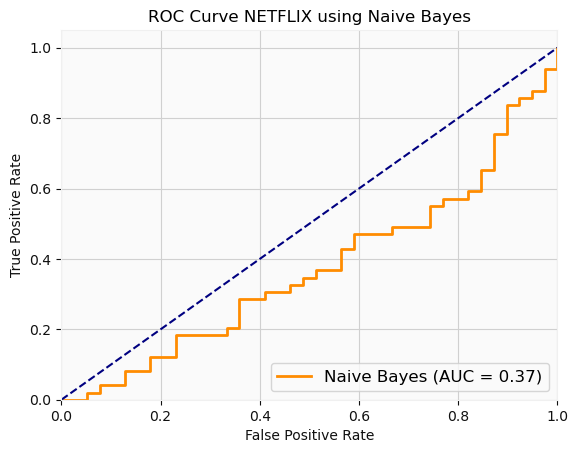

[STATUS] Using SPX500 Dataset
Naive Bayes - ROC AUC: 0.4606677985285795, Optimal Threshold: 0.3457450940130146


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


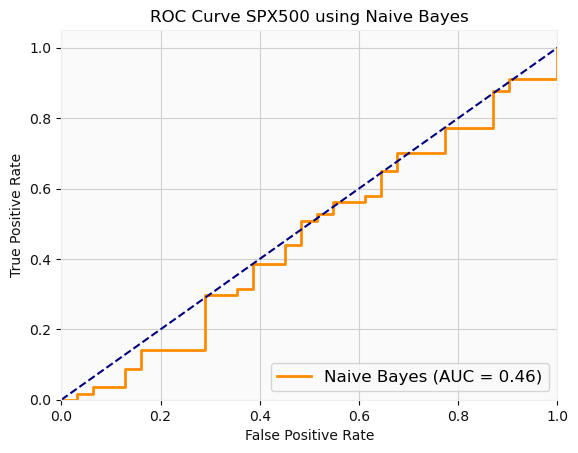

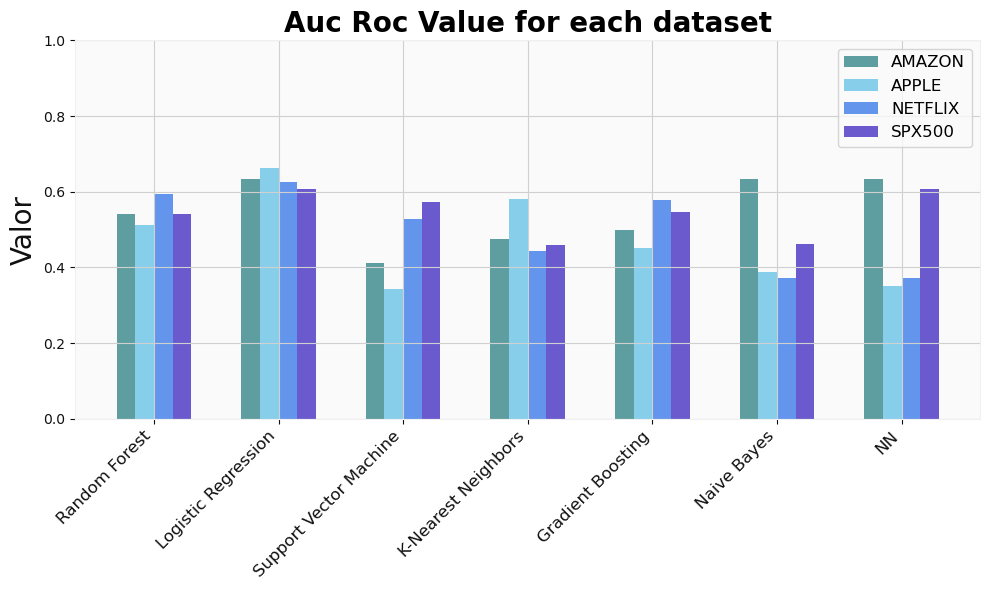

In [70]:
features = ['Open', 'Close', 'High', 'Low']
target = ['Next Candle UpBar']

predicted_values, roc_curve_ = run_forecast_classification(datasets, features, target, 'original')
plot_auc_roc(roc_curve_, 'original')

Now let's try the same including the NS candles, and compare both results.

[STATUS] Using Amazon Dataset
3/3 [==============================] - 0s 3ms/step - loss: 1.0199 - accuracy: 0.5000
Validation Accuracy: 0.5
3/3 [==============================] - 0s 3ms/step
ROC AUC: 0.6336565096952909
Optimal Threshold: 0.13


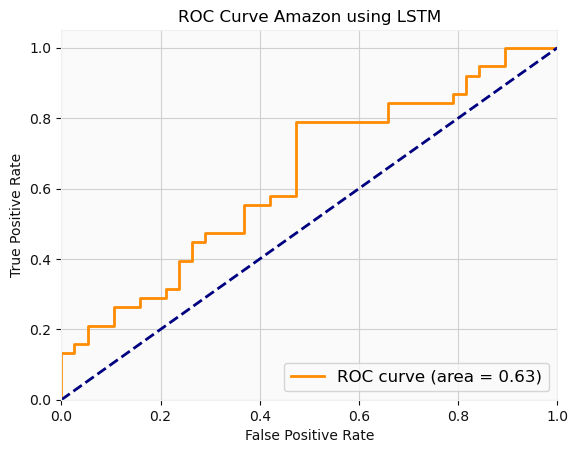

3/3 [==============================] - 0s 3ms/step - loss: 1.0064 - accuracy: 0.5000
Validation Accuracy (Optimal Threshold): 0.5
3/3 [==============================] - 0s 2ms/step
[STATUS] Using Apple Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.7149 - accuracy: 0.5000
Validation Accuracy: 0.5
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.46739130434782605
Optimal Threshold: 0.42


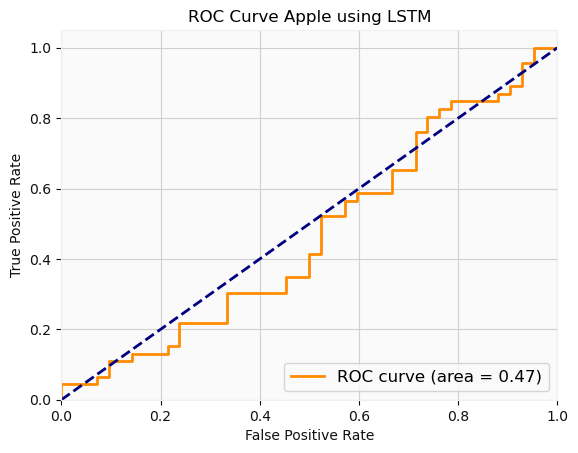

3/3 [==============================] - 0s 3ms/step - loss: 0.7027 - accuracy: 0.5000
Validation Accuracy (Optimal Threshold): 0.5
3/3 [==============================] - 0s 2ms/step
[STATUS] Using Netflix Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.6979 - accuracy: 0.5568
Validation Accuracy: 0.5568181872367859
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.3704866562009419
Optimal Threshold: 0.52


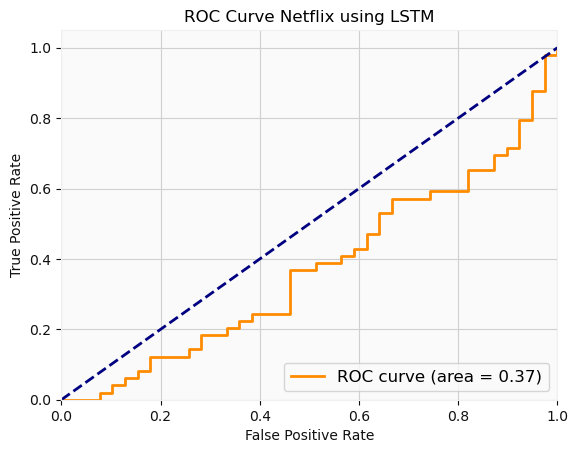

3/3 [==============================] - 0s 3ms/step - loss: 0.6938 - accuracy: 0.5568
Validation Accuracy (Optimal Threshold): 0.5568181872367859
3/3 [==============================] - 0s 2ms/step
[STATUS] Using SPX500 Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.8124 - accuracy: 0.3409
Validation Accuracy: 0.34090909361839294
3/3 [==============================] - 0s 3ms/step
ROC AUC: 0.5234861346915676
Optimal Threshold: 0.40


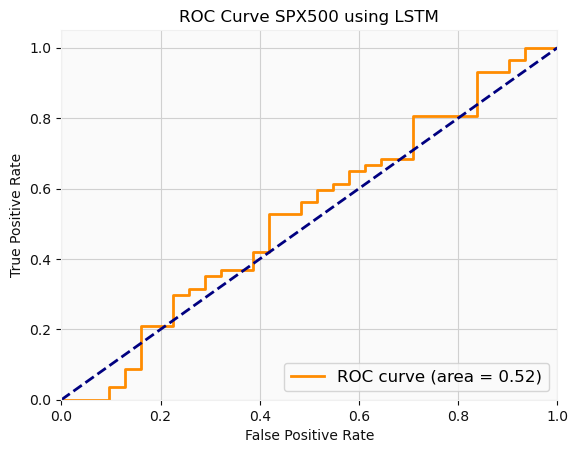

3/3 [==============================] - 0s 3ms/step - loss: 0.7985 - accuracy: 0.3409
Validation Accuracy (Optimal Threshold): 0.34090909361839294
3/3 [==============================] - 0s 3ms/step
[STATUS] Using AMAZON Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.503808864265928, Optimal Threshold: 0.1


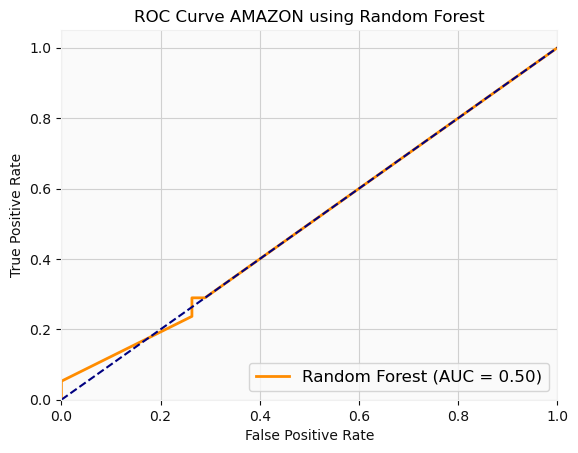

[STATUS] Using APPLE Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5028467908902692, Optimal Threshold: 0.67


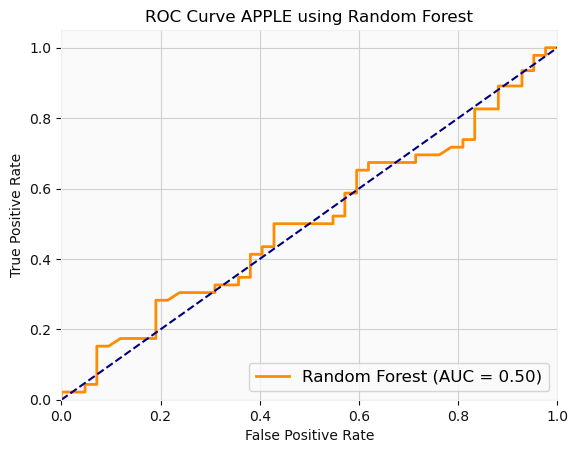

[STATUS] Using NETFLIX Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.6182626896912611, Optimal Threshold: 0.428


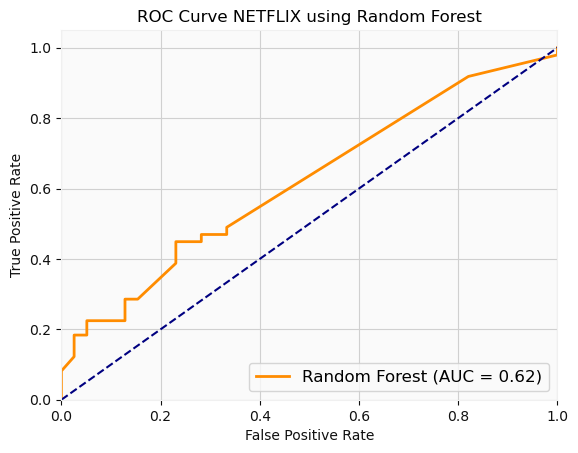

[STATUS] Using SPX500 Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.49462365591397844, Optimal Threshold: 0.149


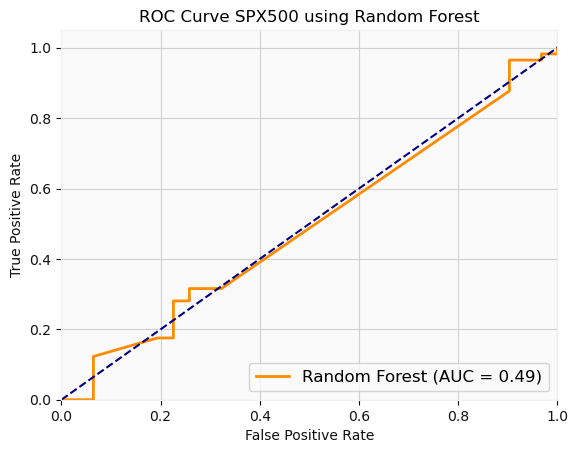

[STATUS] Using AMAZON Dataset
Logistic Regression - ROC AUC: 0.5637119113573407, Optimal Threshold: 0.42630546041568346


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


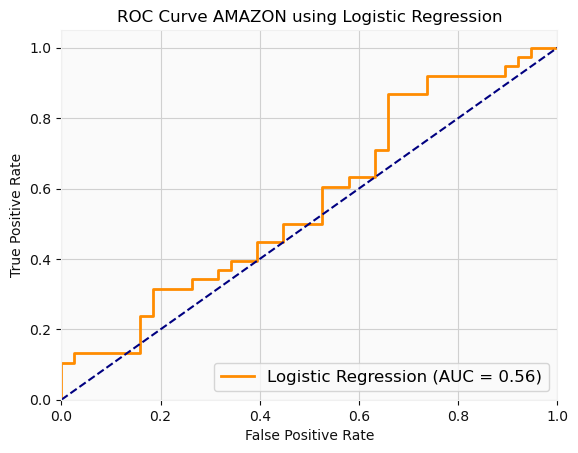

[STATUS] Using APPLE Dataset
Logistic Regression - ROC AUC: 0.650103519668737, Optimal Threshold: 0.49708181250032896


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


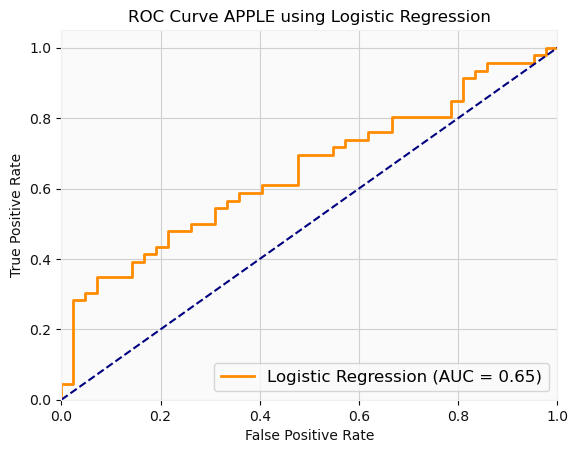

[STATUS] Using NETFLIX Dataset
Logistic Regression - ROC AUC: 0.6342229199372056, Optimal Threshold: 0.47094428786406406


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


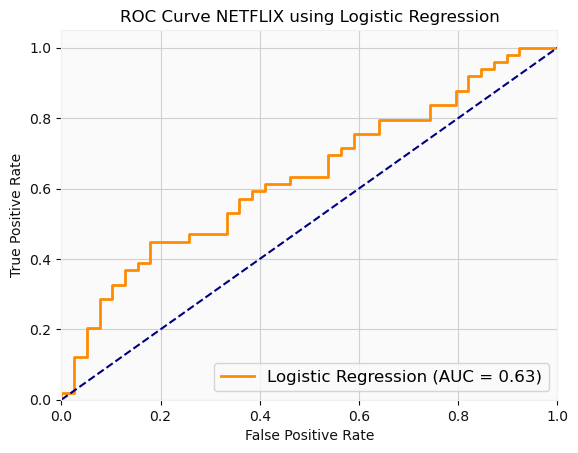

[STATUS] Using SPX500 Dataset
Logistic Regression - ROC AUC: 0.5268817204301075, Optimal Threshold: 0.40006278659373684


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


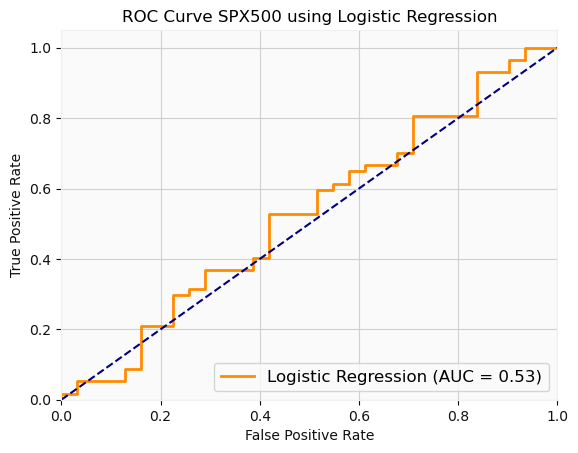

[STATUS] Using AMAZON Dataset
Support Vector Machine - ROC AUC: 0.44806094182825484, Optimal Threshold: 0.4734051272600649


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


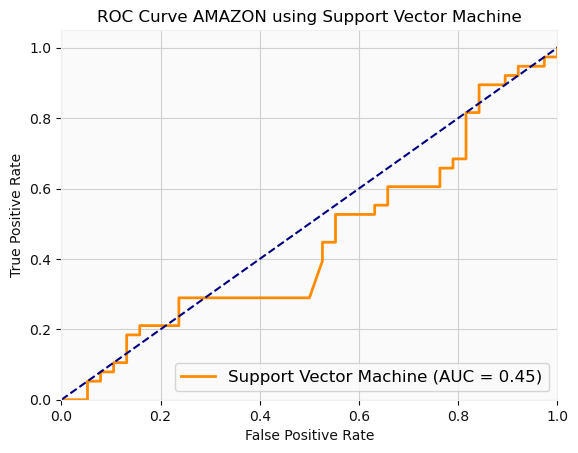

[STATUS] Using APPLE Dataset
Support Vector Machine - ROC AUC: 0.41718426501035194, Optimal Threshold: 0.49469702080490385


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


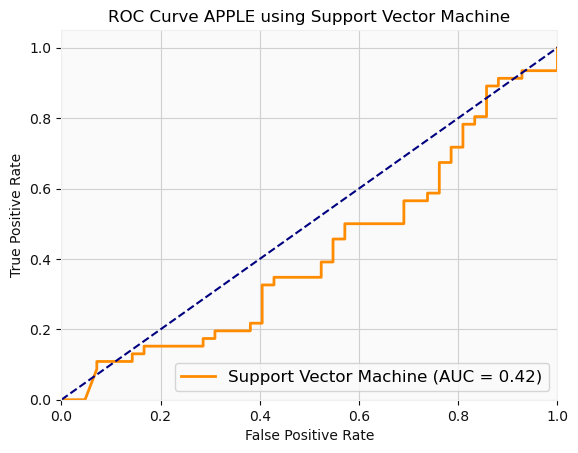

[STATUS] Using NETFLIX Dataset
Support Vector Machine - ROC AUC: 0.5484039769754055, Optimal Threshold: 0.5242747886831332


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


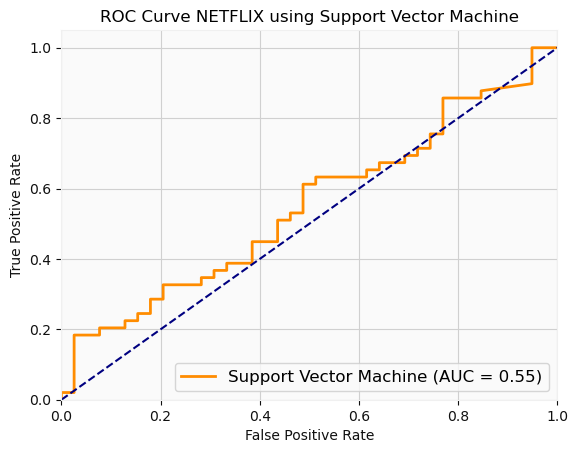

[STATUS] Using SPX500 Dataset
Support Vector Machine - ROC AUC: 0.422184493491794, Optimal Threshold: 0.44679780320637236


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


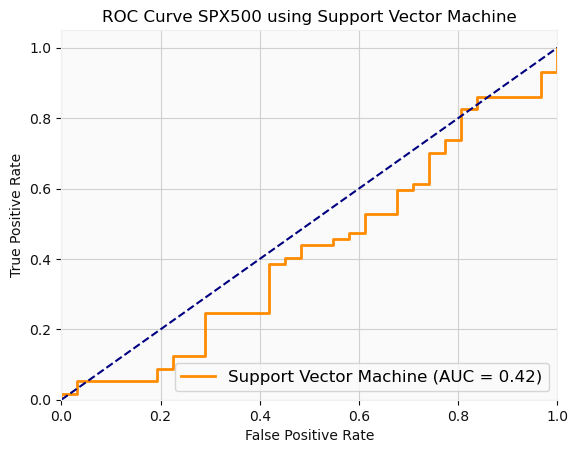

[STATUS] Using AMAZON Dataset
K-Nearest Neighbors - ROC AUC: 0.5, Optimal Threshold: inf


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


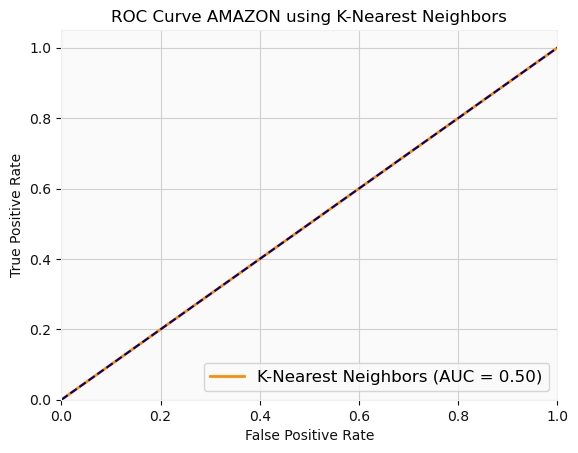

[STATUS] Using APPLE Dataset
K-Nearest Neighbors - ROC AUC: 0.526656314699793, Optimal Threshold: 0.4


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


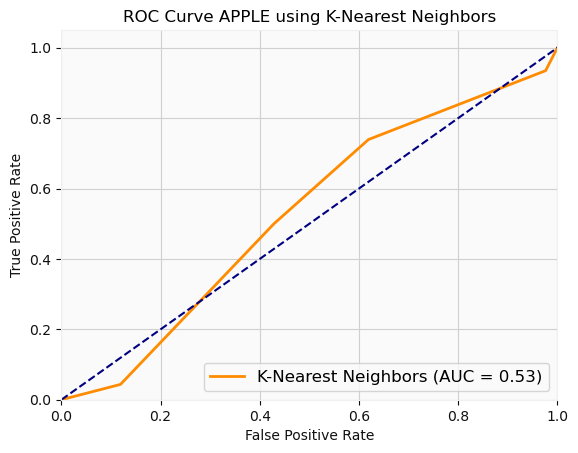

[STATUS] Using NETFLIX Dataset
K-Nearest Neighbors - ROC AUC: 0.4887493458922031, Optimal Threshold: 0.8


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


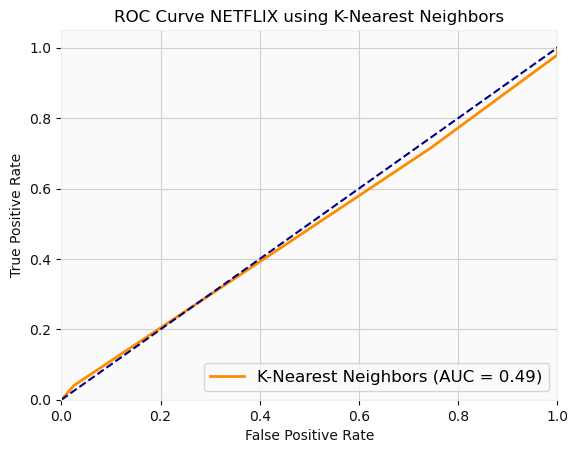

[STATUS] Using SPX500 Dataset
K-Nearest Neighbors - ROC AUC: 0.39728353140916794, Optimal Threshold: inf


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


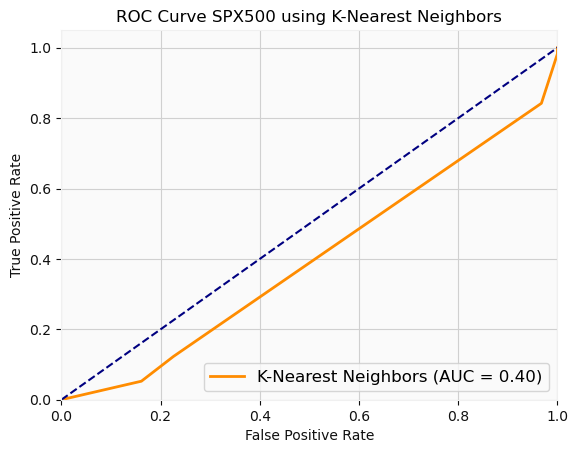

[STATUS] Using AMAZON Dataset
Gradient Boosting - ROC AUC: 0.5263157894736842, Optimal Threshold: 0.055412016653683824


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


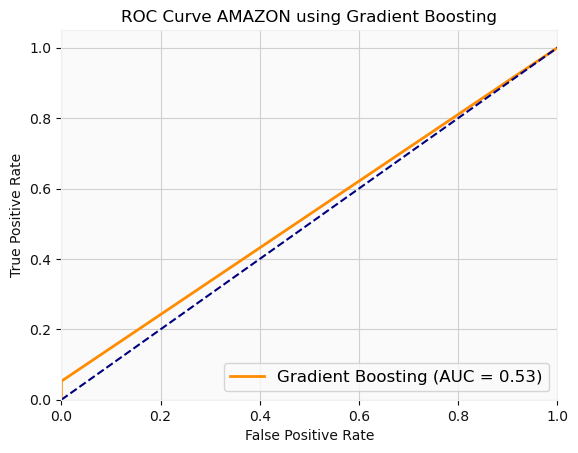

[STATUS] Using APPLE Dataset
Gradient Boosting - ROC AUC: 0.47644927536231885, Optimal Threshold: 0.6037287947416209


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


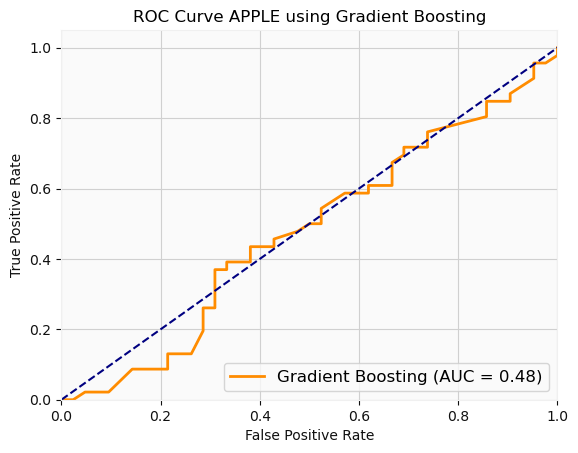

[STATUS] Using NETFLIX Dataset
Gradient Boosting - ROC AUC: 0.5782312925170069, Optimal Threshold: 0.5772357243230192


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


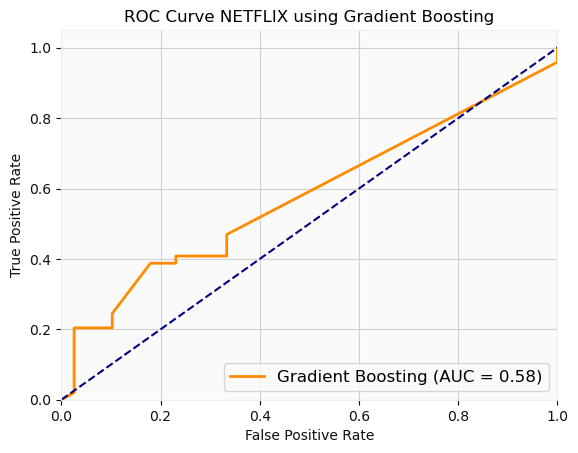

[STATUS] Using SPX500 Dataset
Gradient Boosting - ROC AUC: 0.49915110356536496, Optimal Threshold: 0.12123859558132088


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


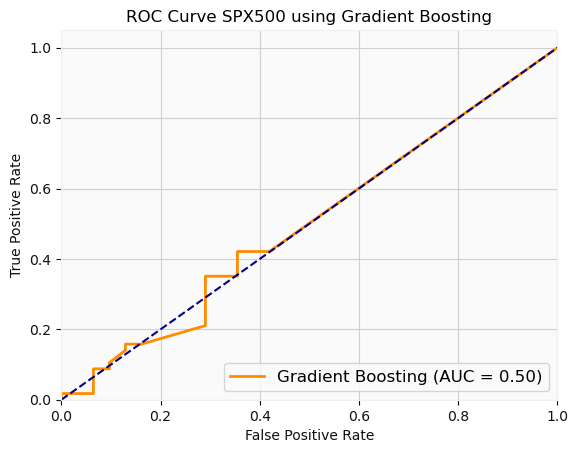

[STATUS] Using AMAZON Dataset
Naive Bayes - ROC AUC: 0.6184210526315789, Optimal Threshold: 0.16720755871871246


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


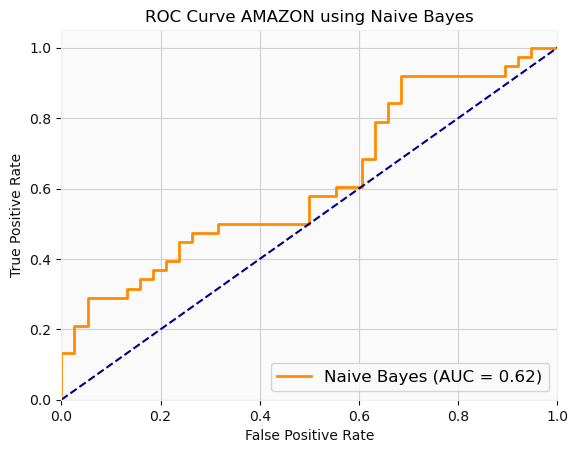

[STATUS] Using APPLE Dataset
Naive Bayes - ROC AUC: 0.4575569358178054, Optimal Threshold: 0.41564804175939063


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


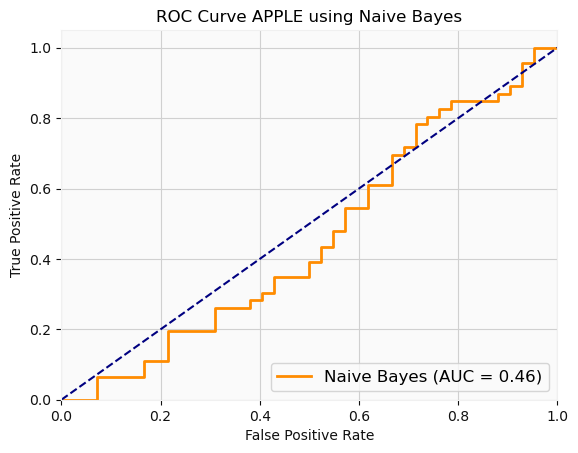

[STATUS] Using NETFLIX Dataset
Naive Bayes - ROC AUC: 0.3851386708529566, Optimal Threshold: 0.4054681120588657


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


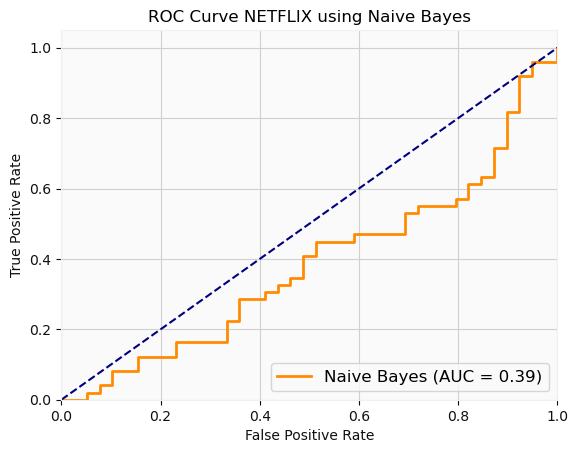

[STATUS] Using SPX500 Dataset
Naive Bayes - ROC AUC: 0.4567062818336163, Optimal Threshold: 0.20959406641727182


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


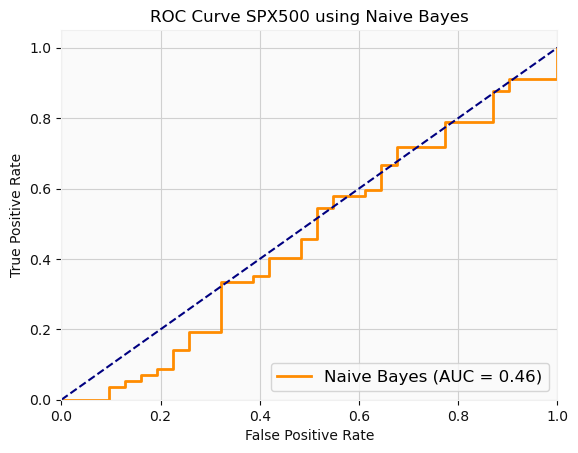

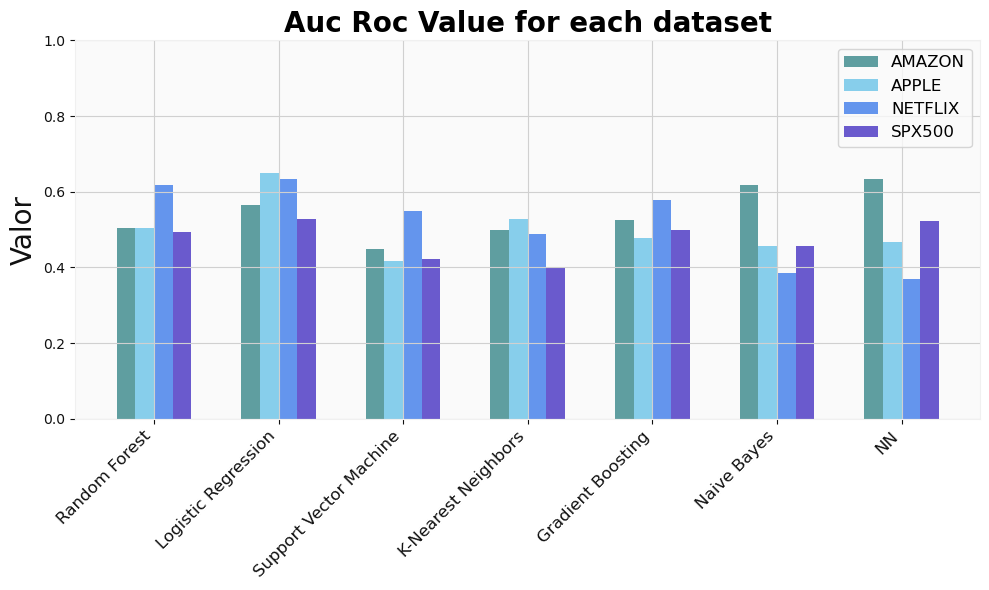

In [71]:
features = ['Open', 'Close', 'High', 'Low', 'NS']
target = ['Next Candle UpBar']

predicted_values_with_NS, curve_roc_ = run_forecast_classification(datasets, features, target, 'ns')
plot_auc_roc(curve_roc_, 'ns')

Now let's try the same but with the ND candles. The expected with this type of candles is that the price will drop after it. Let's see if the model can predict it.

[STATUS] Using Amazon Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.9361 - accuracy: 0.5000
Validation Accuracy: 0.5
3/3 [==============================] - 0s 3ms/step
ROC AUC: 0.6225761772853186
Optimal Threshold: 0.08


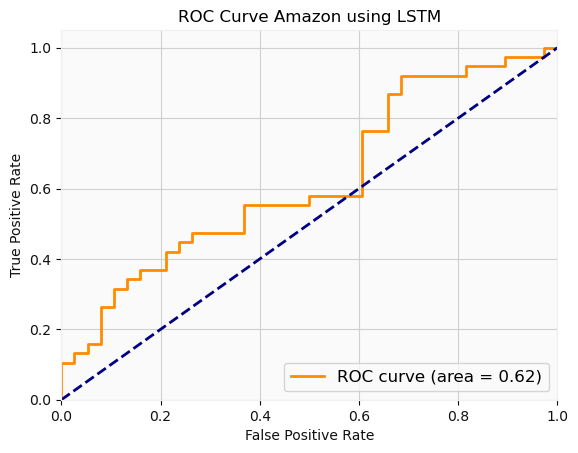

3/3 [==============================] - 0s 3ms/step - loss: 0.9961 - accuracy: 0.5000
Validation Accuracy (Optimal Threshold): 0.5
3/3 [==============================] - 0s 2ms/step
[STATUS] Using Apple Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.7017 - accuracy: 0.5682
Validation Accuracy: 0.5681818127632141
3/3 [==============================] - 0s 3ms/step
ROC AUC: 0.4968944099378882
Optimal Threshold: 0.51


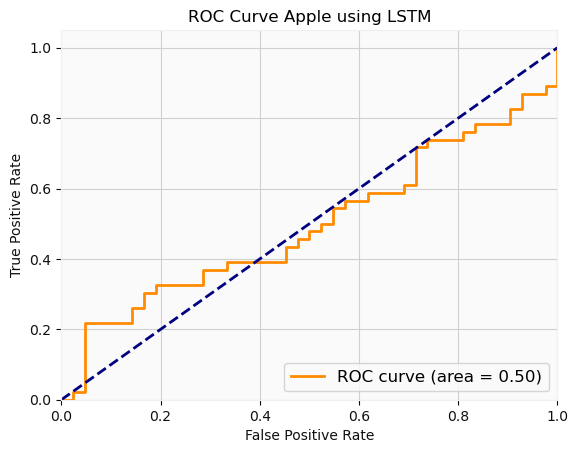

3/3 [==============================] - 0s 3ms/step - loss: 0.6908 - accuracy: 0.5795
Validation Accuracy (Optimal Threshold): 0.5795454382896423
3/3 [==============================] - 0s 2ms/step
[STATUS] Using Netflix Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.6967 - accuracy: 0.4432
Validation Accuracy: 0.4431818127632141
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.6195709052851911
Optimal Threshold: 0.49


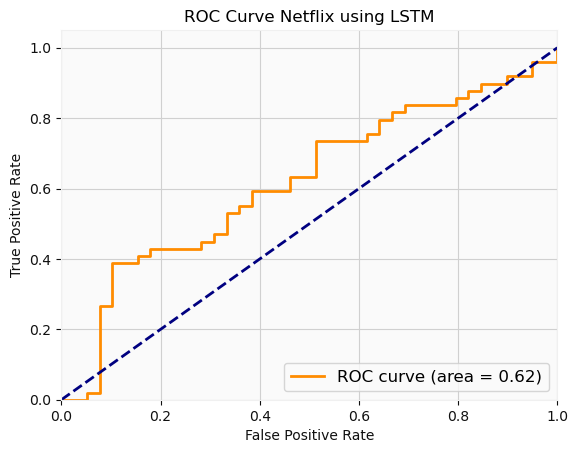

3/3 [==============================] - 0s 3ms/step - loss: 0.6967 - accuracy: 0.5682
Validation Accuracy (Optimal Threshold): 0.5681818127632141
3/3 [==============================] - 0s 3ms/step
[STATUS] Using SPX500 Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.7015 - accuracy: 0.4091
Validation Accuracy: 0.40909090638160706
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.39332201471420486
Optimal Threshold: 0.51


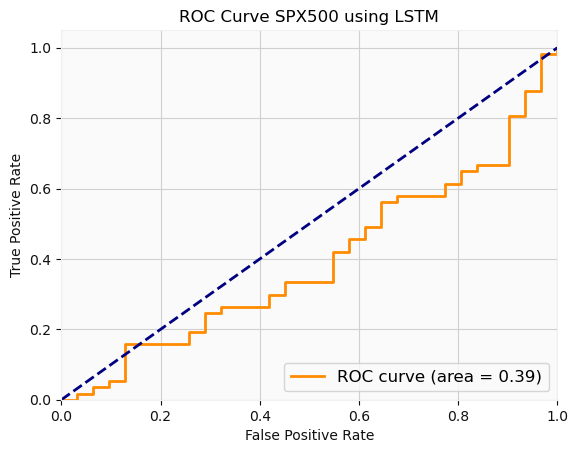

3/3 [==============================] - 0s 3ms/step - loss: 0.6906 - accuracy: 0.5909
Validation Accuracy (Optimal Threshold): 0.5909090638160706
3/3 [==============================] - 0s 2ms/step
[STATUS] Using AMAZON Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5460526315789473, Optimal Threshold: 0.077


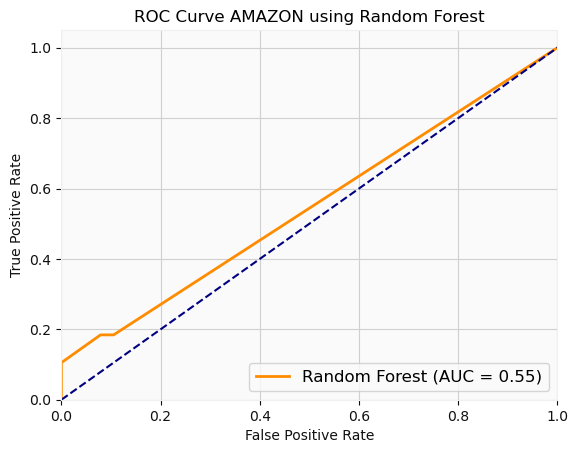

[STATUS] Using APPLE Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5313146997929606, Optimal Threshold: 0.565


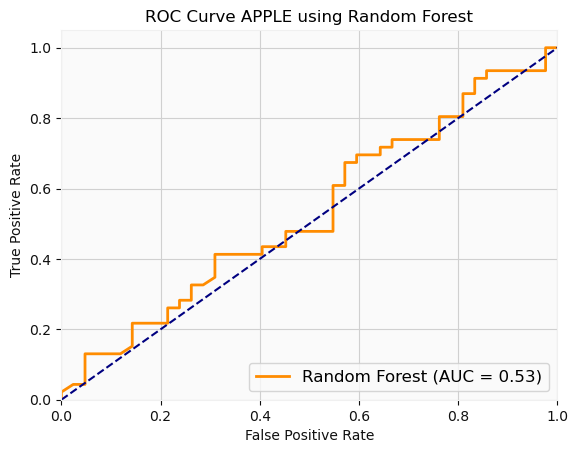

[STATUS] Using NETFLIX Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5805860805860805, Optimal Threshold: 0.43


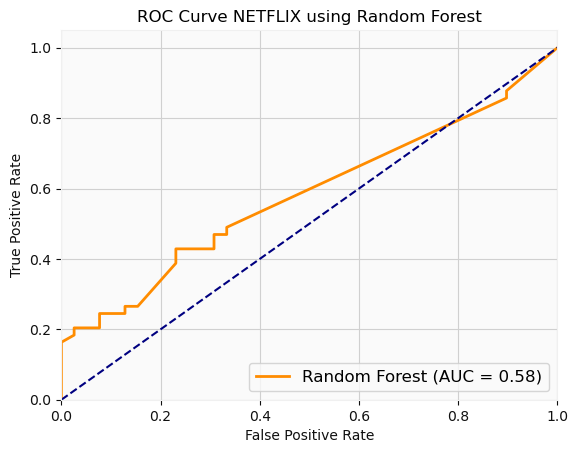

[STATUS] Using SPX500 Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5189586870401811, Optimal Threshold: 0.5


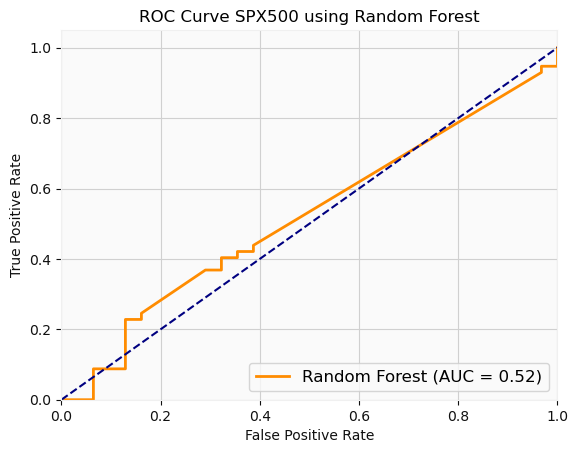

[STATUS] Using AMAZON Dataset
Logistic Regression - ROC AUC: 0.618421052631579, Optimal Threshold: 0.48050845039788076


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


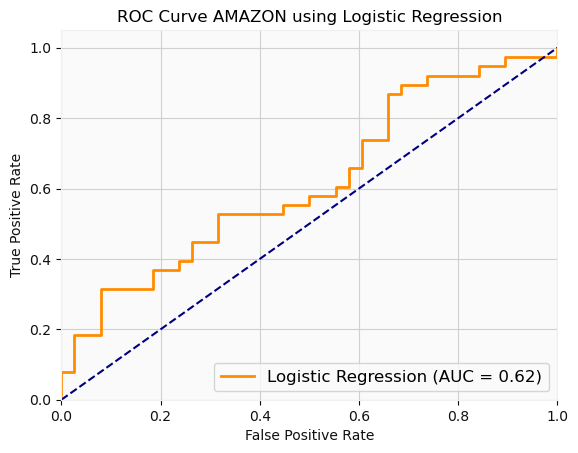

[STATUS] Using APPLE Dataset
Logistic Regression - ROC AUC: 0.6811594202898551, Optimal Threshold: 0.4640619503196802


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


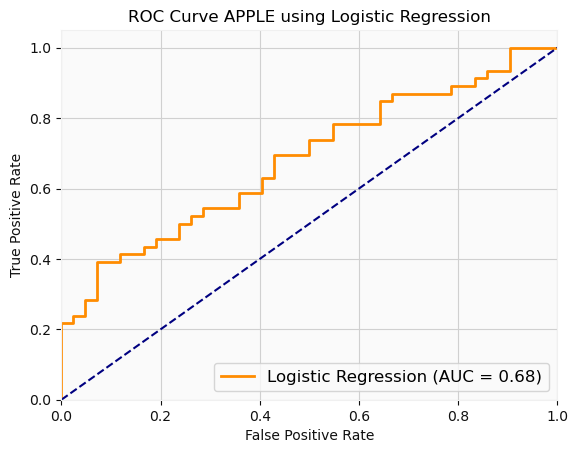

[STATUS] Using NETFLIX Dataset
Logistic Regression - ROC AUC: 0.6190476190476191, Optimal Threshold: 0.46573960385779156


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


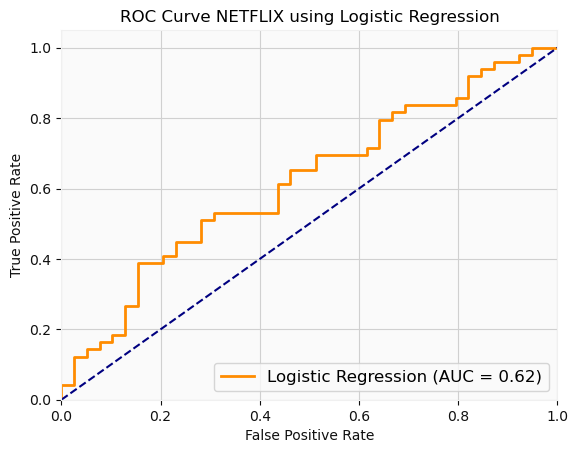

[STATUS] Using SPX500 Dataset
Logistic Regression - ROC AUC: 0.6179966044142614, Optimal Threshold: 0.4363980407355626


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


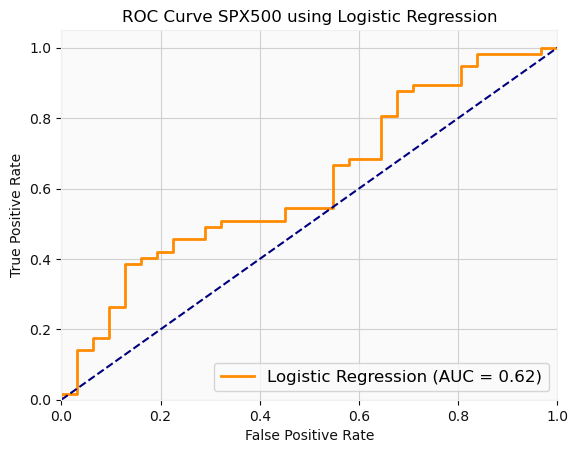

[STATUS] Using AMAZON Dataset
Support Vector Machine - ROC AUC: 0.4847645429362881, Optimal Threshold: 0.5974766677296981


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


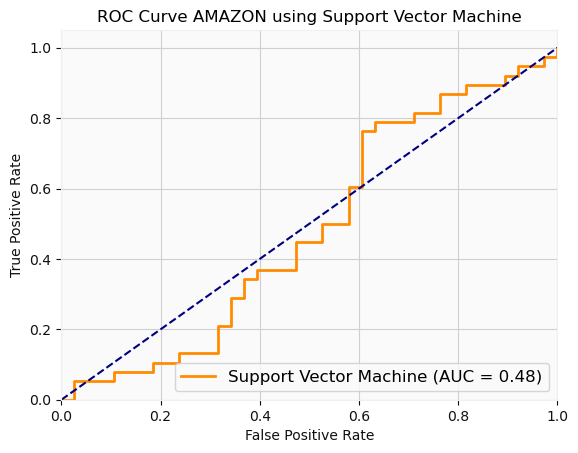

[STATUS] Using APPLE Dataset
Support Vector Machine - ROC AUC: 0.5025879917184264, Optimal Threshold: 0.486087303757048


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


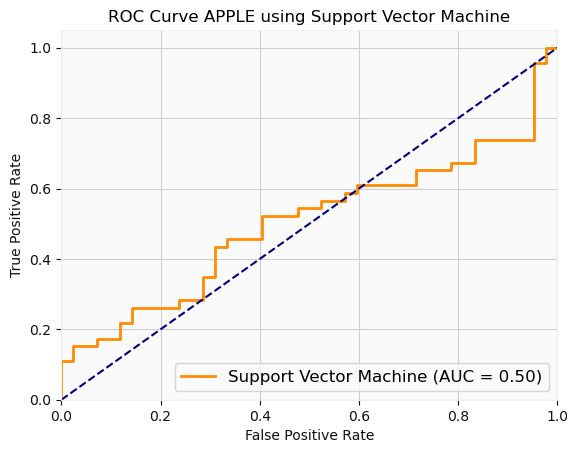

[STATUS] Using NETFLIX Dataset
Support Vector Machine - ROC AUC: 0.40450026164311875, Optimal Threshold: 0.5187997956092999


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


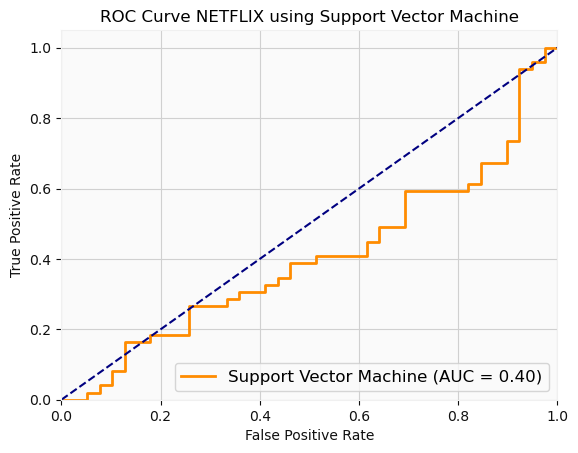

[STATUS] Using SPX500 Dataset
Support Vector Machine - ROC AUC: 0.5755517826825127, Optimal Threshold: 0.5186301362811806


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


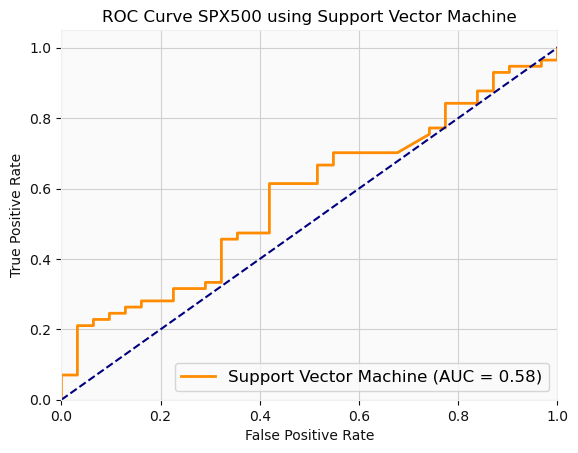

[STATUS] Using AMAZON Dataset
K-Nearest Neighbors - ROC AUC: 0.503808864265928, Optimal Threshold: 0.4


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


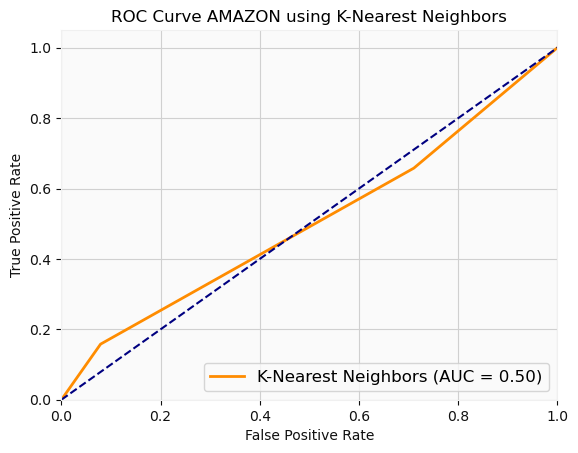

[STATUS] Using APPLE Dataset
K-Nearest Neighbors - ROC AUC: 0.6076604554865424, Optimal Threshold: 0.6


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


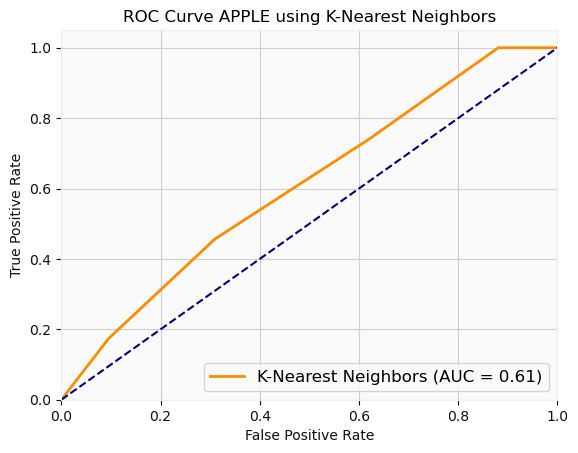

[STATUS] Using NETFLIX Dataset
K-Nearest Neighbors - ROC AUC: 0.43432757718472004, Optimal Threshold: inf


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


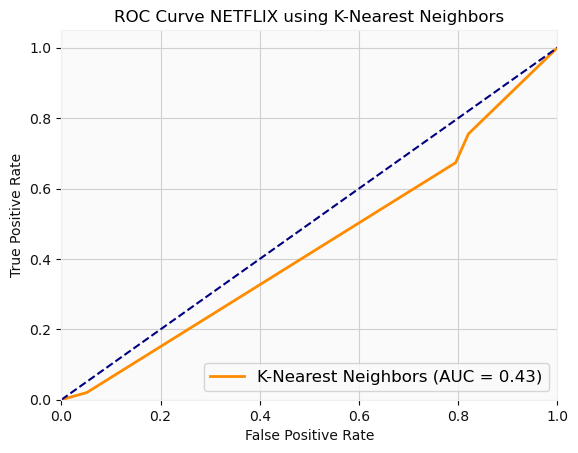

[STATUS] Using SPX500 Dataset
K-Nearest Neighbors - ROC AUC: 0.48443689869835876, Optimal Threshold: 0.4


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


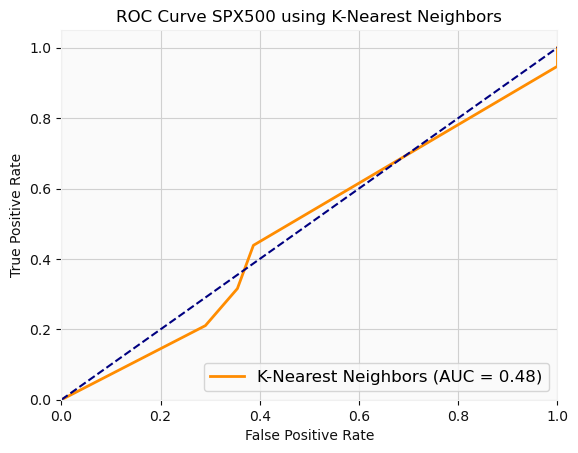

[STATUS] Using AMAZON Dataset
Gradient Boosting - ROC AUC: 0.5405124653739612, Optimal Threshold: 0.05610419036485186


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


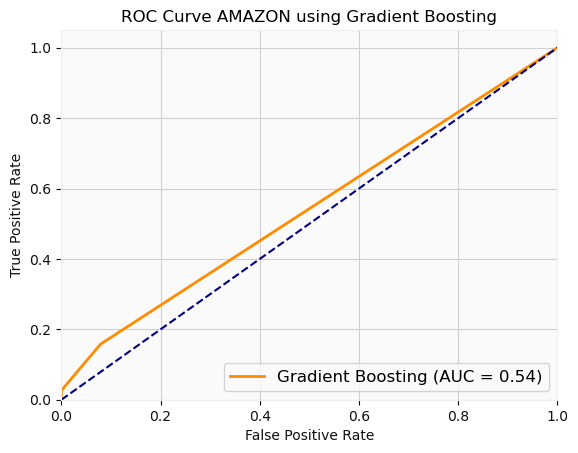

[STATUS] Using APPLE Dataset
Gradient Boosting - ROC AUC: 0.490424430641822, Optimal Threshold: 0.1822666408913892


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


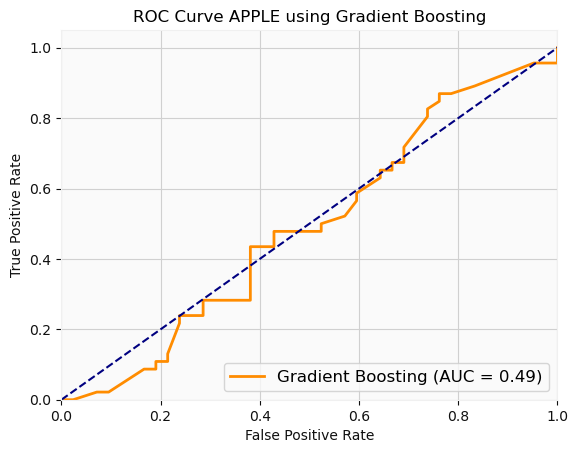

[STATUS] Using NETFLIX Dataset
Gradient Boosting - ROC AUC: 0.5847723704866561, Optimal Threshold: 0.4166437337110926


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


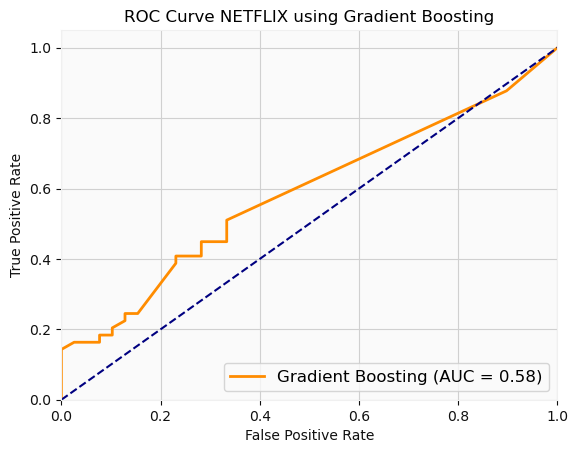

[STATUS] Using SPX500 Dataset
Gradient Boosting - ROC AUC: 0.5045274476513865, Optimal Threshold: 0.11095018418213642


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


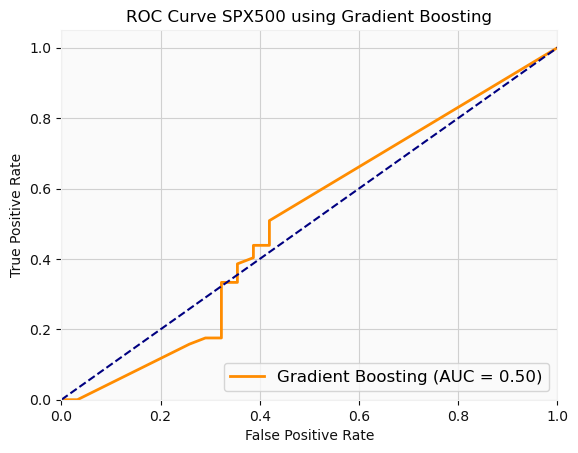

[STATUS] Using AMAZON Dataset
Naive Bayes - ROC AUC: 0.6253462603878116, Optimal Threshold: 0.17470326220603985


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


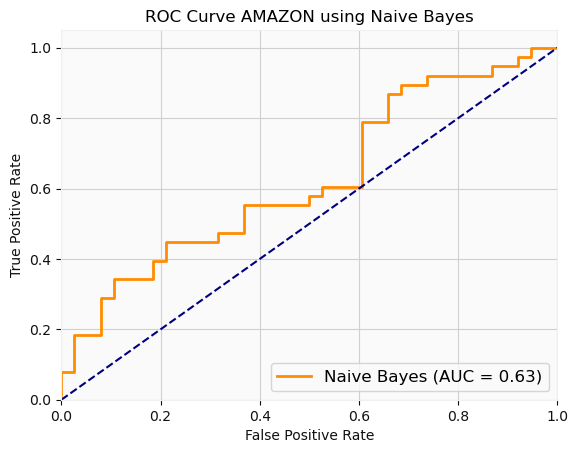

[STATUS] Using APPLE Dataset
Naive Bayes - ROC AUC: 0.5243271221532091, Optimal Threshold: 0.5920034342618444


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


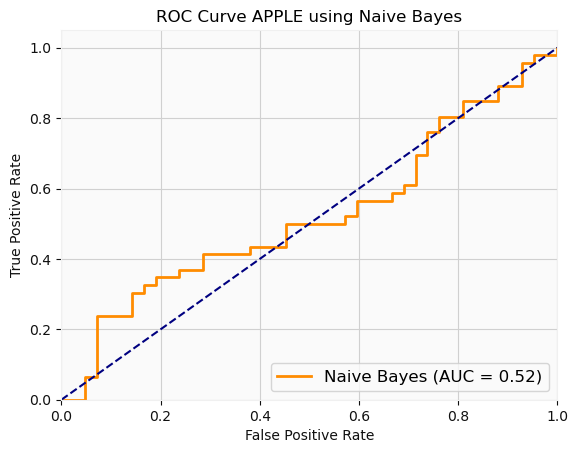

[STATUS] Using NETFLIX Dataset
Naive Bayes - ROC AUC: 0.3725798011512297, Optimal Threshold: inf


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


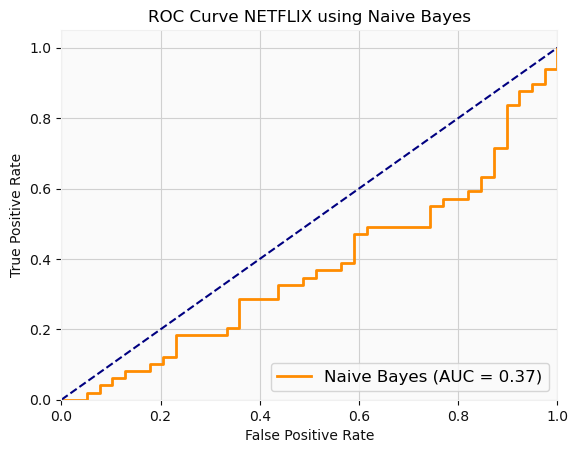

[STATUS] Using SPX500 Dataset
Naive Bayes - ROC AUC: 0.46802490096208266, Optimal Threshold: 0.2941589341091097


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


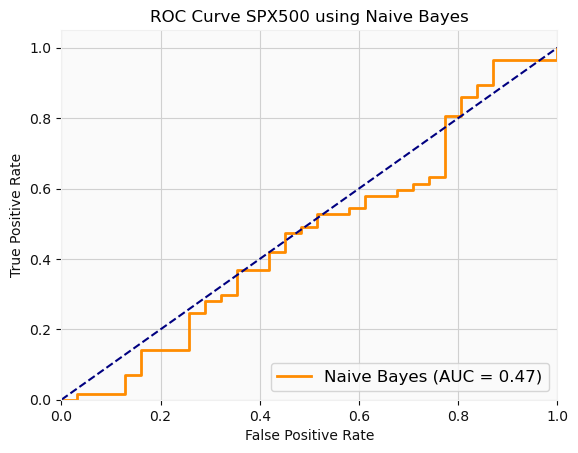

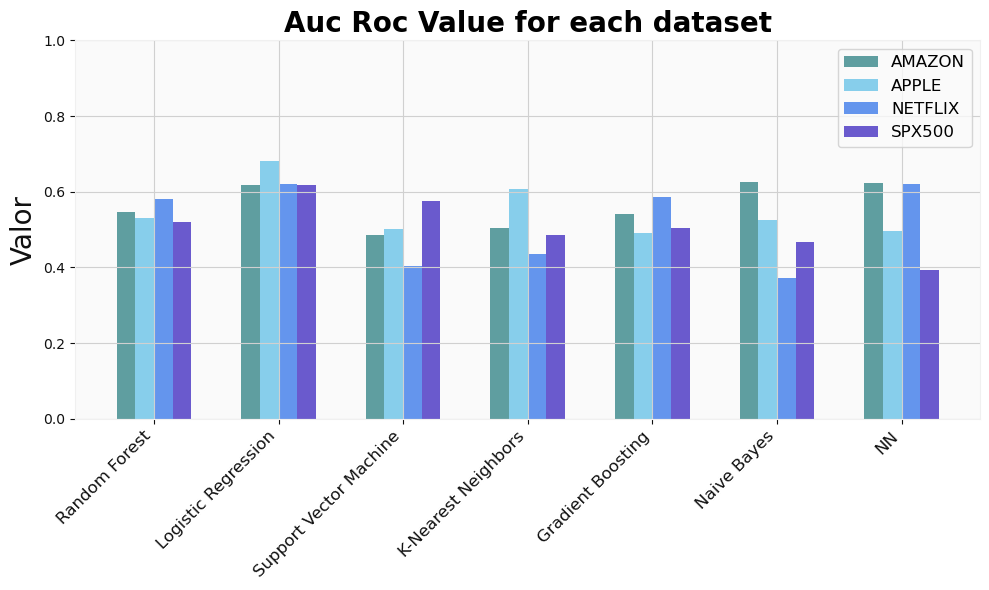

In [72]:
features = ['Open', 'Close', 'High', 'Low', 'ND']
target = ['Next Candle UpBar']

predicted_values_with_ND, curve_roc_ = run_forecast_classification(datasets, features, target, 'nd')
plot_auc_roc(curve_roc_, 'nd')

Finally, let's try to implement both NS and ND and see if there's any improvement.

[STATUS] Using Amazon Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.9436 - accuracy: 0.5000
Validation Accuracy: 0.5
3/3 [==============================] - 0s 3ms/step
ROC AUC: 0.6295013850415512
Optimal Threshold: 0.17


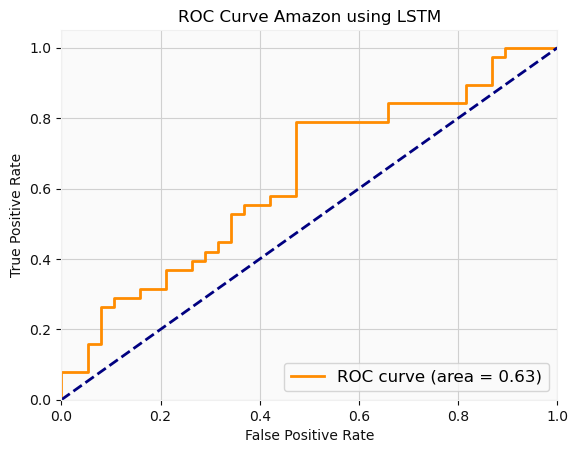

3/3 [==============================] - 0s 3ms/step - loss: 0.8672 - accuracy: 0.5000
Validation Accuracy (Optimal Threshold): 0.5
3/3 [==============================] - 0s 2ms/step
[STATUS] Using Apple Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.7044 - accuracy: 0.5341
Validation Accuracy: 0.5340909361839294
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.4984472049689441
Optimal Threshold: 0.49


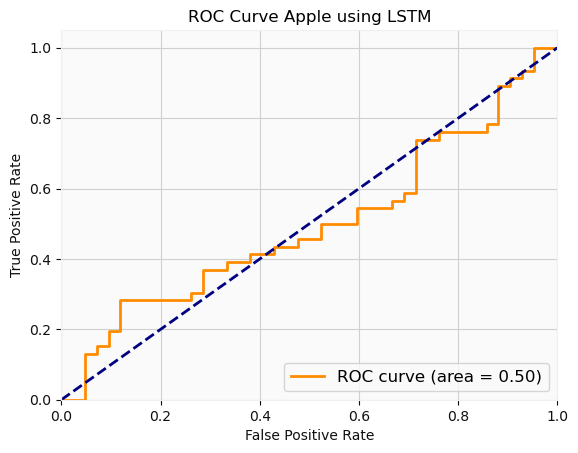

3/3 [==============================] - 0s 3ms/step - loss: 0.7174 - accuracy: 0.4659
Validation Accuracy (Optimal Threshold): 0.46590909361839294
3/3 [==============================] - 0s 3ms/step
[STATUS] Using Netflix Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.6961 - accuracy: 0.5227
Validation Accuracy: 0.5227272510528564
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.4076399790685505
Optimal Threshold: 0.50


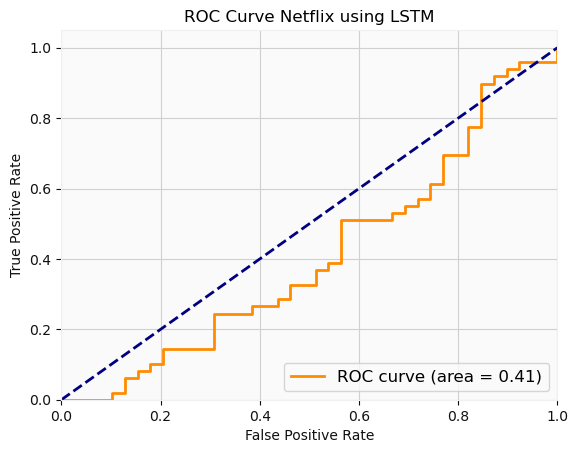

3/3 [==============================] - 0s 3ms/step - loss: 0.7008 - accuracy: 0.5568
Validation Accuracy (Optimal Threshold): 0.5568181872367859
3/3 [==============================] - 0s 2ms/step
[STATUS] Using SPX500 Dataset
3/3 [==============================] - 0s 3ms/step - loss: 0.9289 - accuracy: 0.3977
Validation Accuracy: 0.39772728085517883
3/3 [==============================] - 0s 2ms/step
ROC AUC: 0.42388228636106395
Optimal Threshold: 0.29


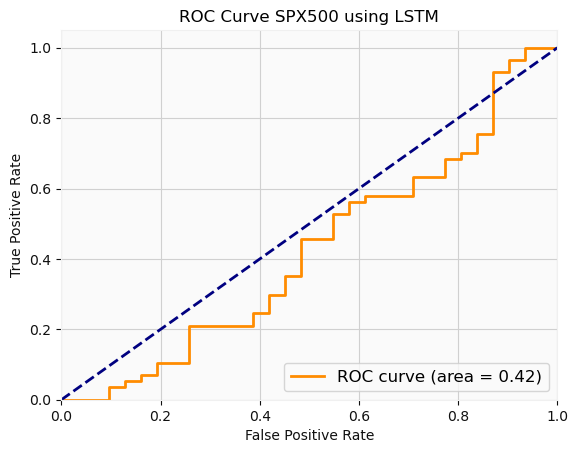

3/3 [==============================] - 0s 3ms/step - loss: 1.0422 - accuracy: 0.3750
Validation Accuracy (Optimal Threshold): 0.375
3/3 [==============================] - 0s 2ms/step
[STATUS] Using AMAZON Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5107340720221607, Optimal Threshold: 0.104


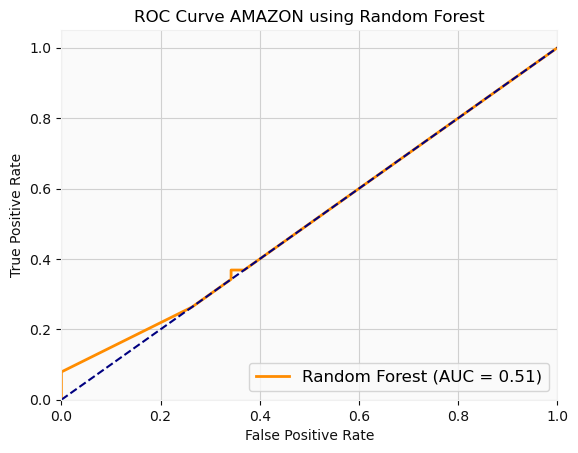

[STATUS] Using APPLE Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5134575569358177, Optimal Threshold: 0.244


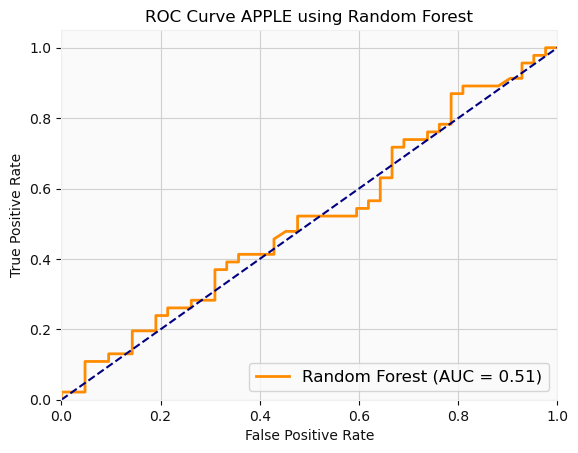

[STATUS] Using NETFLIX Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.5957613814756672, Optimal Threshold: 0.378


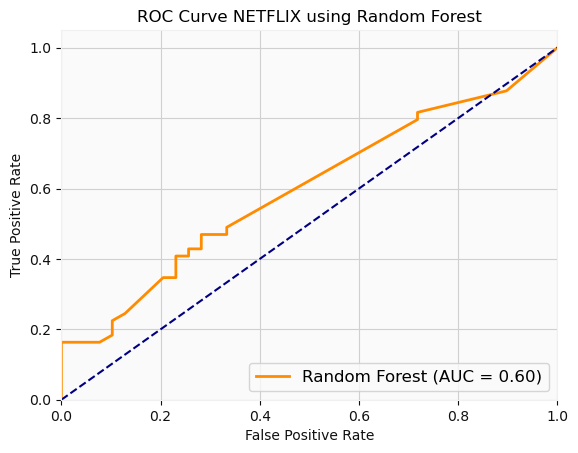

[STATUS] Using SPX500 Dataset


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/base.py:1152: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Random Forest - ROC AUC: 0.43859649122807015, Optimal Threshold: 0.624


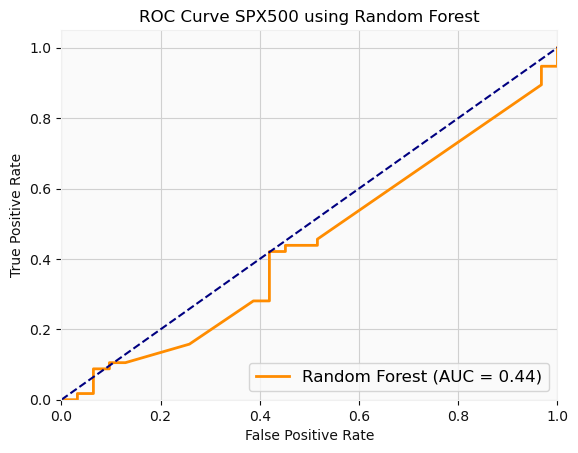

[STATUS] Using AMAZON Dataset
Logistic Regression - ROC AUC: 0.5540166204986149, Optimal Threshold: 0.4001446680005701


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


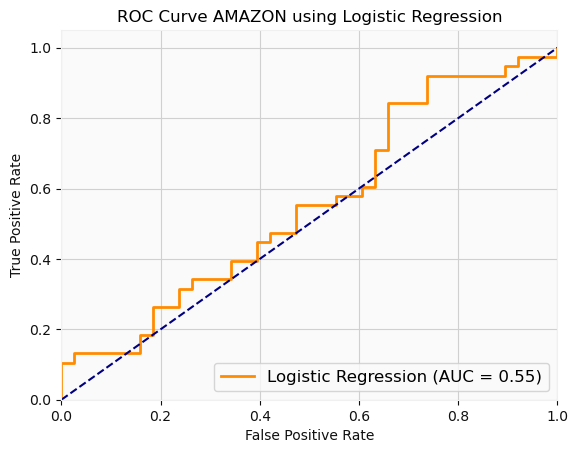

[STATUS] Using APPLE Dataset
Logistic Regression - ROC AUC: 0.673913043478261, Optimal Threshold: 0.4947152773911818


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


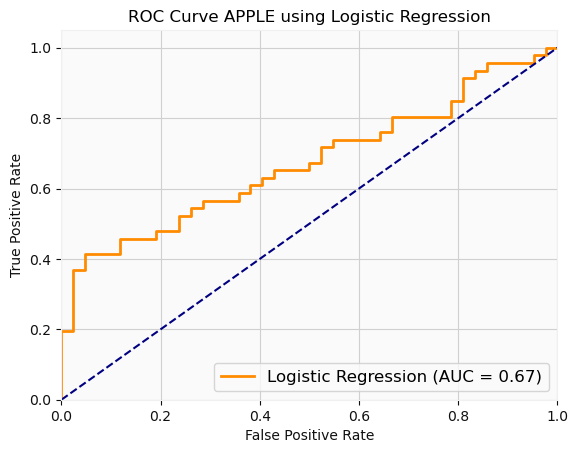

[STATUS] Using NETFLIX Dataset
Logistic Regression - ROC AUC: 0.6378859236002093, Optimal Threshold: 0.47149868849157806


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


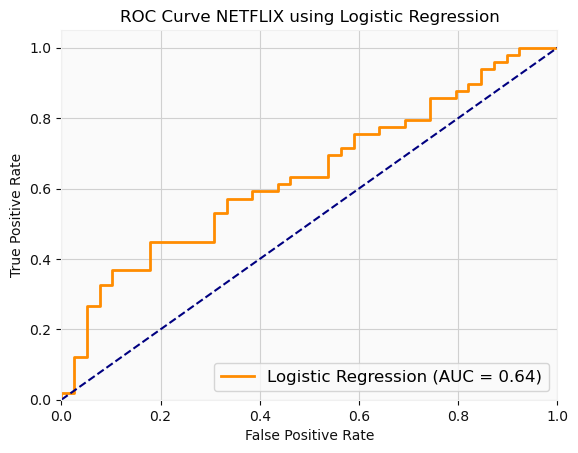

[STATUS] Using SPX500 Dataset
Logistic Regression - ROC AUC: 0.5314091680814941, Optimal Threshold: 0.4197249817363271


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


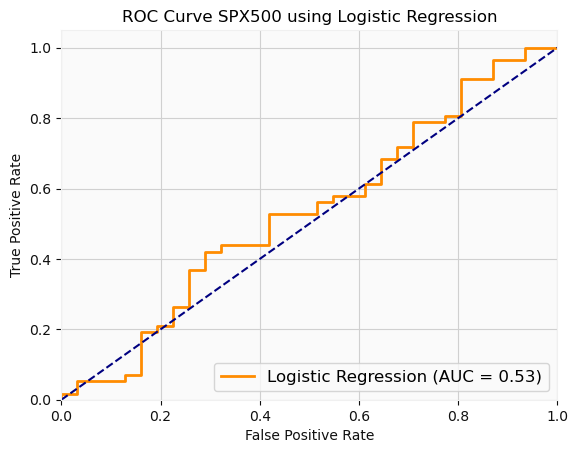

[STATUS] Using AMAZON Dataset
Support Vector Machine - ROC AUC: 0.49722991689750695, Optimal Threshold: 0.7757517680240132


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


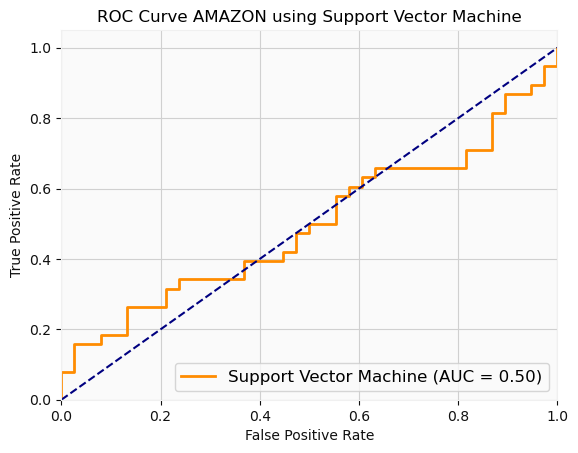

[STATUS] Using APPLE Dataset
Support Vector Machine - ROC AUC: 0.40786749482401663, Optimal Threshold: 0.5137757865514228


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


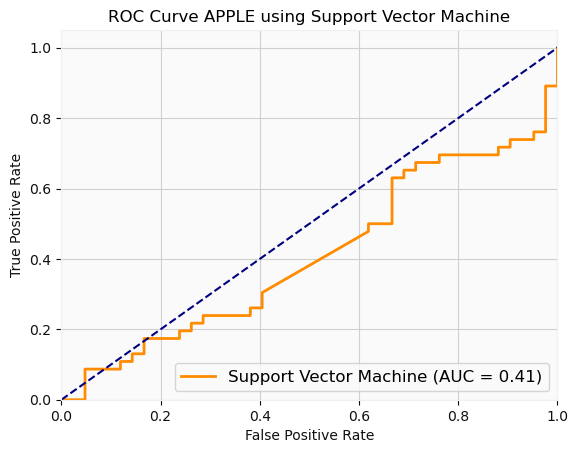

[STATUS] Using NETFLIX Dataset
Support Vector Machine - ROC AUC: 0.46284667713239147, Optimal Threshold: 0.41575416600948684


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


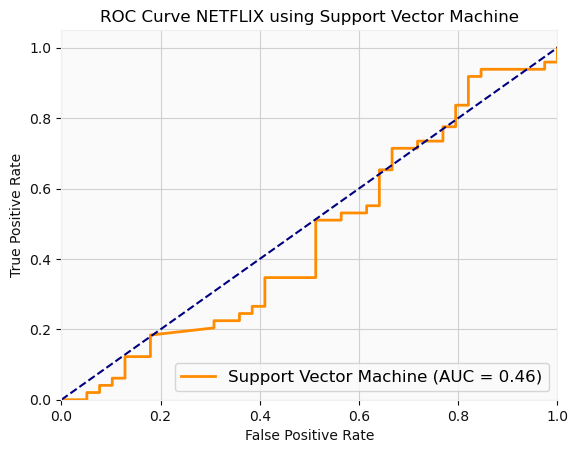

[STATUS] Using SPX500 Dataset
Support Vector Machine - ROC AUC: 0.4153933220147142, Optimal Threshold: 0.5612441399690048


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


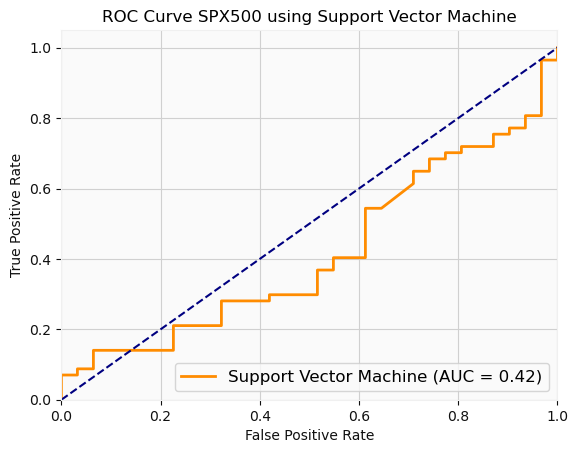

[STATUS] Using AMAZON Dataset
K-Nearest Neighbors - ROC AUC: 0.5263157894736842, Optimal Threshold: 0.4


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


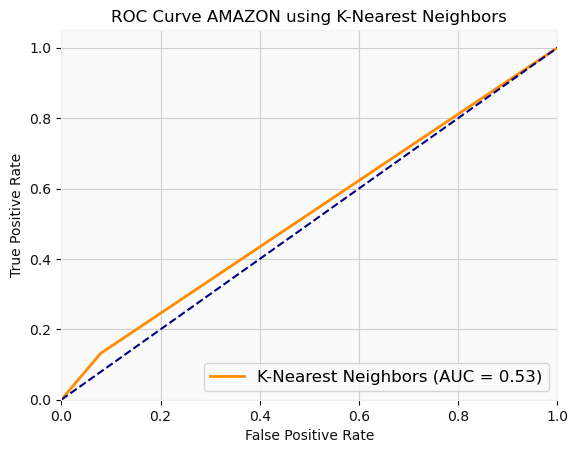

[STATUS] Using APPLE Dataset
K-Nearest Neighbors - ROC AUC: 0.514751552795031, Optimal Threshold: 0.2


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


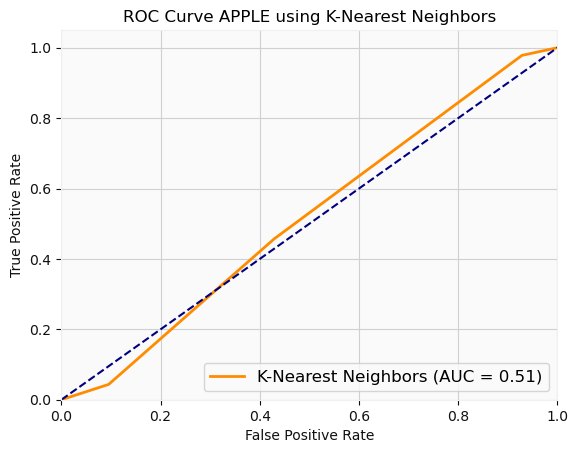

[STATUS] Using NETFLIX Dataset
K-Nearest Neighbors - ROC AUC: 0.48403976975405544, Optimal Threshold: 0.4


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


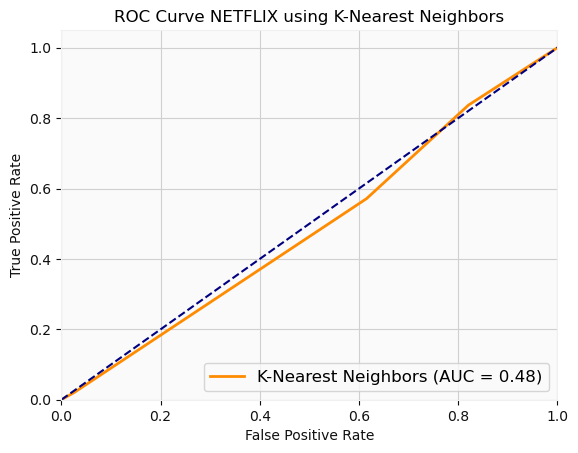

[STATUS] Using SPX500 Dataset
K-Nearest Neighbors - ROC AUC: 0.4298245614035088, Optimal Threshold: inf


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_classification.py:233: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


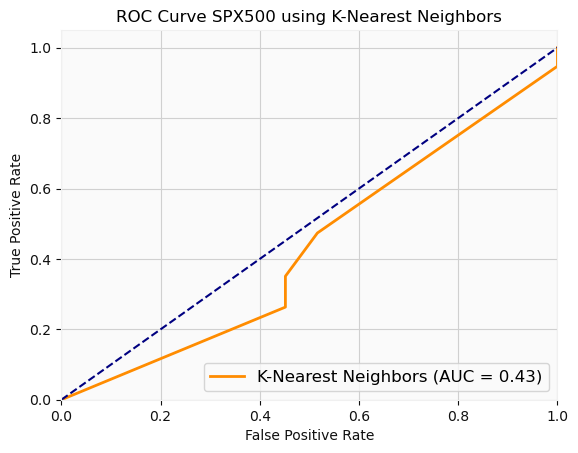

[STATUS] Using AMAZON Dataset
Gradient Boosting - ROC AUC: 0.5145429362880887, Optimal Threshold: 0.0555128961027065


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


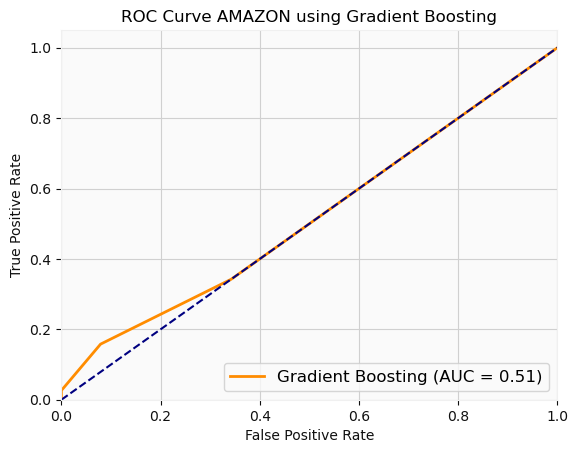

[STATUS] Using APPLE Dataset
Gradient Boosting - ROC AUC: 0.4855072463768116, Optimal Threshold: 0.18921443117607678


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


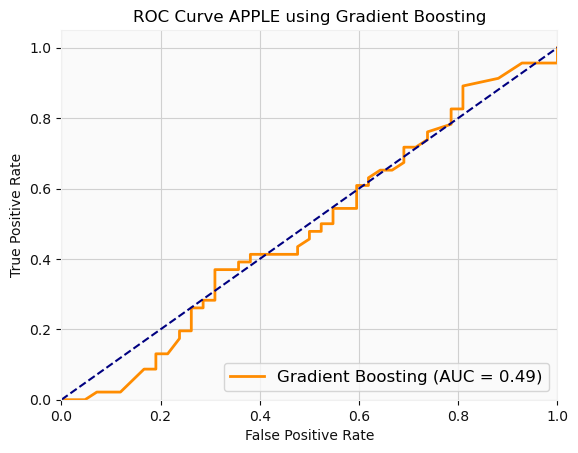

[STATUS] Using NETFLIX Dataset
Gradient Boosting - ROC AUC: 0.5944531658817372, Optimal Threshold: 0.33095696555837995


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


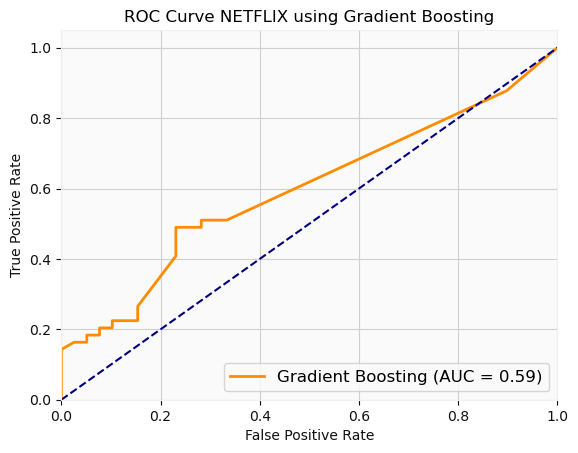

[STATUS] Using SPX500 Dataset
Gradient Boosting - ROC AUC: 0.4731182795698925, Optimal Threshold: 0.1601370057371669


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/ensemble/_gb.py:424: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


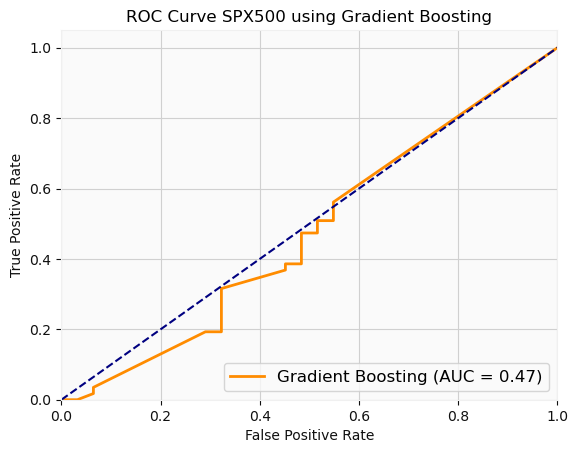

[STATUS] Using AMAZON Dataset
Naive Bayes - ROC AUC: 0.6108033240997229, Optimal Threshold: 0.12754141390095425


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


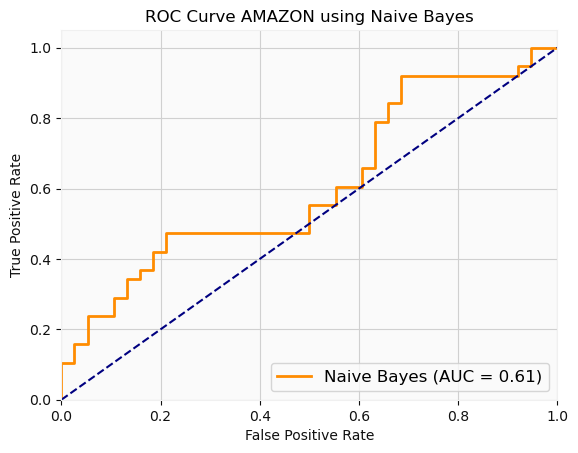

[STATUS] Using APPLE Dataset
Naive Bayes - ROC AUC: 0.5553830227743272, Optimal Threshold: 0.5342103442490791


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


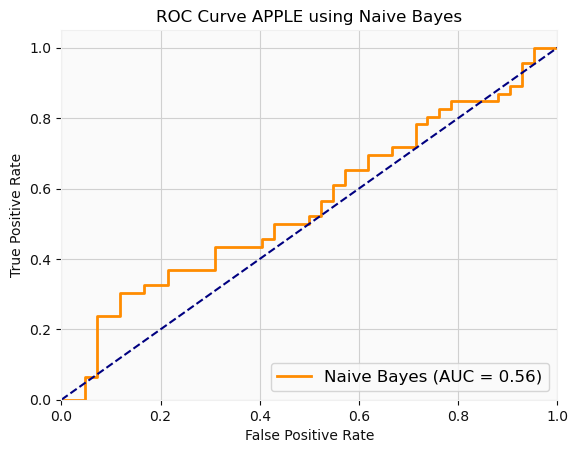

[STATUS] Using NETFLIX Dataset
Naive Bayes - ROC AUC: 0.38356881214024074, Optimal Threshold: 0.40402863317391174


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


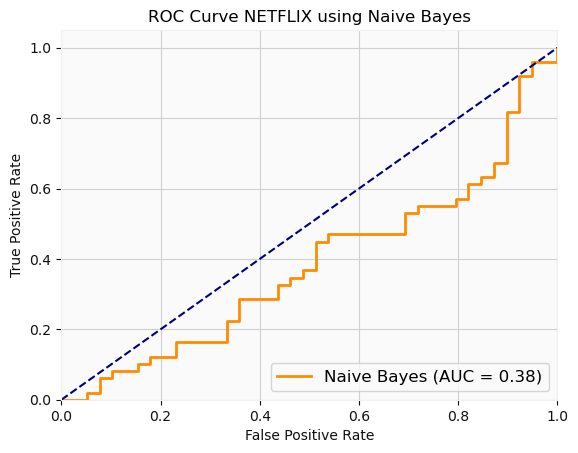

[STATUS] Using SPX500 Dataset
Naive Bayes - ROC AUC: 0.4629315223542728, Optimal Threshold: 0.1850943568836134


/home/marc/anaconda3/lib/python3.11/site-packages/sklearn/utils/validation.py:1183: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


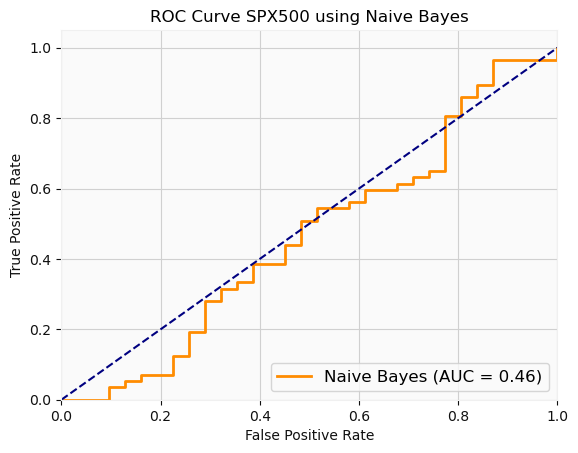

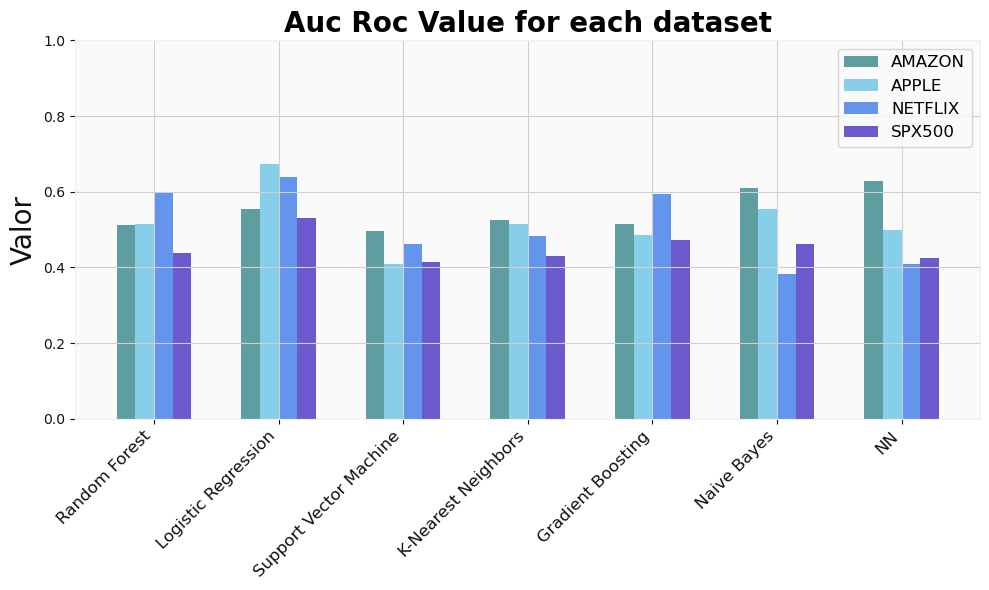

In [73]:
features = ['Open', 'Close', 'High', 'Low', 'NS', 'ND']
target = ['Next Candle UpBar']

predicted_values_with_NS_ND, curve_roc_ = run_forecast_classification(datasets, features, target, 'ns_nd')
plot_auc_roc(curve_roc_, 'ns_nd')

The accuracies didn't change after including the data. Let's have a look if the predictions on the marked candles are the expected: highger values after NS, and a drop on the price after a ND. First we're going to check the results without the candles information.

In [74]:
def check_accuracy(datasets, basic_results, results_NS, results_ND, results_NS_ND, candle_type):
    features = ['Open', 'Close', 'High', 'Low', 'NS', 'ND']
    target = ['Next Candle UpBar']
    
    for model in basic_results.keys():
        datasets_name = list()
        basic_accuracies = list()
        NS_accuracies = list()
        ND_accuracies = list()
        NS_ND_accuracies = list()  
        for dataset_name, dataset in datasets.items():
            X_train, y_train, X_test, y_test = dataset.split_data(features, target)
            
            test = X_test.copy()
            test['Next Candle UpBar'] = y_test
            test['Predictions Basic'] = basic_results[model][dataset_name]
            test['Predictions NS'] = results_NS[model][dataset_name]
            test['Predictions ND'] = results_ND[model][dataset_name]
            test['Predictions NS & ND'] = results_NS_ND[model][dataset_name]

            aux = test[test[candle_type] == 1][['Next Candle UpBar', 'Predictions Basic', 
                           'Predictions NS', 'Predictions ND', 'Predictions NS & ND']]

            basic_predictions = 0
            predictions_NS = 0
            predictions_ND = 0
            predictions_NS_ND = 0
            
            for i in range(len(aux)):
                correct_answer = aux.iloc[i]['Next Candle UpBar']

                if correct_answer == aux.iloc[i]['Predictions Basic']:
                    basic_predictions += 1

                if correct_answer == aux.iloc[i]['Predictions NS']:
                    predictions_NS += 1

                if correct_answer == aux.iloc[i]['Predictions ND']:
                    predictions_ND += 1

                if correct_answer == aux.iloc[i]['Predictions NS & ND']:
                    predictions_NS_ND += 1
                    
            
            basic_accuracy = basic_predictions / len(aux)
            NS_accuracy = predictions_NS / len(aux)
            ND_accuracy = predictions_ND / len(aux)
            NS_ND_accuracy = predictions_NS_ND / len(aux)

            datasets_name.append(dataset_name)
            basic_accuracies.append(basic_accuracy)
            NS_accuracies.append(NS_accuracy)
            ND_accuracies.append(ND_accuracy)
            NS_ND_accuracies.append(NS_ND_accuracy)
            
            
            # Configurar el gràfic de barres
        x = np.arange(len(datasets_name))  # el rang de posicions per les barres
        width = 0.2  # amplada de les barres

        fig, ax = plt.subplots(figsize=(12, 8))

        # Crear les barres
        bars1 = ax.bar(x - width * 1.5, basic_accuracies, width, label='Basic', color='cadetblue')
        bars2 = ax.bar(x - width * 0.5, NS_accuracies, width, label='NS', color='skyblue')
        bars3 = ax.bar(x + width * 0.5, ND_accuracies, width, label='ND', color='cornflowerblue')
        bars4 = ax.bar(x + width * 1.5, NS_ND_accuracies, width, label='NS & ND', color='slateblue')

        # Afegir etiquetes, títol i llegenda
        ax.set_ylabel('Accuracy', fontsize=20)
        ax.set_title(f'UpBar accuracy with {model} using {candle_type}',
                    fontsize=23, loc='center', fontdict=dict(weight='bold'))
        
        ax.set_xticks(x)
        ax.set_xticklabels(datasets_name, fontsize=15)
        ax.legend(fontsize='large')
        
        ax.set_ylim(0, 1)

        # Afegir les etiquetes de precisió a sobre de cada barra
        def add_labels(bars):
            for bar in bars:
                height = bar.get_height()
                ax.annotate(f'{height:.2f}',
                            xy=(bar.get_x() + bar.get_width() / 2, height),
                            xytext=(0, 3),  # 3 points vertical offset
                            textcoords="offset points",
                            ha='center', va='bottom', fontsize=14)

        add_labels(bars1)
        add_labels(bars2)
        add_labels(bars3)
        add_labels(bars4)

        fig.tight_layout()
        
            # Ensure the directory exists
        directory = 'Informe/Imatges/SegonEnfoc'
        if not os.path.exists(directory):
            os.makedirs(directory)

        # Build the filename
        filename = f"{model}_{candle_type}_Accuracy.png"
        filepath = os.path.join(directory, filename)

        # Save the plot as a PNG image
        plt.savefig(filepath, bbox_inches='tight')

        # Show the plot
        plt.show() 
            
            

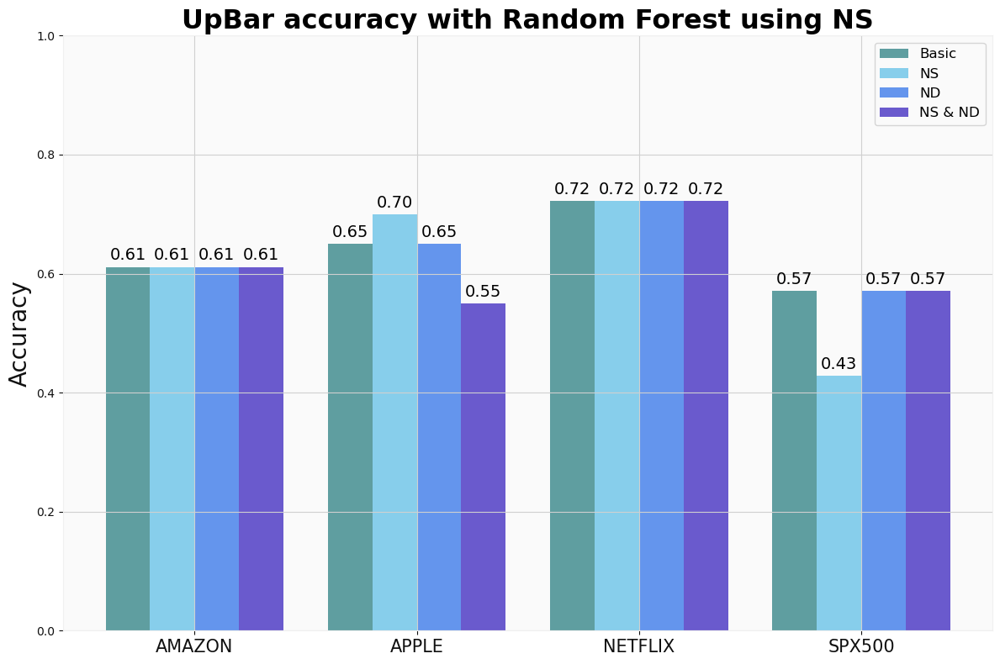

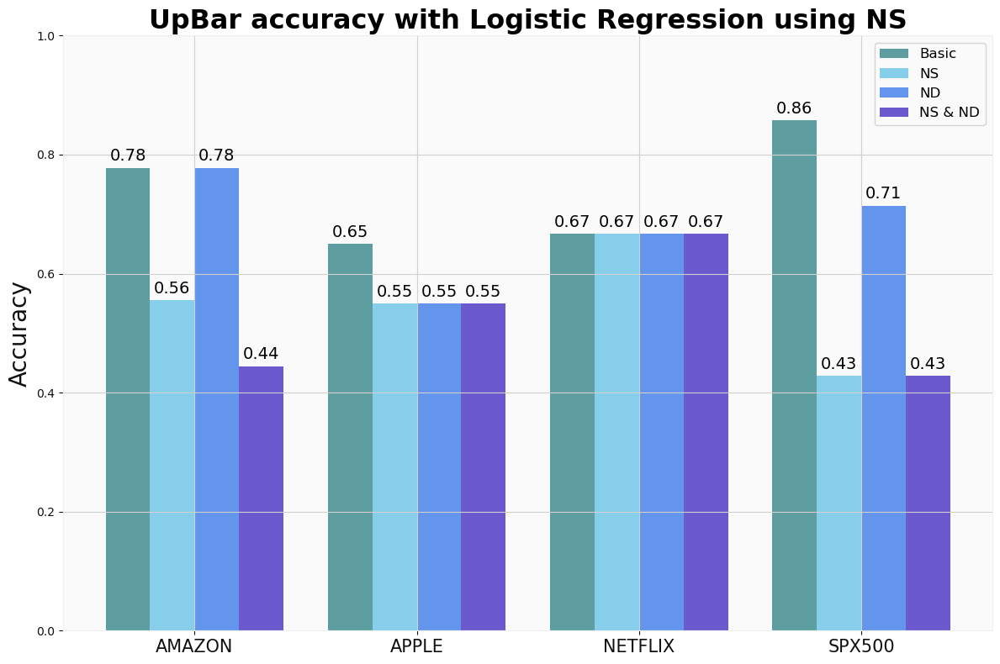

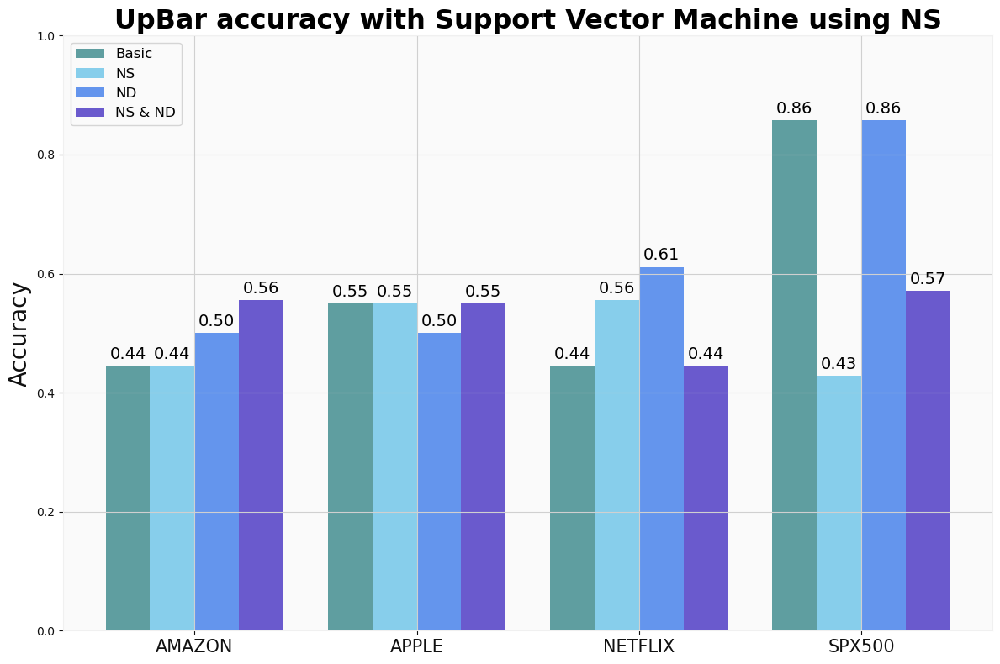

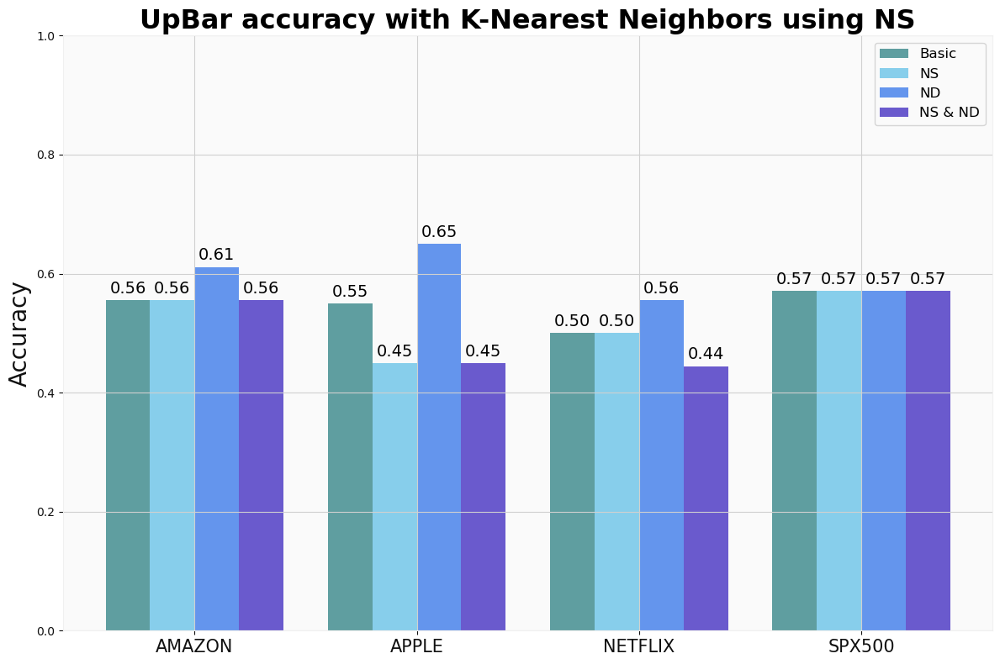

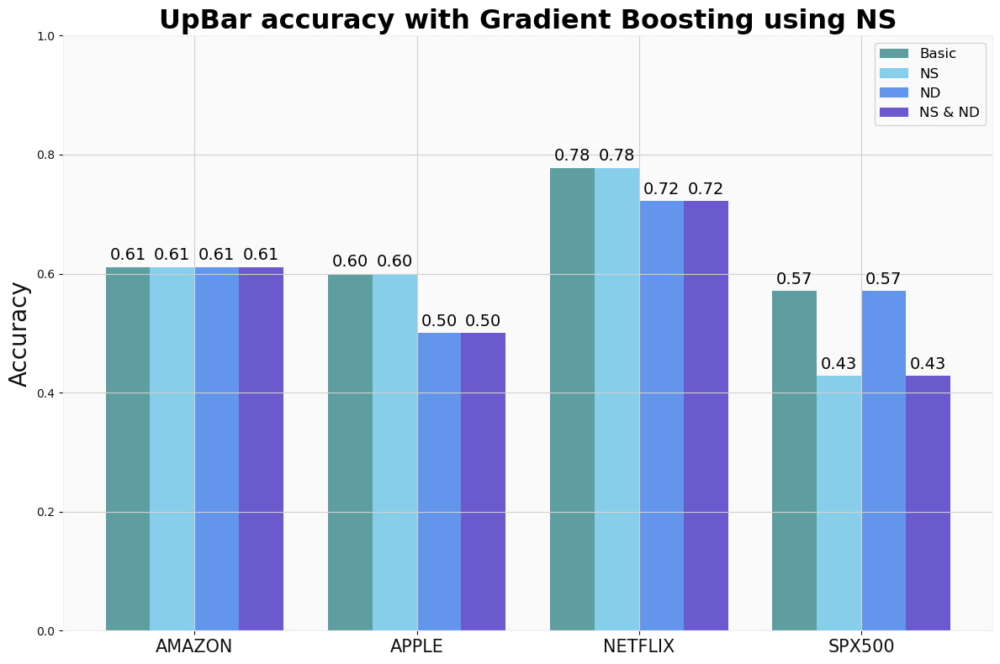

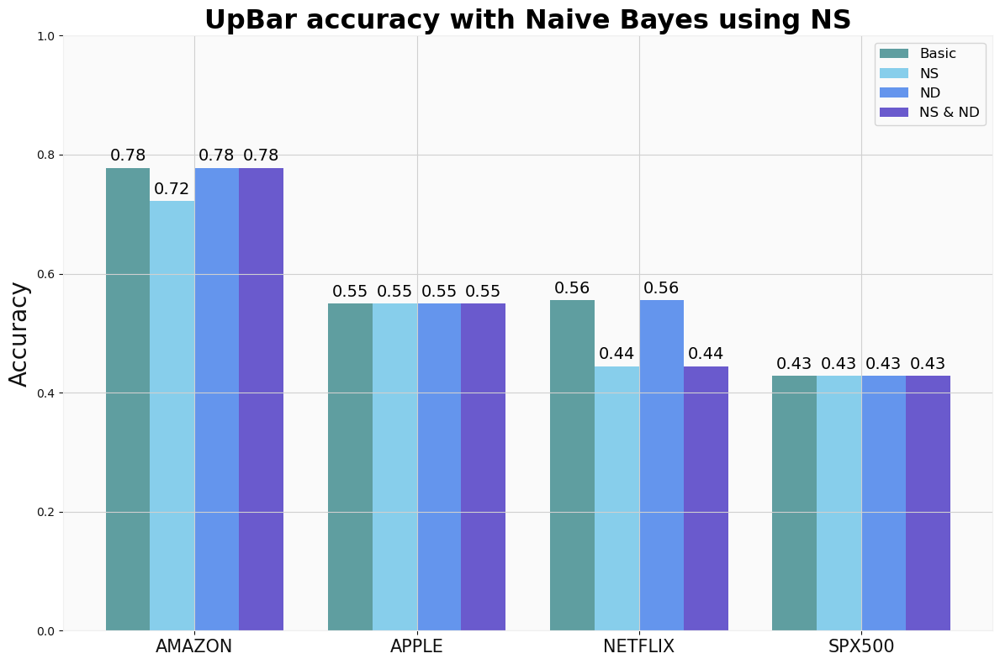

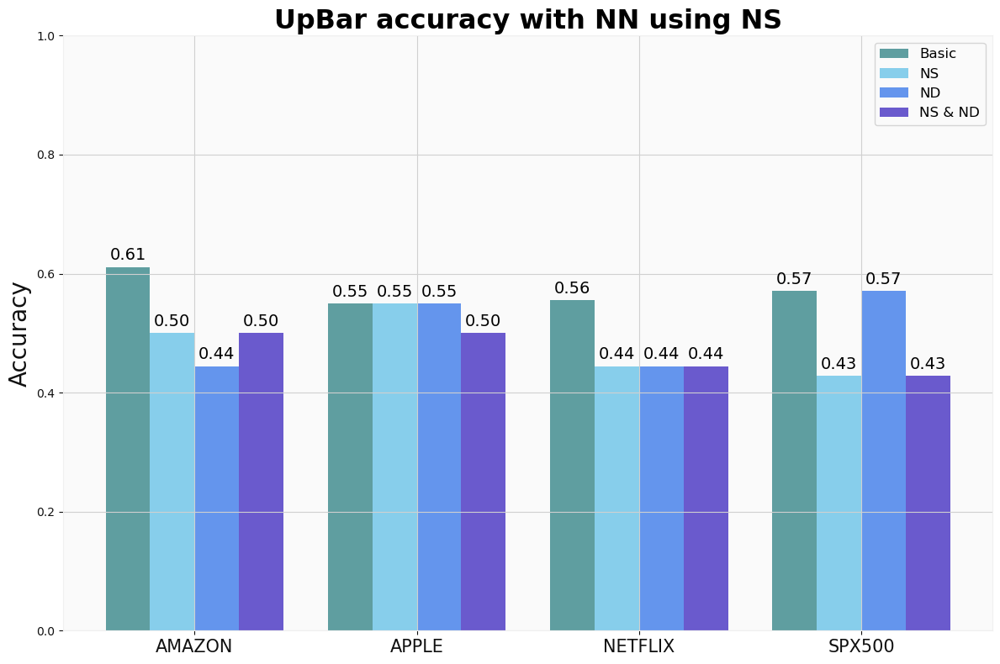

In [75]:
check_accuracy(datasets, predicted_values, predicted_values_with_NS,
                          predicted_values_with_ND, predicted_values_with_NS_ND, 'NS')

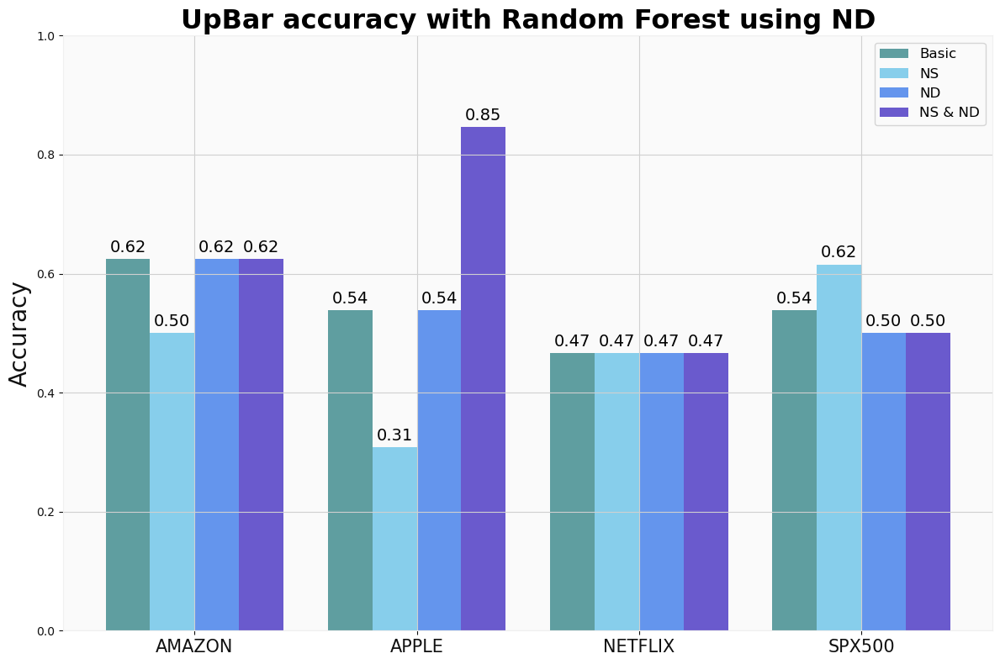

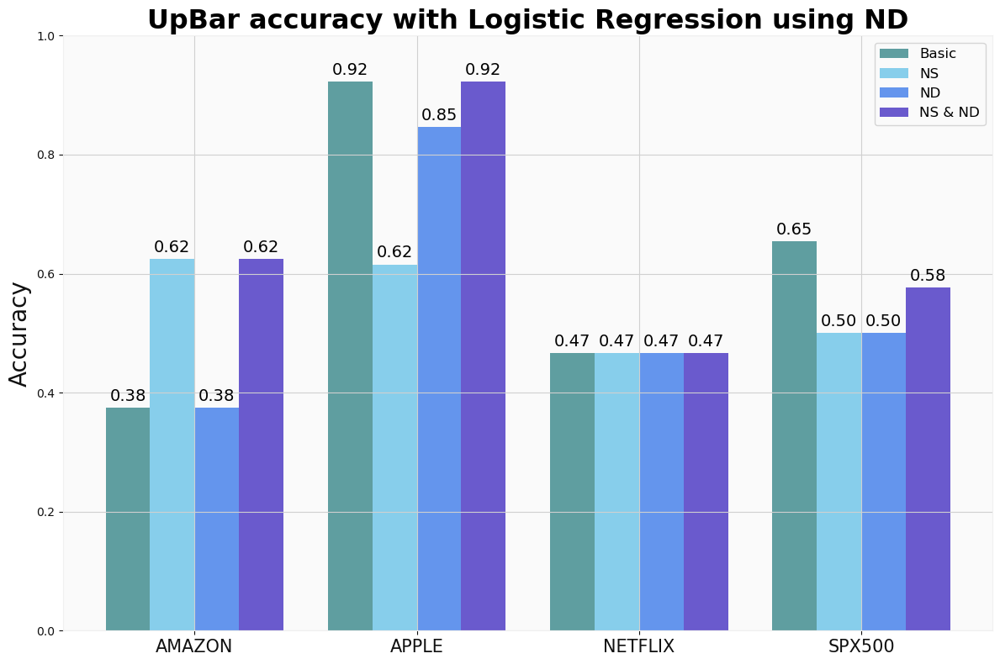

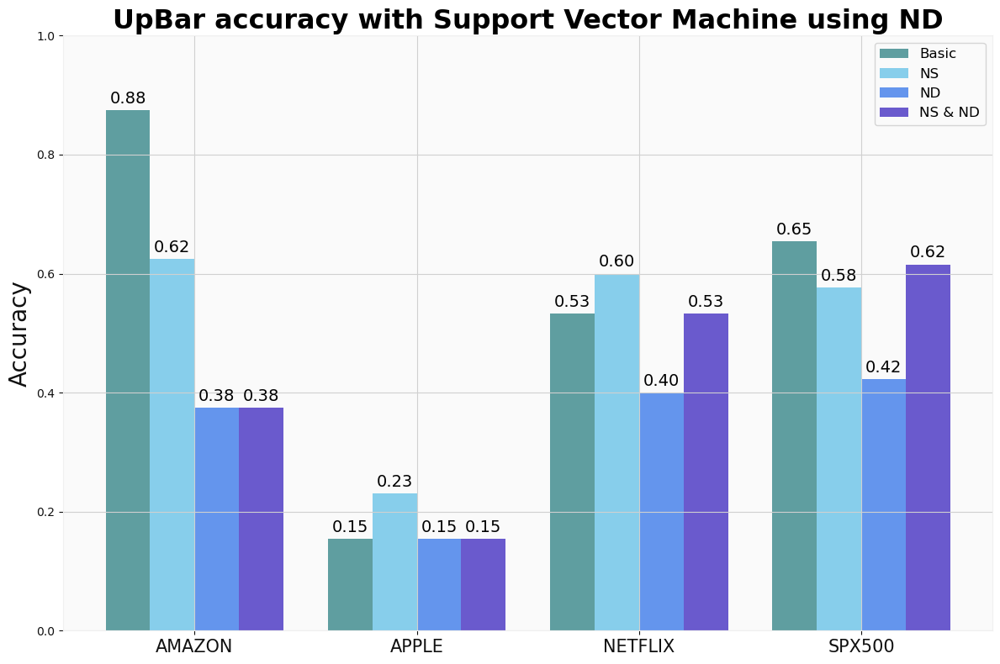

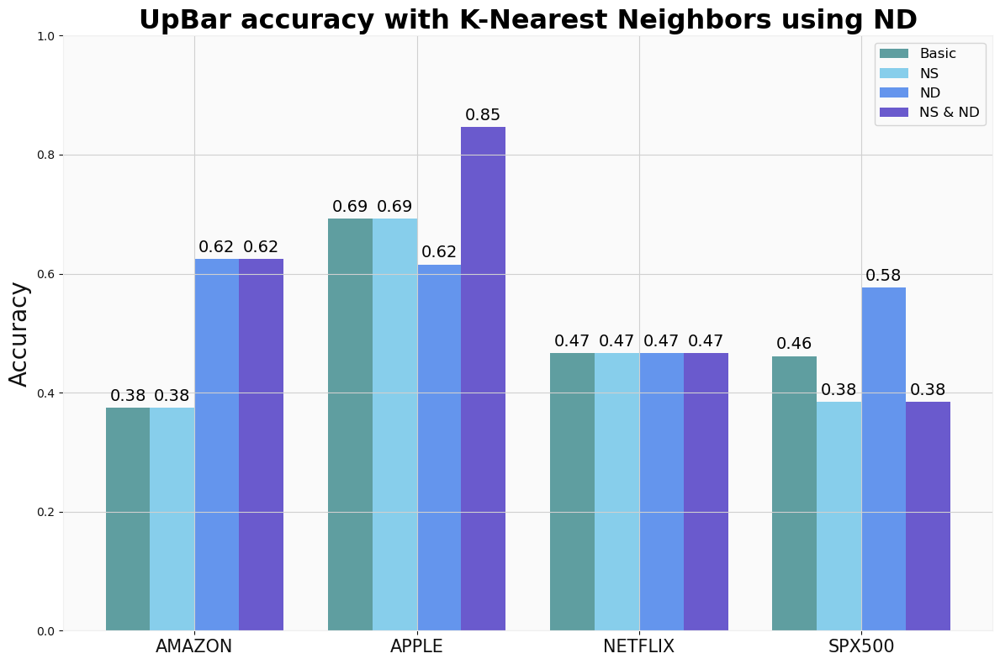

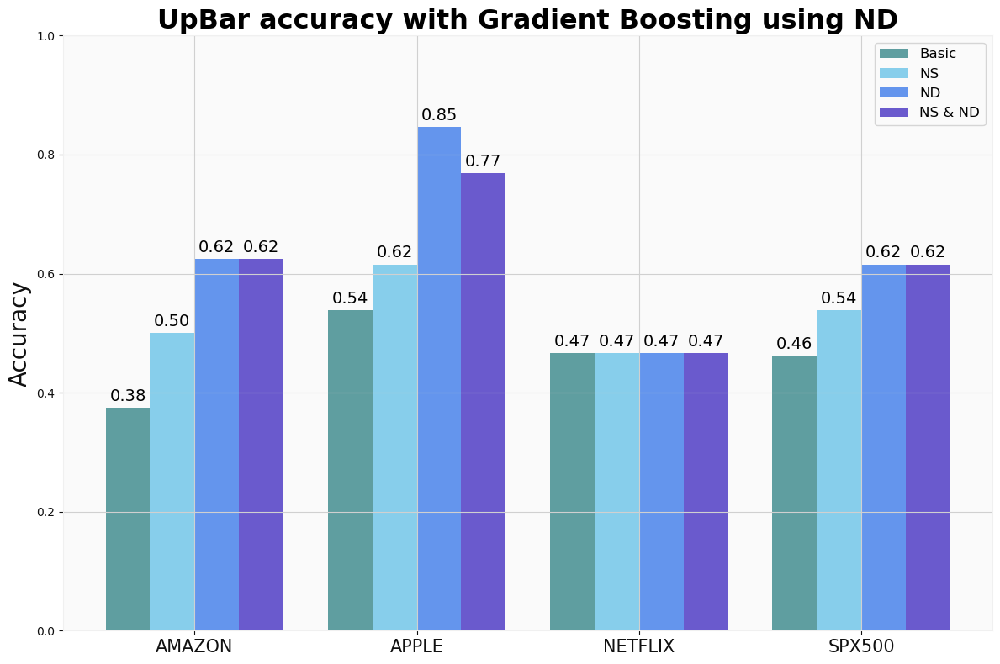

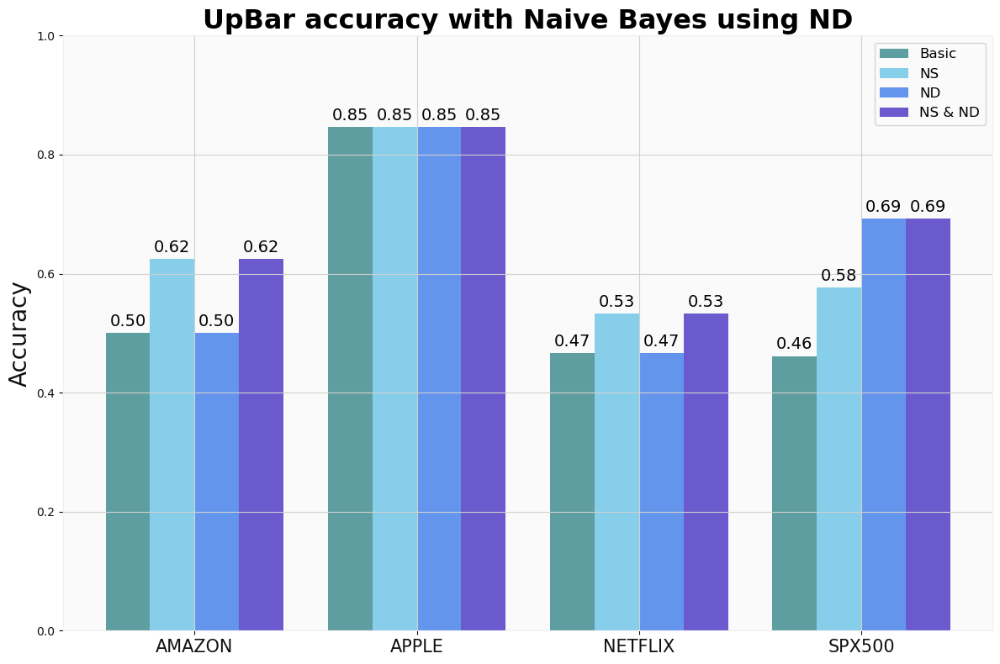

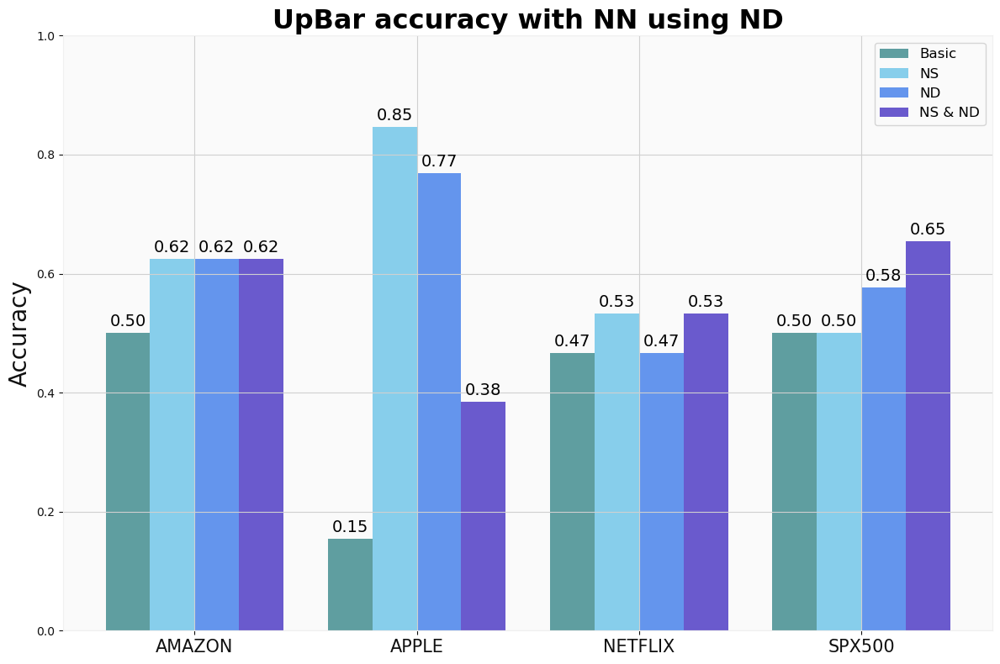

In [76]:
check_accuracy(datasets, predicted_values, predicted_values_with_NS,
                          predicted_values_with_ND, predicted_values_with_NS_ND, 'ND')

Those predictions look like random predictions to me. Not a single model makes an improvement after using NS and ND candles.